# Experiment 3
Endorsement Polices
1. All AND
2. All OR
3. OutOf(2, All) 
4. OutOf(3, All)

This for Varied transaction rates. Batch Time out 2s.
Experiment 1.1 One Trasaction per 5 second 

In [1]:
from time import sleep
def create_peer_invoke_command():
    base = "docker exec -it cli peer chaincode invoke -o orderer.organ.com:7050 --tls true --cafile /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/ordererOrganizations/organ.com/orderers/orderer.organ.com/msp/tlscacerts/tlsca.organ.com-cert.pem -C organ-channel -n organcc "
    return(base)

def add_peers(org='hl', peer_n=0):
    hl_p1_add = ' --peerAddresses peer1.histocompatibility.organ.com:7051 '
    hl_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/histocompatibility.organ.com/peers/peer1.histocompatibility.organ.com/tls/ca.crt '
    hl_p0_add = ' --peerAddresses peer0.histocompatibility.organ.com:7051 '
    hl_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/histocompatibility.organ.com/peers/peer0.histocompatibility.organ.com/tls/ca.crt '
    
    ho_p1_add = ' --peerAddresses peer1.hospital.organ.com:7051 '
    ho_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/peers/peer1.hospital.organ.com/tls/ca.crt  '
    ho_p0_add = ' --peerAddresses peer0.hospital.organ.com:7051 '
    ho_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/peers/peer0.hospital.organ.com/tls/ca.crt  '
    
    gp_p1_add = ' --peerAddresses peer1.gp.organ.com:7051 '
    gp_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/gp.organ.com/peers/peer1.gp.organ.com/tls/ca.crt  '
    gp_p0_add = ' --peerAddresses peer0.gp.organ.com:7051 '
    gp_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/gp.organ.com/peers/peer0.gp.organ.com/tls/ca.crt  '
    
    op_p1_add = ' --peerAddresses peer1.opo.organ.com:7051 '
    op_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/opo.organ.com/peers/peer1.opo.organ.com/tls/ca.crt  '
    op_p0_add = ' --peerAddresses peer0.opo.organ.com:7051 '
    op_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/opo.organ.com/peers/peer0.opo.organ.com/tls/ca.crt  '
    cmd = ""
    cmd += create_peer_invoke_command() + hl_p1_add + hl_p1_cert
    cmd += hl_p0_add + hl_p0_cert
    cmd += ho_p0_add + ho_p0_cert + ho_p1_add + ho_p1_cert
    cmd += gp_p0_add + gp_p0_cert + gp_p1_add + gp_p1_cert
    cmd += op_p0_add + op_p0_cert + op_p1_add + op_p1_cert
    return(cmd)

def add_organ(organ_id = '', organ_name='', organ_data=''):
    cmd = add_peers() + '-c '
    
    cmd += '\'{"Args":["initOrgan", "' + str(organ_id) + '", "' + str(organ_name) + '", ' + str(organ_data) + ']}\''
    return(cmd)

def read_organ(organ_id='421'):
    cmd = add_peers()
    cmd +=  '-c \'{\"Args\":[\"readOrgan",\"' + str(organ_id) + '\"]}\''
    return(cmd)

def add_candidate(candidate_id = '', organ_name='', info=''):
    cmd = add_peers() + '-c '
    cmd += '\'{"Args":["initCandidate", "' + candidate_id + '", "' + organ_name + '", ' + info + ']}\''
    return(cmd)

def read_candidate(candidate_id='421'):
    cmd = add_peers()
    cmd +=  '-c \'{\"Args\":[\"readCandidate",\"' + str(candidate_id) + '\"]}\''
    return(cmd)

def docker_cleanup():
    !{ "docker rm -f $(docker ps -aq)"}
    !{ "docker volume prune -f"}
    !{ "docker network prune -f"}
    docker_images = "docker images --format '{{.Repository}}'"
    images = !{docker_images}
    dev_images=[]
    for image in images:
        if(image.find('dev-', 0, 6)>=0):
            dev_images.append(image)
    docker_rmi = "docker rmi -f "+" ".join(dev_images)
    print(docker_rmi)
    !{docker_rmi}

In [2]:
docker_cleanup()

"docker rm" requires at least 1 argument.
See 'docker rm --help'.

Usage:  docker rm [OPTIONS] CONTAINER [CONTAINER...]

Remove one or more containers
Total reclaimed space: 0B
docker rmi -f 
"docker rmi" requires at least 1 argument.
See 'docker rmi --help'.

Usage:  docker rmi [OPTIONS] IMAGE [IMAGE...]

Remove one or more images


In [3]:
with open(r"/home/thesis/Downloads/data_1.json", 'r') as file:
    data_1 = file.read()
with open(r"/home/thesis/Downloads/data_2.json", 'r') as file:
    data_2 = file.read()
with open(r"/home/thesis/Downloads/data_3.json", 'r') as file:
    data_3 = file.read()
with open(r"/home/thesis/Downloads/data_4.json", 'r') as file:
    data_4 = file.read()
import json
data = []
data.append(json.dumps(data_1))
data.append(json.dumps(data_2))
data.append(json.dumps(data_3))
data.append(json.dumps(data_4))

Issueing Transactions every 5 seconds

In [15]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(5)

2019-04-22 16:40:01.199 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:40:01.200 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:40:01.200 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:40:01.200 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:40:01.200 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:40:01.200 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:40:01.200 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:40:01.200 UTC [vipe

2019-04-22 16:40:01.223 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:40:01.223 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:40:01.223 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:40:01.223 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 16:40:01.223 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0003cc480, CONNECTING
2019-04-22 16:40:01.235 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003cc480, READY
2019-04-22 16:40:01.235 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:40:01.235 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:40:01.235 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 16:40:01.313 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000333eb0, READY
2019-04-22 16:40:01.314 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:40:01.314 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 16:40:01.314 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:40:01.314 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 16:40:01.315 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0003be000, CONNECTING
2019-04-22 16:40:01.329 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003be000, READY
2019-04-22 16:40:01.330 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 16:40:01.330 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 16:40:06.866 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:40:06.866 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:40:06.866 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:40:06.866 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:40:06.866 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000268700, CONNECTING
2019-04-22 16:40:06.876 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000268700, READY
2019-04-22 16:40:06.877 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:40:06.877 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:40:06.878 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 16:40:06.923 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0004e1cd0, READY
2019-04-22 16:40:06.924 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 16:40:06.924 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 16:40:06.924 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:40:06.924 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 16:40:06.924 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a0950, CONNECTING
2019-04-22 16:40:06.931 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a0950, READY
2019-04-22 16:40:06.933 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:40:06.933 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 16:40:12.510 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0000aeff0, READY
2019-04-22 16:40:12.512 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:40:12.512 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 16:40:12.512 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:40:12.512 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 16:40:12.512 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000269e30, CONNECTING
2019-04-22 16:40:12.516 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000269e30, READY
2019-04-22 16:40:12.518 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:40:12.518 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 16:43:02.841 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08ECDCF7E50510...8394F9F7BEEBFEEB81D46265461D05E6 
2019-04-22 16:43:02.841 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EFD7B784A136BCC18929E6B4D6978377BB163DDDD4F891FAC6EDEB8D3BC20F22 
2019-04-22 16:43:02.845 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \t\221\341\355\325\335k\317 \337\2213\026\330\254\016\314t\222$\367\026K\334\014\235{R\"\031Vo\022\373\205\001\n\324\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\267\205\001\n\007organcc\022\252\205\001\n\006\n\0048002\022\005\n\001\001\030\001\032\227\205\001\n\0048002\032\215\205\001{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufvi

2019-04-22 16:43:08.340 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:08.341 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:08.341 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:08.341 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:08.341 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:43:08.341 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:43:08.341 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:43:08.341 UTC [vipe

2019-04-22 16:43:08.378 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003d2130, READY
2019-04-22 16:43:08.379 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:43:08.380 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:08.385 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:43:08.385 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:08.386 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000406370, CONNECTING
2019-04-22 16:43:08.389 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000406370, READY
2019-04-22 16:43:08.391 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:43:08.392 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 16:43:08.809 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C089CDEF7E50510...3DB7C7BCE5C46DC6E408A5886B735294 
2019-04-22 16:43:08.809 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6594EB0D970C1210B6A6F1176C8EE69CD97074CA16C9FDA2DEF6AF325642DEF4 
2019-04-22 16:43:08.812 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \361\352\376\313\273\300\250\035\204\204\252\232\256\341 \373\201I\014;X\222\375[\272!\237\307\321\315\225\211\022\210\206\001\n\341\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\304\205\001\n\007organcc\022\267\205\001\n\006\n\0048003\022\023\n\001\001\030\001\"\014\n\n\n\0048002\022\002\010\006\032\226\205\001\n\0048003\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostx

2019-04-22 16:43:14.312 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:14.313 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:14.313 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:14.313 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:14.313 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:14.313 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:43:14.313 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:14.313 UTC [viperutil] getKeysRec

2019-04-22 16:43:14.360 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0008c3810, READY
2019-04-22 16:43:14.363 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:43:14.364 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:14.364 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:43:14.364 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:14.365 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d02c0, CONNECTING
2019-04-22 16:43:14.376 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d02c0, READY
2019-04-22 16:43:14.377 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:43:14.377 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 16:43:14.643 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A2DEF7E50510...438D8B59A3CFAEF14984785D75088E50 
2019-04-22 16:43:14.643 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8943E3836D2A7BF7E535A245104A0260E916FECB0CB01AE0CE8CCF3792111039 
2019-04-22 16:43:14.645 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n Wh\221/H\252x\003\217\2760\371\306\002\342\3159\006\323\310Y\305\344\207\327\344\2179\317\223\253\235\022\230\206\001\n\361\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\324\205\001\n\007organcc\022\307\205\001\n\006\n\0048004\022\037\n\001\001\030\001\"\030\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\032\232\205\001\n\0048004\032\220\205\001{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \

2019-04-22 16:43:20.162 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:20.163 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:20.163 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:20.163 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:20.164 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:20.164 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:43:20.164 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:43:20.164 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 16:43:20.202 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:43:20.202 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:20.202 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:43:20.202 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:20.202 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a0980, CONNECTING
2019-04-22 16:43:20.208 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a0980, READY
2019-04-22 16:43:20.209 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:43:20.209 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:43:20.209 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 16:43:20.260 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:43:20.260 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:20.260 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:43:20.261 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:20.261 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0002674f0, CONNECTING
2019-04-22 16:43:20.264 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0002674f0, READY
2019-04-22 16:43:20.266 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:43:20.266 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 16:43:20.266 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresse

2019-04-22 16:43:26.053 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:26.054 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:26.054 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:26.054 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:26.054 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:26.054 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:43:26.055 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:26.055 UTC [viperutil] getKeysRec

2019-04-22 16:43:26.064 UTC [msp.identity] newIdentity -> DEBU 032 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMDCCAdegAwIBAgIRAJtmreKeydSN8Opcj46olQ8wCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE2MzQwMFoXDTI5MDQxOTE2
MzQwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
bSQJYRHgp2G1SiR0fqVpKxOJm4LUzUBHCsj9mKlg8/EWorCE38tlKe2uTsZO6vFL
1VXlVXnk+9gXKpB8wHSzPKNNMEswDgYDVR0PAQH/BAQDAgeAMAwGA1UdEwEB/wQC
MAAwKwYDVR0jBCQwIoAgP0UiKoKWHTjbrJcMmE5OKnWhAcdJ3dH0l3lR3XfCKtMw
CgYIKoZIzj0EAwIDRwAwRAIgAI0hNqebfijmubo+nnNhZEw7dQVn4sgmrX4520Ui
gy4CIBMn5aiuDNlLmBx9+W3PB3ExzmG8Q3is0YYy4OfSEQI3
-----END CERTIFICATE-----
2019-04-22 16:43:26.065 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading priva

2019-04-22 16:43:26.118 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 16:43:26.118 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:26.118 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:43:26.118 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:26.118 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce480, CONNECTING
2019-04-22 16:43:26.120 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce480, READY
2019-04-22 16:43:26.121 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:43:26.121 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:26.121 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresse

2019-04-22 16:43:31.952 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:31.953 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:31.953 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:31.953 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:31.954 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:31.954 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:43:31.954 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:31.954 UTC [viperutil] getKeysRec

2019-04-22 16:43:32.001 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000448d20, CONNECTING
2019-04-22 16:43:32.005 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000448d20, READY
2019-04-22 16:43:32.006 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:43:32.006 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:32.006 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:43:32.006 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:32.006 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002747b0, CONNECTING
2019-04-22 16:43:32.010 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002747b0, READY

2019-04-22 16:43:32.463 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08B4DEF7E50510...EC628A3A5CB6E534D1D047E24D13A496 
2019-04-22 16:43:32.463 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: BA85142DB8A52B2EBA0459841B0671066BA3D558B612DEA772D49D3B2393716B 
2019-04-22 16:43:32.467 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \024M\271\331\221\342\323\3438\212\027\220y\2624\010E\202\224\033\327\3610\322\207\341\220-f\257\224\300\022\270\206\001\n\221\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\364\205\001\n\007organcc\022\347\205\001\n\006\n\0048007\022C\n\001\001\030\001\"<\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\010\n\n\n\0048005\022\002\010\t\n\n\n\0048006\022\002\010\n\032\226\205\001\n\0048007\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8007\"

2019-04-22 16:43:38.035 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:38.035 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:38.035 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:38.035 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:43:38.036 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:43:38.036 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:43:38.036 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:43:38.036 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 16:43:38.076 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003720b0, READY
2019-04-22 16:43:38.077 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:43:38.077 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:38.077 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:43:38.077 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:38.077 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003be670, CONNECTING
2019-04-22 16:43:38.088 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003be670, READY
2019-04-22 16:43:38.089 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:43:38.089 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:43:38.518 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08BADEF7E50510...93ABF9798CC6C5A785A5D099B2EAB3FF 
2019-04-22 16:43:38.518 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3BEA732AACDFE47BA93756C52B54FD4D8124BDB0122AE0F50FE903F81F373149 
2019-04-22 16:43:38.522 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n  \323/I\251\301\271\004\230\236w\215\023\021Rw;\235A\247}\313Rh\202l{o\r\310x\367\022\310\206\001\n\241\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\204\206\001\n\007organcc\022\367\205\001\n\006\n\0048008\022O\n\001\001\030\001\"H\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\010\n\n\n\0048005\022\002\010\t\n\n\n\0048006\022\002\010\n\n\n\n\0048007\022\002\010\013\032\232\205\001\n\0048008\032\220\205\001{\"docType\":\"candidate\",\"candidateID\":\

2019-04-22 16:43:44.196 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:44.196 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:44.197 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:44.197 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:44.197 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:44.197 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:43:44.197 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:44.197 UTC [viperutil] getKeysRec

2019-04-22 16:43:44.219 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000277ff0, CONNECTING
2019-04-22 16:43:44.224 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000277ff0, READY
2019-04-22 16:43:44.226 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:43:44.227 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:43:44.227 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:43:44.228 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:44.228 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e3ad0, CONNECTING
2019-04-22 16:43:44.232 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e3

2019-04-22 16:43:44.408 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00026c1a0, READY
2019-04-22 16:43:44.411 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:43:44.412 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 16:43:44.412 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:44.412 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 16:43:44.412 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 16:43:44.413 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0002995d0, CONNECTING
2019-04-22 16:43:44.418 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002995d0, READY
2019-04-22 16:43:44.423 UTC [msp.identity

2019-04-22 16:43:50.276 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:50.276 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:43:50.277 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 16:43:50.277 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:43:50.277 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 16:43:50.278 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:43:50.278 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 16:43:50.279 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-22 16:43:50.307 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:43:50.307 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:50.308 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:43:50.308 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:50.308 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ab290, CONNECTING
2019-04-22 16:43:50.313 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ab290, READY
2019-04-22 16:43:50.316 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:43:50.317 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:50.317 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 16:43:50.367 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000339470, READY
2019-04-22 16:43:50.368 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:43:50.368 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 16:43:50.368 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:50.368 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 16:43:50.368 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 16:43:50.369 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc00041ab50, CONNECTING
2019-04-22 16:43:50.372 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00041ab50, READY
2019-04-22 16:43:50.378 UTC [msp.identity

2019-04-22 16:43:56.149 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:43:56.149 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:56.149 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:43:56.149 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:43:56.149 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:43:56.149 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:43:56.149 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:43:56.150 UTC [viperutil] getKeysRec

2019-04-22 16:43:56.180 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003f84b0, READY
2019-04-22 16:43:56.181 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:43:56.181 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:43:56.181 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:43:56.181 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:43:56.181 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0004d0c70, CONNECTING
2019-04-22 16:43:56.186 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0004d0c70, READY
2019-04-22 16:43:56.188 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:43:56.188 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:43:56.311 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000130920, READY
2019-04-22 16:43:56.335 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08CCDEF7E50510...5F4341445F444F4E223A20226153227D 
2019-04-22 16:43:56.357 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: FB2581766A78E12E3061AD4A2B0D863E0B2ABB090BFFC15935F7B3E2061229B6 
2019-04-22 16:43:56.695 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08CCDEF7E50510...B67D4F1BC8575DF8FF804DBED4BBBC8B 
2019-04-22 16:43:56.695 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 24668075E76A6246291EF2FD5009F9BE52416D56C9AB4E0BD6125F11EFD79DB2 
2019-04-22 16:43:56.700 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \330\276\001\036uiX\3079\346\204,\370\010t\320mj\"\373\243\365\207\240\364\031\246\261\251\300\2

2019-04-22 16:43:56.703 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" 
2019-04-22 16:44:02.228 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:02.228 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:02.228 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:44:02.228 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:02.228 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:44:02.228 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2

2019-04-22 16:44:02.259 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00035d5e0, READY
2019-04-22 16:44:02.260 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:44:02.260 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:44:02.260 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:44:02.260 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 16:44:02.260 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00045b500, CONNECTING
2019-04-22 16:44:02.273 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00045b500, READY
2019-04-22 16:44:02.274 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:44:02.274 UTC [grpc] DialContext -> DEBU

2019-04-22 16:44:02.376 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00028fd90, READY
2019-04-22 16:44:02.383 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08D2DEF7E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 16:44:02.383 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 6C6F074059CC486BFE9EA1F1C0F4EB411FB1D14AAB6848C1FFA9315436281F76 
2019-04-22 16:44:02.708 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D2DEF7E50510...918628E79C57AF870BEEBEBE92322843 
2019-04-22 16:44:02.708 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C788CC24CF477766F7F0138BB5A27BAB9A0D8F3B89DC45894CB80CA33759CEF0 
2019-04-22 16:44:02.712 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \0148\\\251\355\316\304K}X\272\223{\"t\007\204\003\317\315~3Ziq\237\316\314=\233X\362\022\370\20

2019-04-22 16:44:08.264 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:08.265 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:08.265 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:44:08.265 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:08.265 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:44:08.265 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:44:08.265 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:44:08.266 UTC [vipe

2019-04-22 16:44:08.305 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:44:08.305 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:44:08.305 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:44:08.305 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 16:44:08.305 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000329250, CONNECTING
2019-04-22 16:44:08.340 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000329250, READY
2019-04-22 16:44:08.350 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:44:08.350 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:08.350 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 16:44:08.719 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D8DEF7E50510...075386EED595C69F6862B05ACC10C009 
2019-04-22 16:44:08.719 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: FF6B3F83E402E58F44A8BF268ADAF608EB8AE5E1F566F0425D3DAC4923946E10 
2019-04-22 16:44:08.724 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n jd\306\017?\213&\036`\017\330b\275\272\320+>8\241\363\336 \217\327a\231\326u\363S\346\375\022\212\207\001\n\343\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\306\206\001\n\007organcc\022\271\206\001\n\006\n\0048013\022\214\001\n\001\001\030\001\"\204\001\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\010\n\n\n\0048005\022\002\010\t\n\n\n\0048006\022\002\010\n\n\n\n\0048007\022\002\010\013\n\n\n\0048008\022\002\010\014\n\n\n\0048009\022\002\010\r\n\n\n

2019-04-22 16:44:14.262 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:14.262 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:14.262 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:44:14.262 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:14.263 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:14.263 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:44:14.263 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:44:14.263 UTC [viperutil] getKeysRec

2019-04-22 16:44:14.318 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a5b60, READY
2019-04-22 16:44:14.319 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:44:14.319 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:44:14.319 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:44:14.320 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 16:44:14.320 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0004e5cf0, CONNECTING
2019-04-22 16:44:14.324 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004e5cf0, READY
2019-04-22 16:44:14.325 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:44:14.325 UTC [grpc] DialContext -> DEBU

2019-04-22 16:44:14.635 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08DEDEF7E50510...2DD3DB1448A9C53FEF17CF3E5995AC60 
2019-04-22 16:44:14.635 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 65A1BB4B77B396B75ED815B50F23B2BF03F3D9A5C996370F7AFD4AE34542F4BF 
2019-04-22 16:44:14.638 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n `0\255Ju\326\035\250\347Z\371lH\246\014\340\0359\321\373\333D\014\002\3602,9%\244%\207\022\217\207\001\n\350\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\313\206\001\n\007organcc\022\276\206\001\n\006\n\0048014\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\010\n\n\n\0048005\022\002\010\t\n\n\n\0048006\022\002\010\n\n\n\n\0048007\022\002\010\013\n\n\n\0048008\022\002\010\014\n\n\n\0048009\022\002\010\r\n\n\n\00

2019-04-22 16:44:20.167 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:20.167 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:20.167 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:44:20.167 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:20.167 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:44:20.167 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:44:20.168 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:44:20.168 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 16:44:20.205 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:44:20.205 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 16:44:20.205 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:44:20.205 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 16:44:20.205 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000539610, CONNECTING
2019-04-22 16:44:20.216 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000539610, READY
2019-04-22 16:44:20.224 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:44:20.224 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:20.224 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-22 16:44:20.707 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E4DEF7E50510...96449A6DB55DB14390151F7E4A5DBECC 
2019-04-22 16:44:20.707 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4F142170EF0943F4C2AFF5B04C884EB8D47310A17D6DFD6688B27F5D50EA150C 
2019-04-22 16:44:20.711 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n Mf\214\274\001P>D:/\021\241(\235-\321\001\2570I\334\0015YP|\0250\354\244>\257\022\311\214\002\n\245\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\210\214\002\n\007organcc\022\373\213\002\n\006\n\0044000\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\010\022\244\001\n\001\001\030\001\"\234\001\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\010\n\n\n\0048005\022\002\010\t\n\n\n\0048006\022\002\010\n\n\n\n\0048007\022\002\010\01

2019-04-22 16:44:26.233 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:26.233 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:26.233 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:26.233 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:44:26.234 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:44:26.234 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:44:26.234 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:44:26.234 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:44:26.256 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:44:26.257 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:26.257 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:44:26.257 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 16:44:26.257 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000163c70, CONNECTING
2019-04-22 16:44:26.273 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000163c70, READY
2019-04-22 16:44:26.274 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:44:26.274 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:44:26.274 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 16:44:26.385 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00032d110, READY
2019-04-22 16:44:26.392 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08EADEF7E50510...5F4341445F444F4E223A20224346227D 
2019-04-22 16:44:26.392 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 0CAAA3A23BD7DFCC9723132659C6A05488350BD3011D523B88E69848D2A94CC8 
2019-04-22 16:44:26.856 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EADEF7E50510...7FE0D2C349C49632728881D8202AF88C 
2019-04-22 16:44:26.856 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 37EB1E2BCC4FADB084228A7D2BF611A44AC66A77D27D009C78D42B896C3A4F3A 
2019-04-22 16:44:26.859 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n l\311\377T\357S\003\244+\034%>\256\017\303\230\331\217\306\356\241\356\006\264\201a`\314\342@\335\346\022\335

2019-04-22 16:44:32.460 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:32.461 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:32.461 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:44:32.461 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:32.461 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:32.461 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:44:32.461 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:44:32.461 UTC [viperutil] getKeysRec

2019-04-22 16:44:32.524 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000314360, READY
2019-04-22 16:44:32.525 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:44:32.525 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:32.525 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:44:32.525 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:44:32.525 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00027e460, CONNECTING
2019-04-22 16:44:32.530 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00027e460, READY
2019-04-22 16:44:32.531 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:44:32.531 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:44:33.021 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F0DEF7E50510...C9BE30BDA7273ECCC165BF6D9A57BF73 
2019-04-22 16:44:33.021 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 1EE6A1DEC2645CDCD1BB675C23FDF0BD89F1C1CAAA3105E7B59A37E4BFD29853 
2019-04-22 16:44:33.026 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n ':\354\215\251\215\305\266\257\277\020\347\246\341\242oGh\374\217\235\270RN\270\266\252\263)\344\231\r\022\303\214\002\n\237\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\202\214\002\n\007organcc\022\365\213\002\n\006\n\0044002\n\n\n\0048002\022\002\010\006\022\274\001\n\001\001\030\001\"\264\001\n\n\n\0044000\022\002\010\023\n\n\n\0044001\022\002\010\024\n\n\n\0048002\022\002\010\006\n\n\n\0048003\022\002\010\007\n\n\n\0048004\022\002\010\023\n\n\n\0048005\022\002\010\024\n\n\n\0048006\022\002\010\n\n

2019-04-22 16:44:38.672 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:38.672 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:44:38.673 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 16:44:38.673 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:44:38.673 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 16:44:38.673 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:44:38.673 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 16:44:38.674 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-22 16:44:38.724 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:44:38.724 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 16:44:38.724 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00015ff90, CONNECTING
2019-04-22 16:44:38.736 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00015ff90, READY
2019-04-22 16:44:38.737 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 16:44:38.737 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:38.737 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:44:38.737 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 16:44:38.737 UTC [grpc] H

2019-04-22 16:44:44.673 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:44.673 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:44.673 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:44:44.674 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:44.674 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:44.674 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:44:44.674 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:44:44.674 UTC [viperutil] getKeysRec

2019-04-22 16:44:44.691 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:44:44.692 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:44:44.692 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:44:44.692 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:44:44.692 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00001fb20, CONNECTING
2019-04-22 16:44:44.694 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00001fb20, READY
2019-04-22 16:44:44.695 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:44:44.695 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:44.695 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 16:44:44.746 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:44:44.746 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 16:44:44.746 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:44:44.746 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 16:44:44.746 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000077880, CONNECTING
2019-04-22 16:44:44.749 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000077880, READY
2019-04-22 16:44:44.750 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 16:44:44.750 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:44.750 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 16:44:50.762 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:50.762 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:44:50.763 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:44:50.763 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:44:50.763 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:44:50.763 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:44:50.763 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:44:50.763 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:44:50.785 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000015ef0, READY
2019-04-22 16:44:50.785 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:44:50.785 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:44:50.785 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:44:50.785 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 16:44:50.785 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00045ac50, CONNECTING
2019-04-22 16:44:50.787 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00045ac50, READY
2019-04-22 16:44:50.788 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:44:50.788 UTC [grpc] DialContext -> DEBU

2019-04-22 16:44:50.839 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:44:50.839 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 16:44:50.839 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:44:50.841 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 16:44:50.842 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000076e30, CONNECTING
2019-04-22 16:44:50.848 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000076e30, READY
2019-04-22 16:44:50.849 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 16:44:50.849 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:50.849 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 16:44:56.932 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:44:56.932 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:44:56.933 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:44:56.933 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 16:44:56.935 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:44:56.937 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 16:44:56.937 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 16:44:56.937 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 16:44:57.005 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003caf90, READY
2019-04-22 16:44:57.006 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:44:57.006 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:44:57.007 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:44:57.007 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 16:44:57.007 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c2c70, CONNECTING
2019-04-22 16:44:57.011 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c2c70, READY
2019-04-22 16:44:57.012 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:44:57.012 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 16:44:57.556 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B0889DFF7E50510...80FC4C3197467F4316478737C6798D4D 
2019-04-22 16:44:57.556 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 76FB73791A4439692402FE4A06E9FC18191ABE0A399B436199C57E3E34CAA723 
2019-04-22 16:44:57.561 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \305E\335\317\227\356\013\233\302\325m1o\217M\242\364\240\231\007\225?\371Y!)\326\366;\302\374\t\022\363\214\002\n\317\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\262\214\002\n\007organcc\022\245\214\002\n\006\n\0044006\n\n\n\0048006\022\002\010\n\022\354\001\n\001\001\030\001\"\344\001\n\n\n\0044000\022\002\010\023\n\n\n\0044001\022\002\010\024\n\n\n\0044002\022\002\010\025\n\n\n\0044003\022\002\010\026\n\n\n\0044004\022\002\010\027\n\n\n\0044005\022\002\010\030\n\n\n\0048002\022\002\010\025\n\n\n\0

2019-04-22 16:45:03.270 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:03.272 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:03.272 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:03.272 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:03.273 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:03.273 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:45:03.273 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:45:03.273 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:45:03.285 UTC [msp.identity] newIdentity -> DEBU 031 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMDCCAdegAwIBAgIRAJtmreKeydSN8Opcj46olQ8wCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE2MzQwMFoXDTI5MDQxOTE2
MzQwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
bSQJYRHgp2G1SiR0fqVpKxOJm4LUzUBHCsj9mKlg8/EWorCE38tlKe2uTsZO6vFL
1VXlVXnk+9gXKpB8wHSzPKNNMEswDgYDVR0PAQH/BAQDAgeAMAwGA1UdEwEB/wQC
MAAwKwYDVR0jBCQwIoAgP0UiKoKWHTjbrJcMmE5OKnWhAcdJ3dH0l3lR3XfCKtMw
CgYIKoZIzj0EAwIDRwAwRAIgAI0hNqebfijmubo+nnNhZEw7dQVn4sgmrX4520Ui
gy4CIBMn5aiuDNlLmBx9+W3PB3ExzmG8Q3is0YYy4OfSEQI3
-----END CERTIFICATE-----
2019-04-22 16:45:03.286 UTC [msp.identity] newIdentity -> DEBU 032 Creating ide

2019-04-22 16:45:03.345 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003dc000, CONNECTING
2019-04-22 16:45:03.371 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003dc000, READY
2019-04-22 16:45:03.375 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 16:45:03.375 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 16:45:03.376 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:45:03.377 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:03.378 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003acca0, CONNECTING
2019-04-22 16:45:03.381 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003acca0, READY
2019-

2019-04-22 16:45:09.694 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:09.694 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:09.694 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:45:09.694 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:09.695 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:09.695 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:09.695 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:09.695 UTC [viperutil] getKeysRec

2019-04-22 16:45:09.709 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:45:09.709 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:09.710 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000340030, CONNECTING
2019-04-22 16:45:09.712 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000340030, READY
2019-04-22 16:45:09.714 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:45:09.714 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:09.714 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:45:09.714 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019

2019-04-22 16:45:09.767 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0001c65b0, READY
2019-04-22 16:45:09.768 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:45:09.768 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 16:45:09.768 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:45:09.768 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 16:45:09.769 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000216730, CONNECTING
2019-04-22 16:45:09.772 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000216730, READY
2019-04-22 16:45:09.773 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 16:45:09.773 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 16:45:15.790 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:15.790 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:15.790 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:45:15.790 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:15.791 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:15.791 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:45:15.791 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:45:15.791 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 16:45:15.860 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:45:15.860 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:15.860 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:45:15.860 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 16:45:15.860 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000154ea0, CONNECTING
2019-04-22 16:45:15.871 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000154ea0, READY
2019-04-22 16:45:15.883 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 16:45:15.883 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 16:45:15.883 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 16:45:23.329 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:23.330 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:23.331 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:45:23.331 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:23.332 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:23.333 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:23.333 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:23.333 UTC [viperutil] getKeysRec

2019-04-22 16:45:23.401 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00014f6f0, READY
2019-04-22 16:45:23.405 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:45:23.405 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:45:23.406 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:45:23.406 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:23.406 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000374e00, CONNECTING
2019-04-22 16:45:23.422 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000374e00, READY
2019-04-22 16:45:23.424 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:45:23.424 UTC [grpc] DialContext -> DEBU

2019-04-22 16:45:23.654 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000375e30, READY
2019-04-22 16:45:23.669 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 16:45:23.670 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:23.670 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:45:23.670 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:23.670 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0004fe3f0, CONNECTING
2019-04-22 16:45:23.694 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0004fe3f0, READY
2019-04-22 16:45:23.703 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:45:23.703 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 16:45:30.513 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:30.513 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:30.513 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:45:30.514 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:30.514 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:30.514 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:30.515 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:30.515 UTC [viperutil] getKeysRec

2019-04-22 16:45:30.544 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0003a7690, READY
2019-04-22 16:45:30.546 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:45:30.546 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:45:30.546 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:45:30.546 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:30.546 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00029b360, CONNECTING
2019-04-22 16:45:30.572 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00029b360, READY
2019-04-22 16:45:30.574 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:45:30.574 UTC [grpc] DialContext -> DEBU

2019-04-22 16:45:30.676 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a6e20, READY
2019-04-22 16:45:30.679 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:45:30.679 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:30.680 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:45:30.680 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:30.680 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0004cce50, CONNECTING
2019-04-22 16:45:30.687 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0004cce50, READY
2019-04-22 16:45:30.689 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:45:30.689 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 16:45:37.126 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:37.126 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:37.126 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:45:37.126 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:37.126 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:37.126 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:37.127 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:37.127 UTC [viperutil] getKeysRec

2019-04-22 16:45:37.174 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c88e0, READY
2019-04-22 16:45:37.176 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:45:37.176 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:37.176 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:45:37.176 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 16:45:37.176 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000256900, CONNECTING
2019-04-22 16:45:37.186 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000256900, READY
2019-04-22 16:45:37.188 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 16:45:37.188 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 16:45:43.525 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:43.527 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:45:43.529 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:45:43.531 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 16:45:43.531 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:45:43.533 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 16:45:43.534 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:45:43.534 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 16:45:43.557 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 16:45:43.557 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:43.557 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:45:43.557 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 16:45:43.558 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000591e90, CONNECTING
2019-04-22 16:45:43.564 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000591e90, READY
2019-04-22 16:45:43.567 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:45:43.567 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:45:43.568 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 16:45:43.676 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:45:43.677 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 16:45:43.677 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:43.677 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 16:45:43.678 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 16:45:43.678 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc00034f4b0, CONNECTING
2019-04-22 16:45:43.681 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00034f4b0, READY
2019-04-22 16:45:43.688 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08B7DFF7E50510...5F4341445F444F4E223A20224346227D 
2019-04-22 16:45:43.688 UTC [msp

2019-04-22 16:45:49.856 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:49.857 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:49.857 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:45:49.857 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:49.858 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:49.858 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:49.858 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:49.858 UTC [viperutil] getKeysRec

2019-04-22 16:45:49.947 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:45:49.947 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 16:45:49.947 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:45:49.947 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 16:45:49.947 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005a7ab0, CONNECTING
2019-04-22 16:45:49.974 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005a7ab0, READY
2019-04-22 16:45:49.975 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:45:49.975 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:49.975 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-22 16:45:50.633 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08BEDFF7E50510...97ABC35D3E1B6FB9700305B183406F1C 
2019-04-22 16:45:50.633 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: B45B7B01498255468C8A713E41B9400C92F7D710E8623F3FF78D37E8EFF6C289 
2019-04-22 16:45:50.637 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \343\266+7t5\357\302\260\332u\242\230\242\034\373\303d\260k\312\217\013\304~\271ID\373\223%\362\022\323\215\002\n\257\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\222\215\002\n\007organcc\022\205\215\002\n\006\n\0044014\n\n\n\0048014\022\002\010\022\022\314\002\n\001\001\030\001\"\304\002\n\n\n\0044000\022\002\010\023\n\n\n\0044001\022\002\010\024\n\n\n\0044002\022\002\010\025\n\n\n\0044003\022\002\010\026\n\n\n\0044004\022\002\010\027\n\n\n\0044005\022\002\010\030\n\n\n\0044006\022\002\010\031\n\n\n\

2019-04-22 16:45:56.141 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:45:56.141 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:45:56.142 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:45:56.142 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:45:56.142 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:45:56.142 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:45:56.142 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:45:56.142 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:45:56.161 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:45:56.161 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:56.161 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:45:56.161 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 16:45:56.161 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003571a0, CONNECTING
2019-04-22 16:45:56.173 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003571a0, READY
2019-04-22 16:45:56.174 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:45:56.174 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:45:56.174 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 16:45:56.325 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a0 ESCC invoke result: response:<status:500 message:"transaction returned with failure: Error: {\"Error\":\"Candidate does not exist: 8000\"}" > 
Error: endorsement failure during invoke. response: status:500 message:"transaction returned with failure: Error: {\"Error\":\"Candidate does not exist: 8000\"}" 
2019-04-22 16:46:01.726 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:01.726 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:01.726 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:46:01.727 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:01.727 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarsha

2019-04-22 16:46:01.761 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:46:01.761 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:01.761 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:46:01.761 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:01.761 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000596cc0, CONNECTING
2019-04-22 16:46:01.763 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000596cc0, READY
2019-04-22 16:46:01.764 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:46:01.765 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 16:46:01.765 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-22 16:46:01.882 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a0 ESCC invoke result: response:<status:500 message:"transaction returned with failure: Error: {\"Error\":\"Candidate does not exist: 8001\"}" > 
Error: endorsement failure during invoke. response: status:500 message:"transaction returned with failure: Error: {\"Error\":\"Candidate does not exist: 8001\"}" 
2019-04-22 16:46:07.338 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:07.338 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:07.338 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:46:07.338 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:07.338 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarsha

2019-04-22 16:46:07.372 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c2e90, READY
2019-04-22 16:46:07.373 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:46:07.373 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:07.373 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:46:07.373 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:07.373 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0004f5d90, CONNECTING
2019-04-22 16:46:07.378 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0004f5d90, READY
2019-04-22 16:46:07.379 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:46:07.379 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:46:07.582 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08CFDFF7E50510...E9CC4578E70072D6EF3D6344882946F8 
2019-04-22 16:46:07.582 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 72ECCEBC18F4B01D015C59F8F07C9B5AB4D61D5C612A6C4EA92C9AB503086624 
2019-04-22 16:46:07.586 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-22 16:46:13.158 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:13.158 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:46:13.159 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:46:13.159 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 16:46:13.160 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:46:13.160 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 16:46:13.161 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:46:13.161 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 16:46:13.193 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0000779b0, READY
2019-04-22 16:46:13.194 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:46:13.194 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:13.194 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:46:13.194 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:13.194 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003abd10, CONNECTING
2019-04-22 16:46:13.197 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003abd10, READY
2019-04-22 16:46:13.198 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:46:13.198 UTC [grpc] DialContext -> DEBU

2019-04-22 16:46:13.381 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D5DFF7E50510...328AB4D0716D6982F9F07FCF7354C46C 
2019-04-22 16:46:13.381 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6F441E54F6F9CDC07661750584A0796A47C34926FE748C31B85285405EEE73B2 
2019-04-22 16:46:13.385 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 16:46:18.856 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:18.856 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:18.857 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 16:46:18.857 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:46:18.857 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:46:18.857 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:46:18.857 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:46:18.857 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 16:46:18.900 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:46:18.900 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 16:46:18.900 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0001ceae0, CONNECTING
2019-04-22 16:46:18.906 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001ceae0, READY
2019-04-22 16:46:18.906 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 16:46:18.906 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 16:46:18.906 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:46:18.906 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:18.906 UTC [grpc] H

2019-04-22 16:46:24.523 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:24.524 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:24.524 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:24.524 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:46:24.524 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:46:24.524 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:46:24.524 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:46:24.524 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:46:24.551 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b3200, READY
2019-04-22 16:46:24.552 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:46:24.552 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:24.552 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:46:24.552 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:24.552 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f1190, CONNECTING
2019-04-22 16:46:24.558 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002f1190, READY
2019-04-22 16:46:24.561 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:46:24.561 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:46:24.706 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E0DFF7E50510...F57AA3740C0C7C6AD72148FD5B1BA9A7 
2019-04-22 16:46:24.706 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: AA5149B46DE2AA214E016C002C8C2C184B5BE729E1558D47BA0AC77F01491E4D 
2019-04-22 16:46:24.710 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 16:46:30.201 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:30.202 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:30.202 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:46:30.202 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:30.202 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:30.202 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:46:30.203 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:46:30.203 UTC [viperutil] getKeysRec

2019-04-22 16:46:30.221 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000352310, READY
2019-04-22 16:46:30.222 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:46:30.222 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:46:30.222 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:46:30.222 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:30.223 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a6e70, CONNECTING
2019-04-22 16:46:30.243 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a6e70, READY
2019-04-22 16:46:30.245 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:46:30.245 UTC [grpc] DialContext -> DEBU

2019-04-22 16:46:30.397 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E6DFF7E50510...8F0F2C75D8E65232E4A68E8D2D3AA1ED 
2019-04-22 16:46:30.397 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4AEE99F5354FA9128A83CB214A546C9C92C2C62D042A27201D1D79E739A11441 
2019-04-22 16:46:30.401 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-22 16:46:35.907 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:35.908 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:35.908 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:46:35.908 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:35.908 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:35.908 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:46:35.909 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:46:35.909 UTC [viperutil] getKeysRec

2019-04-22 16:46:35.956 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00057a1a0, READY
2019-04-22 16:46:35.958 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:46:35.958 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:35.958 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:46:35.958 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:35.958 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00029e8a0, CONNECTING
2019-04-22 16:46:35.960 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00029e8a0, READY
2019-04-22 16:46:35.961 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:46:35.961 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 16:46:36.178 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08ECDFF7E50510...32B4D0D0D413BDFA92F1E16679A0ADFE 
2019-04-22 16:46:36.178 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E16724587AE94A9DFC1A662C88B9E05E9A900D1888F4E21BAED40E3E09E8F611 
2019-04-22 16:46:36.184 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8007\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 16:46:41.665 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:41.665 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:41.665 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:46:41.665 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:46:41.665 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:46:41.666 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:41.666 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:46:41.666 UTC [vi

2019-04-22 16:46:41.674 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc00015a470, CONNECTING
2019-04-22 16:46:41.679 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00015a470, READY
2019-04-22 16:46:41.680 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:46:41.680 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:46:41.680 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:46:41.680 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:41.680 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00040e630, CONNECTING
2019-04-22 16:46:41.683 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00040e

2019-04-22 16:46:41.730 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000582d60, READY
2019-04-22 16:46:41.731 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 16:46:41.731 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:41.731 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:46:41.731 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:41.731 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00031e800, CONNECTING
2019-04-22 16:46:41.734 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00031e800, READY
2019-04-22 16:46:41.734 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:46:41.734 UTC [grpc] Dial

2019-04-22 16:46:47.271 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:47.272 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:46:47.272 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:46:47.272 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 16:46:47.272 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:46:47.273 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 16:46:47.273 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:46:47.273 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 16:46:47.331 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000447e60, READY
2019-04-22 16:46:47.331 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 16:46:47.332 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:47.332 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:46:47.332 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 16:46:47.332 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000630240, CONNECTING
2019-04-22 16:46:47.336 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000630240, READY
2019-04-22 16:46:47.337 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:46:47.337 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 16:46:52.907 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:52.908 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:52.908 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:46:52.908 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:52.908 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:52.908 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:46:52.909 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:46:52.909 UTC [viperutil] getKeysRec

2019-04-22 16:46:52.952 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0005a2d90, READY
2019-04-22 16:46:52.956 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:46:52.956 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 16:46:52.957 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:46:52.957 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 16:46:52.957 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00041b070, CONNECTING
2019-04-22 16:46:52.960 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00041b070, READY
2019-04-22 16:46:52.961 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 16:46:52.962 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 16:46:58.635 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:46:58.635 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:58.635 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:46:58.635 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:46:58.636 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:46:58.636 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:46:58.636 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:46:58.636 UTC [viperutil] getKeysRec

2019-04-22 16:46:58.664 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003593d0, READY
2019-04-22 16:46:58.665 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:46:58.665 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 16:46:58.665 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:46:58.665 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 16:46:58.665 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000551570, CONNECTING
2019-04-22 16:46:58.668 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000551570, READY
2019-04-22 16:46:58.669 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:46:58.669 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 16:46:58.790 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0882E0F7E50510...977BA413392D6C82DF0DB0CC965AFD17 
2019-04-22 16:46:58.790 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C7A59F152CC7E9844A55D2DA85DE08FEED78A5AFEFC1DD10DA043D07D88398CF 
2019-04-22 16:46:58.793 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8011\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 16:47:04.270 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:04.271 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:47:04.271 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:04.271 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 16:47:04.271 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:04.271 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 16:47:04.272 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:04.272 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 16:47:04.333 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:47:04.334 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:04.334 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00029c1f0, CONNECTING
2019-04-22 16:47:04.337 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00029c1f0, READY
2019-04-22 16:47:04.338 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:47:04.338 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:04.338 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:47:04.339 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 16:47:04.339 UTC [g

2019-04-22 16:47:10.053 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:10.053 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:10.054 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:10.054 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:47:10.054 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:47:10.054 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:47:10.054 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:47:10.054 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 16:47:10.072 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce9b0, CONNECTING
2019-04-22 16:47:10.078 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce9b0, READY
2019-04-22 16:47:10.079 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:47:10.079 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 16:47:10.079 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:47:10.079 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 16:47:10.079 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000505650, CONNECTING
2019-04-22 16:47:10.082 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000505

2019-04-22 16:47:10.133 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00063fe70, READY
2019-04-22 16:47:10.133 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B088EE0F7E50510...6443616E6469646174650A0438303133 
2019-04-22 16:47:10.133 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 3D0DC4B61A616012EC04C423167CDE531F3A0FED1014B001625E20BC1C08E2DC 
2019-04-22 16:47:10.228 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B088EE0F7E50510...1EAE03522B227845D2ECB4E5ABB0E29A 
2019-04-22 16:47:10.228 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DDAA5B352655B04E38B8870599BEC951F61D538AC22EDAF9DCA52DF12EEDA0B3 
2019-04-22 16:47:10.292 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_os

2019-04-22 16:47:10.297 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt

2019-04-22 16:47:15.775 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:15.776 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:15.776 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:15.776 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:47:15.776 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:15.776 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:47:15.777 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:47:15.777 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:47:15.819 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0004956e0, CONNECTING
2019-04-22 16:47:15.822 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0004956e0, READY
2019-04-22 16:47:15.822 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 16:47:15.822 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:15.823 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:47:15.823 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:15.823 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce830, CONNECTING
2019-04-22 16:47:15.825 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce830, READY
2019-

2019-04-22 16:47:21.403 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:21.403 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:47:21.403 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:21.403 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 16:47:21.404 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:21.404 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 16:47:21.404 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:21.404 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 16:47:21.411 UTC [msp] loadLocaMSP -> DEBU 02e Created new local MSP
2019-04-22 16:47:21.412 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-22 16:47:21.412 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICSjCCAfCgAwIBAgIPdlQUnJZ4VTSMaaGzRmdbMAoGCCqGSM49BAMCMHcxCzAJ
BgNVBAYTAlVTMRMwEQYDVQQIEwpDYWxpZm9ybmlhMRYwFAYDVQQHEw1TYW4gRnJh
bmNpc2NvMRswGQYDVQQKExJob3NwaXRhbC5vcmdhbi5jb20xHjAcBgNVBAMTFWNh
Lmhvc3BpdGFsLm9yZ2FuLmNvbTAeFw0xOTA0MjIxNjM0MDBaFw0yOTA0MTkxNjM0
MDBaMHcxCzAJBgNVBAYTAlVTMRMwEQYDVQQIEwpDYWxpZm9ybmlhMRYwFAYDVQQH
Ew1TYW4gRnJhbmNpc2NvMRswGQYDVQQKExJob3NwaXRhbC5vcmdhbi5jb20xHjAc
BgNVBAMTFWNhLmhvc3BpdGFsLm9yZ2FuLmNvbTBZMBMGByqGSM49AgEGCCqGSM49
AwEHA0IABBxxCxG0Byh0/20BS2zoWxuE5YnVOp6DConyluo4vRc3z40di/X97QtX
65UwqI5cqr0sIa3wmfkbiFchBZc9/RKjXzBdMA4GA1UdDwEB/wQEAwIBpjAPBgNV
HSUECDAGBgRVHSUAMA8GA1UdEwEB/wQFMAMBAf8wKQYDVR0OBCIEID9FIiqClh04
26yXDJhOTip1oQHHSd3R9Jd5Ud13wirTMAoGCCqGSM49BAMCA0g

2019-04-22 16:47:21.470 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003eaa00, READY
2019-04-22 16:47:21.471 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 16:47:21.472 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:21.472 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:47:21.472 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:21.472 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b5710, CONNECTING
2019-04-22 16:47:21.474 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b5710, READY
2019-04-22 16:47:21.476 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 16:47:21.477 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 16:47:27.112 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:27.112 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:27.112 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:47:27.112 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:27.113 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:27.113 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:47:27.113 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:47:27.113 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 16:47:27.119 UTC [msp] newBccspMsp -> DEBU 02c Creating BCCSP-based MSP instance
2019-04-22 16:47:27.119 UTC [msp] New -> DEBU 02d Creating Cache-MSP instance
2019-04-22 16:47:27.119 UTC [msp] loadLocaMSP -> DEBU 02e Created new local MSP
2019-04-22 16:47:27.120 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-22 16:47:27.120 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICSjCCAfCgAwIBAgIPdlQUnJZ4VTSMaaGzRmdbMAoGCCqGSM49BAMCMHcxCzAJ
BgNVBAYTAlVTMRMwEQYDVQQIEwpDYWxpZm9ybmlhMRYwFAYDVQQHEw1TYW4gRnJh
bmNpc2NvMRswGQYDVQQKExJob3NwaXRhbC5vcmdhbi5jb20xHjAcBgNVBAMTFWNh
Lmhvc3BpdGFsLm9yZ2FuLmNvbTAeFw0xOTA0MjIxNjM0MDBaFw0yOTA0MTkxNjM0
MDBaMHcxCzAJBgNVBAYTAlVTMRMwEQYDVQQIEwpDYWxpZm9ybmlhMRYwFAYDVQQH
Ew1TYW4gRnJhbmNpc2NvMRswGQYDVQQKExJob3NwaXRhbC5vcmdhbi5jb20xHjAc
BgNVBAMTFWNhLmhvc3BpdGFsLm9yZ2FuLmNvbTBZMBMGByqGSM49AgEGCCqGSM49
AwEHA0IABBxxCxG0Byh0/20BS2zoWxuE5YnVOp6DConyluo4vRc3z40di/X97QtX
65UwqI5cqr0

2019-04-22 16:47:27.173 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a21b0, READY
2019-04-22 16:47:27.175 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:47:27.175 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:27.175 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:47:27.175 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:27.176 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc000428180, CONNECTING
2019-04-22 16:47:27.180 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000428180, READY
2019-04-22 16:47:27.180 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:47:27.180 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 16:47:32.757 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:32.757 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:32.757 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:47:32.758 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:32.758 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:32.758 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:47:32.758 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:32.758 UTC [viperutil] getKeysRec

2019-04-22 16:47:32.812 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003782e0, READY
2019-04-22 16:47:32.814 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 16:47:32.814 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:32.814 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:47:32.814 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:32.814 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000408900, CONNECTING
2019-04-22 16:47:32.817 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000408900, READY
2019-04-22 16:47:32.818 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 16:47:32.818 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 16:47:38.400 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:38.400 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:47:38.400 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 16:47:38.401 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:38.401 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 16:47:38.402 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:47:38.402 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 16:47:38.402 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-22 16:47:38.453 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000412f40, READY
2019-04-22 16:47:38.454 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:47:38.454 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:38.454 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:47:38.455 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:38.455 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00035e140, CONNECTING
2019-04-22 16:47:38.460 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00035e140, READY
2019-04-22 16:47:38.461 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:47:38.461 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 16:47:38.505 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00027a240, READY
2019-04-22 16:47:38.506 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:47:38.506 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 16:47:38.506 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:38.506 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 16:47:38.506 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 16:47:38.506 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000163850, CONNECTING
2019-04-22 16:47:38.513 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000163850, READY
2019-04-22 16:47:38.513 UTC [msp.identity

2019-04-22 16:47:44.098 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:44.099 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:44.099 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:47:44.099 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:44.099 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:44.099 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:47:44.099 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:44.099 UTC [viperutil] getKeysRec

2019-04-22 16:47:44.108 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 16:47:44.108 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:44.108 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:47:44.108 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 16:47:44.108 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000309660, CONNECTING
2019-04-22 16:47:44.117 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000309660, READY
2019-04-22 16:47:44.118 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:47:44.118 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:47:44.118 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 16:47:44.165 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000077950, READY
2019-04-22 16:47:44.166 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 16:47:44.166 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 16:47:44.166 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:47:44.166 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:44.166 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00026deb0, CONNECTING
2019-04-22 16:47:44.172 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00026deb0, READY
2019-04-22 16:47:44.173 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 16:47:44.173 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 16:47:49.691 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:49.691 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:49.691 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:47:49.691 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:49.691 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:49.691 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:47:49.692 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:49.692 UTC [viperutil] getKeysRec

2019-04-22 16:47:49.730 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:49.730 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003580d0, CONNECTING
2019-04-22 16:47:49.733 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003580d0, READY
2019-04-22 16:47:49.734 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:47:49.734 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 16:47:49.734 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:47:49.734 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 16:47:49.734 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0002803d0, CONNECTING
2019-04-22 16:47:49.736 UTC 

2019-04-22 16:47:49.858 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08B5E0F7E50510...6D50247942561F26A4AFA0025EF422FE 
2019-04-22 16:47:49.858 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9366FFFA527612D027CEAEC1CE6AB8E396CE12C20C06583298923F1F9E805A60 
2019-04-22 16:47:49.863 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4005\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 16:47:55.356 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:47:55.356 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:47:55.356 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:47:55.356 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:47:55.356 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:47:55.356 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:47:55.356 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:47:55.356 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:47:55.409 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000580400, READY
2019-04-22 16:47:55.410 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 16:47:55.410 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 16:47:55.410 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:47:55.410 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 16:47:55.411 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00039d3e0, CONNECTING
2019-04-22 16:47:55.417 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00039d3e0, READY
2019-04-22 16:47:55.419 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 16:47:55.419 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 16:48:01.041 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:01.041 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:01.041 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:48:01.041 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:48:01.041 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:01.042 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:48:01.042 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 16:48:01.042 UTC [viperutil] getKeysRec

2019-04-22 16:48:01.054 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 16:48:01.054 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:01.054 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:48:01.054 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 16:48:01.054 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000315860, CONNECTING
2019-04-22 16:48:01.066 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000315860, READY
2019-04-22 16:48:01.067 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 16:48:01.067 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 16:48:01.067 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 16:48:01.109 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ba370, READY
2019-04-22 16:48:01.117 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 16:48:01.117 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 16:48:01.118 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:48:01.118 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 16:48:01.118 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1c90, CONNECTING
2019-04-22 16:48:01.120 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1c90, READY
2019-04-22 16:48:01.122 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 16:48:01.122 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 16:48:06.745 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:06.745 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:06.745 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:48:06.745 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:48:06.745 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:48:06.746 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:48:06.746 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:48:06.746 UTC [vipe

2019-04-22 16:48:06.774 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00032b570, READY
2019-04-22 16:48:06.776 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:48:06.776 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:06.776 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:48:06.776 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:06.777 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000353ee0, CONNECTING
2019-04-22 16:48:06.785 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000353ee0, READY
2019-04-22 16:48:06.786 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:48:06.786 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:48:06.830 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08C6E0F7E50510...09726561644F7267616E0A0434303038 
2019-04-22 16:48:06.830 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 5C70C08468ACC0E13D64DD7B45250A0329E40A4CB52FD9E40086C0924B6DDAAB 
2019-04-22 16:48:06.897 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C6E0F7E50510...5FFC6C0AF8C5AB8AFB689D116D69830A 
2019-04-22 16:48:06.897 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 455DD980F2D953A1FD2B4256752E4CC7753896F2B24718CAF6C30AF940AA93F8 
2019-04-22 16:48:06.900 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4008\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\

2019-04-22 16:48:12.405 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:12.405 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:48:12.406 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:48:12.406 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 16:48:12.407 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 16:48:12.407 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:48:12.407 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 16:48:12.408 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 16:48:12.456 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000409260, READY
2019-04-22 16:48:12.458 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:48:12.458 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:12.458 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:48:12.458 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:12.458 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a74c0, CONNECTING
2019-04-22 16:48:12.464 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a74c0, READY
2019-04-22 16:48:12.465 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:48:12.465 UTC [grpc] DialContext -> DEBU

2019-04-22 16:48:12.618 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08CCE0F7E50510...FFBE12252E2FA7FAD7E4934AB2A0DF6C 
2019-04-22 16:48:12.618 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 47680E46099EB28AC00A3D1DB108BC94947FBAAC28BE82CD4CDBE20EADC3E451 
2019-04-22 16:48:12.621 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4009\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 16:48:18.103 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:18.103 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:18.103 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:48:18.103 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:48:18.103 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:48:18.103 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:48:18.104 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:48:18.104 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 16:48:18.140 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00035b0f0, READY
2019-04-22 16:48:18.141 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:48:18.141 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:18.141 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:48:18.141 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:18.141 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00035ee00, CONNECTING
2019-04-22 16:48:18.145 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00035ee00, READY
2019-04-22 16:48:18.146 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 16:48:18.146 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 16:48:18.194 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00029b450, READY
2019-04-22 16:48:18.198 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:48:18.198 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 16:48:18.198 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:18.198 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 16:48:18.198 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 16:48:18.198 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000346930, CONNECTING
2019-04-22 16:48:18.204 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000346930, READY
2019-04-22 16:48:18.205 UTC [msp.identity

2019-04-22 16:48:23.930 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:23.930 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:48:23.931 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:23.931 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 16:48:23.931 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 16:48:23.931 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 16:48:23.931 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:48:23.931 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 16:48:23.997 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 16:48:23.997 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:23.998 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 16:48:23.998 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:23.999 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc00033e1a0, CONNECTING
2019-04-22 16:48:24.004 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00033e1a0, READY
2019-04-22 16:48:24.005 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 16:48:24.005 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 16:48:24.005 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses

2019-04-22 16:48:24.151 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4011\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\\\"

2019-04-22 16:48:29.670 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:29.670 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 16:48:29.671 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:48:29.672 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 16:48:29.672 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 16:48:29.672 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 16:48:29.672 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 16:48:29.672 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 16:48:29.726 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 16:48:29.726 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:29.726 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:48:29.726 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:29.726 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000344fb0, CONNECTING
2019-04-22 16:48:29.729 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000344fb0, READY
2019-04-22 16:48:29.730 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 16:48:29.730 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:29.730 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-22 16:48:29.879 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4012\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\

2019-04-22 16:48:35.375 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:35.376 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:35.376 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:48:35.376 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:48:35.376 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:48:35.376 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:48:35.376 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:48:35.376 UTC [vipe

2019-04-22 16:48:35.401 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000222860, READY
2019-04-22 16:48:35.402 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 16:48:35.402 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:35.402 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 16:48:35.402 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:35.402 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00026ae60, CONNECTING
2019-04-22 16:48:35.404 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00026ae60, READY
2019-04-22 16:48:35.405 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 16:48:35.405 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 16:48:35.527 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00024d5f0, READY
2019-04-22 16:48:35.528 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:48:35.529 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 16:48:35.529 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:35.529 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 16:48:35.529 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 16:48:35.529 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc00033d3a0, CONNECTING
2019-04-22 16:48:35.533 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00033d3a0, READY
2019-04-22 16:48:35.534 UTC [msp.identity

2019-04-22 16:48:41.178 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 16:48:41.179 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 16:48:41.179 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 16:48:41.180 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 16:48:41.181 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 16:48:41.181 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 16:48:41.181 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 16:48:41.181 UTC [vipe

2019-04-22 16:48:41.223 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000362fc0, READY
2019-04-22 16:48:41.226 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 16:48:41.226 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:41.226 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 16:48:41.227 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:41.227 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000388160, CONNECTING
2019-04-22 16:48:41.231 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000388160, READY
2019-04-22 16:48:41.233 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 16:48:41.233 UTC [grpc] DialContext -> DEBU

2019-04-22 16:48:41.335 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003f8b10, READY
2019-04-22 16:48:41.336 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 16:48:41.336 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 16:48:41.337 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 16:48:41.337 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 16:48:41.337 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d5980, CONNECTING
2019-04-22 16:48:41.342 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d5980, READY
2019-04-22 16:48:41.345 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 16:48:41.345 UTC [grpc] Dial

2019-04-22 16:48:41.571 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

In [5]:
# !{"bash 'setup.sh'"}

2. One Transactions per 10 second

Getting the Container Logs and saving them in folder

In [16]:
# Get Docker logs
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_3_1/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_3_1/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_3_1/%s.log'%(pwd[0],container))

# docker_cleanup()
# print(log_files)

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

# Starting Log Analysis

In [4]:
import sys
sys.path.append("/home/thesis/ocean/organ-procurement-transplant-network/fabric/organ_chain")
from log_analysis import PeerContainer, get_time, time_to_commit, set_blocks_info
class TxnTimes:
    'This is txn times'
    def __init__(self, receive_time = 0, validate_time = 0, commmit_time = 0):
        self.receive_time = receive_time
        self.validate_time = validate_time
        self.commmit_time = commmit_time

peer_names=["peer0.gp.organ.com",
          "peer1.gp.organ.com",
           "peer0.histocompatibility.organ.com",
           "peer1.histocompatibility.organ.com",
           "peer0.opo.organ.com",
           "peer1.opo.organ.com",
           "peer0.hospital.organ.com",
           "peer1.hospital.organ.com"]
all_peers = {}

Generate a list of all the containers and set their log files

In [ ]:

for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])

In [ ]:
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))

Finding the times when the blocks were received

In [ ]:
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))

Finding the time at which the blocks were validated

In [ ]:
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))

Finding the time at which the blocks were Commited to the ledger

In [ ]:
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))

In [8]:
class Block:
    def __init__(self, block_number):
        self.__name__ = str(block_number)
        self.block_number = block_number
        self.peers_times = {}
        
    def add_peer(self, peer_name, block_receive_time, block_validated_time, block_commited_time):
        '''
            This involves getting the block receive time, block validated time and the block commit time.
        '''

        t = TxnTimes(block_receive_time, block_validated_time, block_commited_time)
        
        self.peers_times[peer_name] = t
        
        print('Adding %s with rt %s, vt %s and ct %s' %(peer_name, block_receive_time, block_validated_time, block_commited_time))
        
    def get_longest_commit_time():
        largest = self.peer.itervalues().next()[2]
        for peer_id, time_array in self.peer:
            if(time_array[2]):
                pass
    def print_block_info():
        print("Block Number %s" % self.block_number)
        print("Peer Informa")
    
    def get_smallest_commit_time():
        pass
    
    def get_propogation_time(self, peers=all_peers):
        commit_times = []
        receive_times = []
        for peer in self.peers_times:
            commit_times.append(self.peers_times[peer].commmit_time)
            receive_times.append(self.peers_times[peer].receive_time)
        max_commit_time = max(commit_times)
        min_receive_time = min(receive_times)
        return(max_commit_time - min_receive_time)
        


In [ ]:
print(all_peers["peer0.histocompatibility.organ.com"].block_times[1])

In [ ]:
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
    print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)

In [ ]:
propogation_times = []
for i in range(1, len(blocks)):
    print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))

In [ ]:
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()
print(propogation_times*10000)

# Experiment 3.2
Endorsement Policy ALL AND


In [6]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(5)

2019-04-22 17:09:07.762 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:09:07.762 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:09:07.762 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:09:07.763 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:09:07.763 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:09:07.763 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:09:07.763 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:09:07.763 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:09:07.773 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:09:07.774 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:09:07.774 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc0002d1320, CONNECTING
2019-04-22 17:09:07.779 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002d1320, READY
2019-04-22 17:09:07.780 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:09:07.780 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:09:07.780 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:09:07.780 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019

2019-04-22 17:09:07.830 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0001fca50, READY
2019-04-22 17:09:07.831 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:09:07.831 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:09:07.831 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:09:07.831 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:09:07.831 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0002c5df0, CONNECTING
2019-04-22 17:09:07.834 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c5df0, READY
2019-04-22 17:09:07.838 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:09:07.838 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 17:11:42.483 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:11:42.484 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:42.484 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:11:42.484 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:11:42.484 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:11:42.484 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:11:42.484 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:11:42.484 UTC [vipe

2019-04-22 17:11:42.505 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00049f150, READY
2019-04-22 17:11:42.508 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:11:42.508 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:11:42.509 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:11:42.509 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 17:11:42.509 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0002777a0, CONNECTING
2019-04-22 17:11:42.515 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0002777a0, READY
2019-04-22 17:11:42.516 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:11:42.516 UTC [grpc] DialContext -> DEBU

2019-04-22 17:11:42.562 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 17:11:42.562 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 17:11:42.562 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:11:42.565 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 17:11:42.565 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0002fa0d0, CONNECTING
2019-04-22 17:11:42.568 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0002fa0d0, READY
2019-04-22 17:11:42.570 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:11:42.570 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:11:42.570 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresse

2019-04-22 17:11:48.289 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:11:48.290 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:48.290 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:11:48.290 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:11:48.290 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:48.290 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:11:48.290 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:11:48.290 UTC [viperutil] getKeysRec

2019-04-22 17:11:48.338 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00035eb60, READY
2019-04-22 17:11:48.340 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:11:48.340 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:11:48.340 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:11:48.340 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:11:48.340 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00036bde0, CONNECTING
2019-04-22 17:11:48.355 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00036bde0, READY
2019-04-22 17:11:48.356 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:11:48.356 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:11:48.581 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08D4EBF7E50510...E1C215B400112B26EBDFCD04482BEFE8 
2019-04-22 17:11:48.581 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4B0982F5E2D2A62556947848DE4AB3A0B9CC29CC31F0E3523A0018C08E339D8A 
2019-04-22 17:11:48.585 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \034Y\347\227\0300}\244]\230!\3343D\237\370\003\"\31416\001\262\244\374\256\265\217\312^\\\033\022\225\206\001\n\356\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\321\205\001\n\007organcc\022\304\205\001\n\006\n\0048002\022\037\n\001\001\030\001\"\030\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\032\227\205\001\n\0048002\032\215\205\001{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_d

2019-04-22 17:11:54.027 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:11:54.027 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:54.027 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:11:54.027 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:11:54.027 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:54.027 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:11:54.027 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:11:54.027 UTC [viperutil] getKeysRec

2019-04-22 17:11:54.052 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000361090, CONNECTING
2019-04-22 17:11:54.055 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000361090, READY
2019-04-22 17:11:54.056 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:11:54.056 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:11:54.056 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:11:54.056 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:11:54.056 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000399230, CONNECTING
2019-04-22 17:11:54.059 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000399230, READY

2019-04-22 17:11:54.279 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08DAEBF7E50510...815144E2FA7B103126AAF2139BF6DC24 
2019-04-22 17:11:54.279 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3D5B864CF0360D684677F93788475318736381C7AA1E82299548E5F70F2417B0 
2019-04-22 17:11:54.282 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n `\024*>-MO&\021\270\362gf\010\314j\273\304C\244\006\361W0\224\325\345\377s\303\253d\022\240\206\001\n\371\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\334\205\001\n\007organcc\022\317\205\001\n\006\n\0048003\022+\n\001\001\030\001\"$\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\032\226\205\001\n\0048003\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217

2019-04-22 17:11:59.793 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:11:59.793 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:59.793 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:11:59.793 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:11:59.793 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:11:59.793 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:11:59.794 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:11:59.794 UTC [viperutil] getKeysRec

2019-04-22 17:11:59.817 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002fa0f0, READY
2019-04-22 17:11:59.818 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:11:59.818 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:11:59.819 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:11:59.819 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:11:59.819 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003581a0, CONNECTING
2019-04-22 17:11:59.825 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003581a0, READY
2019-04-22 17:11:59.826 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:11:59.826 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:11:59.873 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003edb80, READY
2019-04-22 17:11:59.874 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:11:59.874 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:11:59.874 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:11:59.874 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:11:59.874 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0003592a0, CONNECTING
2019-04-22 17:11:59.876 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003592a0, READY
2019-04-22 17:11:59.877 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:11:59.877 UTC [grpc] Dial

2019-04-22 17:12:05.650 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:05.650 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:12:05.650 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:05.650 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:12:05.651 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:05.651 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:12:05.651 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:05.651 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:12:05.671 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b130, READY
2019-04-22 17:12:05.676 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:12:05.676 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:12:05.676 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:12:05.676 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:12:05.676 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0003c7b10, CONNECTING
2019-04-22 17:12:05.681 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003c7b10, READY
2019-04-22 17:12:05.682 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:12:05.682 UTC [grpc] DialContext -> DEBU

2019-04-22 17:12:05.729 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00054cee0, READY
2019-04-22 17:12:05.731 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:12:05.731 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:05.731 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:12:05.731 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:05.731 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000162690, CONNECTING
2019-04-22 17:12:05.738 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000162690, READY
2019-04-22 17:12:05.740 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:12:05.741 UTC [grpc] Dial

2019-04-22 17:12:11.416 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:11.416 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:12:11.417 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 17:12:11.417 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:11.417 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 17:12:11.417 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:11.417 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:12:11.418 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-22 17:12:11.475 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:12:11.475 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:11.475 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:12:11.475 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:11.475 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0000aed30, CONNECTING
2019-04-22 17:12:11.485 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0000aed30, READY
2019-04-22 17:12:11.487 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:12:11.487 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:12:11.487 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-22 17:12:11.775 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08EBEBF7E50510...34AD011E4A2694946433A14EC1525D95 
2019-04-22 17:12:11.775 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8E190C5753FD5D78A245565A4A8ED96B0FBCB9EBC40416B5489AE20E904E33AF 
2019-04-22 17:12:11.778 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n A\334\300!\201h\001+\361\033i|H\345y\263\357\347\242@\312n\211\264*O\241\226=\030\272I\022\305\206\001\n\236\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\201\206\001\n\007organcc\022\364\205\001\n\006\n\0048006\022O\n\001\001\030\001\"H\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\032\227\205\001\n\0048006\032\215\205\001{\"docType\":\"candidate\",\"candidateI

2019-04-22 17:12:17.211 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:17.211 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:17.211 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:12:17.211 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:12:17.211 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:12:17.211 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:12:17.211 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:12:17.212 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:12:17.229 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:12:17.230 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:12:17.230 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:12:17.230 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:12:17.230 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00034f670, CONNECTING
2019-04-22 17:12:17.233 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00034f670, READY
2019-04-22 17:12:17.234 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:12:17.234 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:17.234 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 17:12:17.285 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:12:17.285 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:17.285 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:12:17.285 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:12:17.285 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000373a90, CONNECTING
2019-04-22 17:12:17.290 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000373a90, READY
2019-04-22 17:12:17.293 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08F1EBF7E50510...5F4341445F444F4E223A20226153227D 
2019-04-22 17:12:17.293 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 83ABFA9538FE5ECDAE75918C3D646A0B7133F59F973FF96426A53ACC0248E586 

2019-04-22 17:12:23.001 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:23.001 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:23.001 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:12:23.001 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:12:23.002 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:23.002 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:12:23.002 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:12:23.002 UTC [viperutil] getKeysRec

2019-04-22 17:12:23.047 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:12:23.047 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:23.047 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:12:23.047 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:23.047 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000312890, CONNECTING
2019-04-22 17:12:23.059 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000312890, READY
2019-04-22 17:12:23.060 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:12:23.060 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:12:23.060 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-22 17:12:23.098 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:12:23.098 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:23.098 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:12:23.098 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:12:23.098 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0004d38a0, CONNECTING
2019-04-22 17:12:23.104 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0004d38a0, READY
2019-04-22 17:12:23.107 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08F7EBF7E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 17:12:23.107 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 0021D28EC4A9A9F13E8EC2C08F97FE7A1FEB1AE70D24DCD61D154F8C36BB3745 

2019-04-22 17:12:28.975 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:28.976 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:12:28.976 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:28.976 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 17:12:28.977 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 17:12:28.977 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:28.977 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 17:12:28.978 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 17:12:29.003 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:12:29.003 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:12:29.004 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00027a2c0, CONNECTING
2019-04-22 17:12:29.009 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00027a2c0, READY
2019-04-22 17:12:29.010 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:12:29.010 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:29.011 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:12:29.011 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:

2019-04-22 17:12:29.057 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0000773d0, CONNECTING
2019-04-22 17:12:29.059 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0000773d0, READY
2019-04-22 17:12:29.060 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:12:29.061 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:12:29.061 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:29.061 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:12:29.061 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:12:29.061 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000285720, CONNECTING
2019-04-22 17:12:29.064 UTC [grpc] H

2019-04-22 17:12:34.757 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:34.757 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:34.758 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:12:34.758 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:12:34.758 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:12:34.758 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:12:34.758 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:12:34.758 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:12:34.803 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003f0140, CONNECTING
2019-04-22 17:12:34.810 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003f0140, READY
2019-04-22 17:12:34.812 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:12:34.812 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:12:34.812 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:12:34.812 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:34.812 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003de800, CONNECTING
2019-04-22 17:12:34.818 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003de800, READY
2019-

2019-04-22 17:12:40.505 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:40.505 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:12:40.505 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:40.505 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:12:40.506 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:40.506 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 17:12:40.506 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:40.506 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 17:12:40.532 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:12:40.532 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:40.532 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:12:40.532 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:40.532 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b6fe0, CONNECTING
2019-04-22 17:12:40.541 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002b6fe0, READY
2019-04-22 17:12:40.543 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:12:40.543 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:12:40.543 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-22 17:12:40.587 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C0888ECF7E50510...5F4341445F444F4E223A20226153227D 
2019-04-22 17:12:40.588 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: F8E6654628AF828262F8DECEF8727F03AB6A06B2390FA9BDE106C3C01377E247 
2019-04-22 17:12:40.794 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0888ECF7E50510...291FE3DFF5EB84CD9A7A95D5044E80CF 
2019-04-22 17:12:40.794 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: F59BB3672E0F947EC1A4D03F0FFC3EB7F3FEAA679E6F552EB09A0F1D1957CE41 
2019-04-22 17:12:40.796 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n )\256\336\371\200\021\034We\261\222\332\310x\221N:4\261j\215L\257\346\177*\246\377V\021\355\206\022\202\207\001\n\333\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\206\001\n\007organcc\022\261\206\001\n\0

2019-04-22 17:12:46.258 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:46.258 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:46.258 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:12:46.258 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:12:46.259 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:46.259 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:12:46.259 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:12:46.259 UTC [viperutil] getKeysRec

2019-04-22 17:12:46.281 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000255160, READY
2019-04-22 17:12:46.283 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:12:46.283 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:46.283 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:12:46.283 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:46.283 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00036b200, CONNECTING
2019-04-22 17:12:46.289 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00036b200, READY
2019-04-22 17:12:46.290 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:12:46.290 UTC [grpc] DialContext -> DEBU

2019-04-22 17:12:46.673 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088EECF7E50510...358710F621A013AF53040B306A2923CD 
2019-04-22 17:12:46.673 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 59B7C79410923BC480C76BB22FFCA32DE04790DC70858369B0163A135ABA1090 
2019-04-22 17:12:46.682 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \244\2659\217u\262\373G\205\036Np\361\251\256))<\2610\032\013\206f\346\363h'A{U&\022\222\207\001\n\353\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\316\206\001\n\007organcc\022\301\206\001\n\006\n\0048012\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\

2019-04-22 17:12:52.147 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:52.147 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:12:52.148 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:52.148 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:12:52.148 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:52.148 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:12:52.149 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:12:52.149 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:12:52.158 UTC [msp] setupSigningIdentity -> DEBU 035 Signing identity expires at 2029-04-19 17:03:00 +0000 UTC
2019-04-22 17:12:52.158 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-22 17:12:52.159 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:12:52.159 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:52.159 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:12:52.159 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:12:52.159 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc0000fc9b0, CONNECTING
2019-04-22 17:12:52.163 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0000fc9b0, READY
2019-04-22 17:12:52.164 UTC [grpc] DialContext -> DE

2019-04-22 17:12:52.216 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00035af00, READY
2019-04-22 17:12:52.218 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:12:52.218 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:12:52.218 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:12:52.218 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:12:52.219 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0001105e0, CONNECTING
2019-04-22 17:12:52.222 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0001105e0, READY
2019-04-22 17:12:52.223 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:12:52.223 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 17:12:57.983 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:12:57.986 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:12:57.986 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:12:57.986 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:12:57.987 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:12:57.987 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:12:57.987 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:12:57.987 UTC [vipe

2019-04-22 17:12:58.015 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000423cd0, READY
2019-04-22 17:12:58.017 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:12:58.017 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:12:58.018 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:12:58.018 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:12:58.019 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00030ff30, CONNECTING
2019-04-22 17:12:58.022 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00030ff30, READY
2019-04-22 17:12:58.023 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:12:58.023 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 17:12:58.074 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B089AECF7E50510...5F4341445F444F4E223A20225962227D 
2019-04-22 17:12:58.074 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: D6F67F1E187D4AB0B102E8BEE257999B0775E08312922890E9A41992D2931FD7 
2019-04-22 17:12:58.317 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B089AECF7E50510...2B7B2320B8E2D681A26F38902C06D2AD 
2019-04-22 17:12:58.317 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D7B59156B90AAFEFAF9A00E78B31ACE54DC469AD0C014CBE210E9B91308C49C2 
2019-04-22 17:12:58.320 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n k\037b\215?\"J3\310\233A\233\214D\357\274q\032\206N\274\226\230\267\316\276k5\210\273\206\263\022\247\207\001\n\200\207\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\343\206\001\n\007organcc\022\326\206\001\n\006

2019-04-22 17:13:03.946 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:03.946 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:03.947 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:13:03.947 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:03.947 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:03.947 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:13:03.948 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:03.948 UTC [viperutil] getKeysRec

2019-04-22 17:13:03.979 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:13:03.980 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:03.980 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:13:03.980 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:03.985 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ea1b0, CONNECTING
2019-04-22 17:13:03.991 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ea1b0, READY
2019-04-22 17:13:03.992 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:13:03.992 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:03.992 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 17:13:04.034 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:13:04.034 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:13:04.034 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:04.034 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:13:04.034 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:13:04.034 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000321f80, CONNECTING
2019-04-22 17:13:04.042 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000321f80, READY
2019-04-22 17:13:04.048 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08A0ECF7E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 17:13:04.048 UTC [msp

2019-04-22 17:13:09.914 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:09.914 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:09.914 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:13:09.914 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:09.915 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:09.915 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:13:09.915 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:13:09.915 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:13:09.954 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:13:09.954 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:09.954 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:13:09.954 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:09.954 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0005187d0, CONNECTING
2019-04-22 17:13:09.959 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0005187d0, READY
2019-04-22 17:13:09.960 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:13:09.960 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:09.960 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-22 17:13:15.856 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:15.857 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:15.857 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:13:15.857 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:15.857 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:15.857 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:13:15.858 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:13:15.858 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:13:15.884 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000444de0, READY
2019-04-22 17:13:15.885 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:13:15.885 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:13:15.886 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:13:15.886 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:13:15.886 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002a8250, CONNECTING
2019-04-22 17:13:15.888 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002a8250, READY
2019-04-22 17:13:15.889 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:13:15.890 UTC [grpc] DialContext -> DEBU

2019-04-22 17:13:15.939 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0006a1200, READY
2019-04-22 17:13:15.940 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:13:15.940 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:13:15.940 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:13:15.940 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:13:15.940 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0003a35b0, CONNECTING
2019-04-22 17:13:15.948 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a35b0, READY
2019-04-22 17:13:15.949 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:13:15.949 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 17:13:21.782 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:21.782 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:13:21.782 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:13:21.782 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:13:21.783 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:13:21.783 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:13:21.783 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:13:21.783 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:13:21.794 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-22 17:13:21.795 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:13:21.796 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:21.796 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:13:21.796 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:13:21.796 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000149ed0, CONNECTING
2019-04-22 17:13:21.798 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000149ed0, READY
2019-04-22 17:13:21.799 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:13:21.799 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to def

2019-04-22 17:13:21.859 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000077f00, READY
2019-04-22 17:13:21.860 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:13:21.860 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:13:21.860 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:13:21.860 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:13:21.860 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc00042fc10, CONNECTING
2019-04-22 17:13:21.862 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00042fc10, READY
2019-04-22 17:13:21.863 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:13:21.863 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 17:13:27.744 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:27.745 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:27.745 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:13:27.745 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:27.745 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:13:27.745 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:13:27.745 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:13:27.745 UTC [vipe

2019-04-22 17:13:27.767 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00034b5c0, READY
2019-04-22 17:13:27.768 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:13:27.768 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:13:27.768 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:13:27.768 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:27.768 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000431b00, CONNECTING
2019-04-22 17:13:27.774 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000431b00, READY
2019-04-22 17:13:27.780 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:13:27.780 UTC [grpc] DialContext -> DEBU

2019-04-22 17:13:27.816 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc00030efc0, CONNECTING
2019-04-22 17:13:27.821 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc00030efc0, READY
2019-04-22 17:13:27.822 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:13:27.822 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:27.822 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:13:27.823 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:27.823 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0003edea0, CONNECTING
2019-04-22 17:13:27.825 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003edea0, READY
2019

2019-04-22 17:13:33.759 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:33.760 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:13:33.760 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:13:33.760 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:13:33.760 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:13:33.761 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:13:33.761 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:13:33.761 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 17:13:33.789 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00031ea90, READY
2019-04-22 17:13:33.790 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:13:33.790 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:13:33.790 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:13:33.790 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:13:33.790 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0002a7c20, CONNECTING
2019-04-22 17:13:33.796 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a7c20, READY
2019-04-22 17:13:33.797 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:13:33.797 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:13:33.846 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00055fee0, READY
2019-04-22 17:13:33.857 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08BDECF7E50510...5F4341445F444F4E223A20224346227D 
2019-04-22 17:13:33.857 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: FDD344D920C8E069B2AE8F1D8CEEBF0B6DB2FE7335C70FC8D714A5E63B688CE3 
2019-04-22 17:13:34.188 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08BDECF7E50510...777C3D02C9BD7E51159F6548605802AA 
2019-04-22 17:13:34.188 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 86F3E541FBD3F97CAC0496798F00DD02B48AFF3BC3A1F88E83056FA027E8219C 
2019-04-22 17:13:34.193 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \007l?wD\256%\034A\372\202\251\256Rv\001\021\016\240\231u\341\313\340\226x\177\234\265\367`+\022\215\215\002\

2019-04-22 17:13:39.755 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:39.755 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:39.755 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:13:39.756 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:39.756 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:39.756 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:13:39.756 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:39.756 UTC [viperutil] getKeysRec

2019-04-22 17:13:39.783 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003e0d50, READY
2019-04-22 17:13:39.784 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:13:39.784 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:39.784 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:13:39.784 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:39.784 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0005462b0, CONNECTING
2019-04-22 17:13:39.787 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0005462b0, READY
2019-04-22 17:13:39.789 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:13:39.789 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 17:13:39.842 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b1b50, READY
2019-04-22 17:13:39.843 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:13:39.843 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:13:39.844 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:39.844 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:13:39.844 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:13:39.844 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0002cb330, CONNECTING
2019-04-22 17:13:39.858 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002cb330, READY
2019-04-22 17:13:39.875 UTC [msp.identity

2019-04-22 17:13:45.710 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:45.710 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:45.710 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:13:45.710 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:45.710 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:45.711 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:13:45.711 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:45.711 UTC [viperutil] getKeysRec

2019-04-22 17:13:45.734 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002934c0, READY
2019-04-22 17:13:45.735 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:13:45.735 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:45.735 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:13:45.735 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:45.735 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00050c4a0, CONNECTING
2019-04-22 17:13:45.740 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00050c4a0, READY
2019-04-22 17:13:45.742 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:13:45.742 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:13:46.119 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C9ECF7E50510...3725A0907D05B9906EF4C597ED502F17 
2019-04-22 17:13:46.119 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: AE1DE5CF25FA794B5AC0EA583267CE1F8E2F0C0836885FA2B4461B3BEF4B35A5 
2019-04-22 17:13:46.124 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \252\340\340\250\021\3145r\273\254\346,#\215\260\020\004\323\344\322\364#j\336\242\255\032Uu\230<\247\022\225\215\002\n\361\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\324\214\002\n\007organcc\022\307\214\002\n\006\n\0044007\n\n\n\0048007\022\002\010\r\022\220\002\n\001\001\030\001\"\210\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\

2019-04-22 17:13:51.589 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:51.589 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:51.590 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:51.590 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:13:51.590 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:51.590 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:13:51.591 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:13:51.591 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:13:51.633 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000076ed0, READY
2019-04-22 17:13:51.634 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:13:51.634 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:51.634 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:13:51.634 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:51.634 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0001599d0, CONNECTING
2019-04-22 17:13:51.637 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0001599d0, READY
2019-04-22 17:13:51.638 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:13:51.638 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:13:52.050 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08CFECF7E50510...2253D24EACE6A3370A68743DE9C517D4 
2019-04-22 17:13:52.050 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: FB5D1FF59F00A973B4F8BD9A0F437DA5AEFA3A21150BEF2B2FB8B5372D5E38DC 
2019-04-22 17:13:52.053 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \223\242\232\367\355$u\340CES\250\2417wP\272$-\224\022I\315n\017\n@\276G\3236\355\022\251\215\002\n\205\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\350\214\002\n\007organcc\022\333\214\002\n\006\n\0044008\n\n\n\0048008\022\002\010\016\022\234\002\n\001\001\030\001\"\224\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\022\00

2019-04-22 17:13:57.513 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:13:57.513 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:13:57.514 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:13:57.514 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:13:57.514 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:13:57.514 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:13:57.514 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:13:57.514 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:13:57.562 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d83b0, CONNECTING
2019-04-22 17:13:57.565 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d83b0, READY
2019-04-22 17:13:57.566 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:13:57.566 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:13:57.566 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:13:57.566 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:13:57.566 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0002bac10, CONNECTING
2019-04-22 17:13:57.581 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0002bac10, READY
2019-

2019-04-22 17:14:03.493 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:03.493 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:03.493 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:03.494 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:03.494 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:14:03.494 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:14:03.494 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:14:03.494 UTC [vipe

2019-04-22 17:14:03.538 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00028b410, READY
2019-04-22 17:14:03.539 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:14:03.539 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:14:03.540 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:14:03.540 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:03.540 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003fe8a0, CONNECTING
2019-04-22 17:14:03.544 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003fe8a0, READY
2019-04-22 17:14:03.545 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:14:03.545 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:14:09.538 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:09.539 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:09.539 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:09.539 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:14:09.539 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:09.539 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:14:09.540 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:14:09.541 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:14:09.592 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000512c30, READY
2019-04-22 17:14:09.593 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:14:09.593 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:09.593 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:14:09.594 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:09.594 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0004cd310, CONNECTING
2019-04-22 17:14:09.599 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004cd310, READY
2019-04-22 17:14:09.605 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:14:09.605 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:14:09.974 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08E1ECF7E50510...60C87266DC36685E05FD18996699E646 
2019-04-22 17:14:09.974 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 002F01071A6CF0D48576D77EEFCA32BAF92ABF1F83F1A2AC4F222FBD09E9F1D6 
2019-04-22 17:14:09.978 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \240\306\203\301\307I\232\324Zz/M\335\2602\346,K\347\222\251\215\024\341\216~\211\225 \340\004\265\022\305\215\002\n\241\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\204\215\002\n\007organcc\022\367\214\002\n\006\n\0044011\n\n\n\0048011\022\002\010\021\022\300\002\n\001\001\030\001\"\270\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n

2019-04-22 17:14:15.509 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:15.510 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:15.510 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:15.510 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:15.510 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:15.510 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:14:15.511 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:15.511 UTC [viperutil] getKeysRec

2019-04-22 17:14:15.558 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000076fc0, READY
2019-04-22 17:14:15.559 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:14:15.559 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:15.559 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:14:15.559 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:15.560 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e2d80, CONNECTING
2019-04-22 17:14:15.562 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e2d80, READY
2019-04-22 17:14:15.563 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:14:15.563 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:14:21.535 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:21.535 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:21.536 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:21.536 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:21.536 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:21.536 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:14:21.536 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:14:21.536 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:14:21.580 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000077b50, READY
2019-04-22 17:14:21.581 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:14:21.581 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:14:21.581 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:14:21.581 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:21.581 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003683d0, CONNECTING
2019-04-22 17:14:21.590 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003683d0, READY
2019-04-22 17:14:21.591 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:14:21.591 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:14:27.506 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:27.506 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:27.507 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:27.507 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:14:27.507 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:27.507 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:14:27.507 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:14:27.507 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:14:27.547 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000323a50, READY
2019-04-22 17:14:27.548 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:14:27.548 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:27.548 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:14:27.548 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:14:27.548 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00057d870, CONNECTING
2019-04-22 17:14:27.551 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00057d870, READY
2019-04-22 17:14:27.552 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:14:27.552 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 17:14:33.565 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:33.566 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:33.566 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:33.566 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:33.566 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:14:33.567 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:14:33.567 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:14:33.568 UTC [vipe

2019-04-22 17:14:33.609 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00033b480, READY
2019-04-22 17:14:33.611 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:14:33.611 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:14:33.611 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:14:33.611 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:14:33.612 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0003a6be0, CONNECTING
2019-04-22 17:14:33.614 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a6be0, READY
2019-04-22 17:14:33.615 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:14:33.615 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:14:33.738 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08F9ECF7E50510...DF501D6DC4422D0D8748210D54AB2F7A 
2019-04-22 17:14:33.738 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EAA5EE0074C68482BDD102EDE6633630258C03CE4692347651158B1E6F687DB0 
2019-04-22 17:14:33.741 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8000\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-22 17:14:33.752 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8000\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt

2019-04-22 17:14:39.223 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:39.223 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:39.223 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:39.223 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:39.223 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:39.223 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:14:39.224 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:39.224 UTC [viperutil] getKeysRec

2019-04-22 17:14:39.255 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000421af0, READY
2019-04-22 17:14:39.256 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:14:39.256 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:39.256 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:14:39.256 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:39.256 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0002bd340, CONNECTING
2019-04-22 17:14:39.268 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0002bd340, READY
2019-04-22 17:14:39.271 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:14:39.271 UTC [grpc] DialContext -> DEBU

2019-04-22 17:14:39.361 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003875a0, READY
2019-04-22 17:14:39.362 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:14:39.362 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:14:39.362 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:39.362 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:14:39.362 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:14:39.363 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1d80, CONNECTING
2019-04-22 17:14:39.365 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1d80, READY
2019-04-22 17:14:39.366 UTC [msp.identity

2019-04-22 17:14:44.977 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:44.977 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:44.977 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:44.978 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:44.978 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:44.978 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:14:44.978 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:14:44.978 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:14:45.002 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002aeb90, READY
2019-04-22 17:14:45.003 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:14:45.003 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:45.003 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:14:45.003 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:45.003 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00052aaf0, CONNECTING
2019-04-22 17:14:45.005 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00052aaf0, READY
2019-04-22 17:14:45.006 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:14:45.006 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:14:45.053 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B0885EDF7E50510...6443616E6469646174650A0438303032 
2019-04-22 17:14:45.053 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 83AB923FA009DE35BD997FE175CEFB4CA9E698D981BD86C2AC2144625410F066 
2019-04-22 17:14:45.159 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B0885EDF7E50510...50AD76B0E4D556392258C2ED115BE4F7 
2019-04-22 17:14:45.159 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 969F2DF830E1C90AA207D65830A18F8D80E34F23E1D44CD81EE18B9DA24196A5 
2019-04-22 17:14:45.166 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_do

2019-04-22 17:14:50.626 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:50.626 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:50.626 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:14:50.626 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:14:50.626 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:14:50.627 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:14:50.627 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:14:50.627 UTC [viperutil] getKeysRec

2019-04-22 17:14:50.681 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000391ec0, READY
2019-04-22 17:14:50.683 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:14:50.683 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:14:50.683 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:14:50.683 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:14:50.683 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00050e3f0, CONNECTING
2019-04-22 17:14:50.688 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00050e3f0, READY
2019-04-22 17:14:50.690 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:14:50.690 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:14:50.847 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088AEDF7E50510...1149842FB4558C7AEDAE21B8550BCA70 
2019-04-22 17:14:50.847 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7BBFEF19F1021631CFC1E2459BD49F1089D528F7DE59D69009748A86FBA59C09 
2019-04-22 17:14:50.852 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 17:14:56.293 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:14:56.293 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:14:56.293 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:14:56.294 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:14:56.294 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:14:56.294 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:14:56.295 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:14:56.295 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 17:14:56.322 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003013d0, READY
2019-04-22 17:14:56.323 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:14:56.323 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:56.323 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:14:56.323 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:14:56.323 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00043b750, CONNECTING
2019-04-22 17:14:56.339 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00043b750, READY
2019-04-22 17:14:56.340 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:14:56.340 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 17:14:56.379 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a86e0, READY
2019-04-22 17:14:56.380 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:14:56.380 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:14:56.380 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:14:56.380 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:14:56.380 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:14:56.381 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003616b0, CONNECTING
2019-04-22 17:14:56.384 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003616b0, READY
2019-04-22 17:14:56.385 UTC [msp.identity

2019-04-22 17:15:01.934 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:01.934 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:01.934 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:01.934 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:15:01.935 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:01.935 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:01.935 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:01.935 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:15:01.977 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:15:01.977 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:01.977 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:15:01.977 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:15:01.977 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000024af0, CONNECTING
2019-04-22 17:15:01.980 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000024af0, READY
2019-04-22 17:15:01.981 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:15:01.981 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:01.981 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 17:15:07.556 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:07.556 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:07.556 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:15:07.557 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:07.557 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:07.557 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:15:07.557 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:07.557 UTC [viperutil] getKeysRec

2019-04-22 17:15:07.570 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000130720, READY
2019-04-22 17:15:07.571 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:15:07.571 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:07.574 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:15:07.575 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:07.575 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000430260, CONNECTING
2019-04-22 17:15:07.577 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000430260, READY
2019-04-22 17:15:07.578 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:15:07.578 UTC [grpc] DialContext -> DEBU

2019-04-22 17:15:07.621 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000421930, READY
2019-04-22 17:15:07.622 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:15:07.622 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:15:07.622 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:15:07.622 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:15:07.622 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000431fd0, CONNECTING
2019-04-22 17:15:07.625 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000431fd0, READY
2019-04-22 17:15:07.626 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:15:07.626 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 17:15:13.178 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:13.178 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:13.178 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:15:13.179 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:13.179 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:13.179 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:13.179 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:13.179 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:15:13.201 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:15:13.201 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:13.201 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:15:13.201 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:13.201 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0004cf1a0, CONNECTING
2019-04-22 17:15:13.203 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004cf1a0, READY
2019-04-22 17:15:13.204 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:15:13.204 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:15:13.204 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 17:15:13.256 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:15:13.256 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:15:13.256 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:15:13.256 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:15:13.256 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc00065bc50, CONNECTING
2019-04-22 17:15:13.259 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00065bc50, READY
2019-04-22 17:15:13.264 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:15:13.264 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:13.264 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 17:15:18.845 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:18.845 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:18.846 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:18.846 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:15:18.846 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:18.846 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:18.846 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:18.846 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:15:18.890 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000262140, READY
2019-04-22 17:15:18.891 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:15:18.891 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:18.891 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:15:18.891 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:18.891 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000077e70, CONNECTING
2019-04-22 17:15:18.893 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000077e70, READY
2019-04-22 17:15:18.894 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:15:18.894 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:15:24.499 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:24.499 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:24.499 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:24.499 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:15:24.500 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:24.500 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:24.500 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:24.500 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:15:24.536 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b4e30, READY
2019-04-22 17:15:24.537 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:15:24.537 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:24.537 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:15:24.537 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:24.538 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b5120, CONNECTING
2019-04-22 17:15:24.540 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b5120, READY
2019-04-22 17:15:24.541 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:15:24.542 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:15:24.692 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08ACEDF7E50510...ADC29630D8E6A74F1CD14917073A34DF 
2019-04-22 17:15:24.692 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 75229A4752C174763768B1269AD997B44C61C3F209F37B68A8F2652A8FDE0B9E 
2019-04-22 17:15:24.697 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8009\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 17:15:30.200 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:30.201 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:15:30.202 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:15:30.202 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:15:30.202 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:15:30.202 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:15:30.203 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:15:30.203 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 17:15:30.228 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00034f870, READY
2019-04-22 17:15:30.230 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:15:30.230 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:30.231 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:15:30.231 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:30.231 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000027490, CONNECTING
2019-04-22 17:15:30.234 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000027490, READY
2019-04-22 17:15:30.235 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:15:30.235 UTC [grpc] DialContext -> DEBU

2019-04-22 17:15:30.335 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000603470, READY
2019-04-22 17:15:30.336 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 17:15:30.336 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:30.337 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:15:30.337 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:30.337 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0003240c0, CONNECTING
2019-04-22 17:15:30.340 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0003240c0, READY
2019-04-22 17:15:30.345 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:15:30.345 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 17:15:30.530 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8010\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_

2019-04-22 17:15:35.960 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:35.960 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:35.960 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:35.960 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:15:35.960 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:35.960 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:35.960 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:35.960 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:15:36.000 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:15:36.000 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:36.000 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:15:36.000 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:15:36.000 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004aa2b0, CONNECTING
2019-04-22 17:15:36.002 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004aa2b0, READY
2019-04-22 17:15:36.002 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:15:36.003 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:36.003 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 17:15:41.586 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:41.587 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:41.587 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:41.587 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:41.587 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:41.587 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:15:41.587 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:15:41.588 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 17:15:41.617 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000021a20, READY
2019-04-22 17:15:41.618 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:15:41.618 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:15:41.618 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:15:41.618 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:15:41.619 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002e72c0, CONNECTING
2019-04-22 17:15:41.621 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002e72c0, READY
2019-04-22 17:15:41.622 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:15:41.622 UTC [grpc] DialContext -> DEBU

2019-04-22 17:15:41.683 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0006c9b20, READY
2019-04-22 17:15:41.684 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:15:41.684 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:41.684 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:15:41.684 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:41.684 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00037a420, CONNECTING
2019-04-22 17:15:41.693 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00037a420, READY
2019-04-22 17:15:41.694 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:15:41.694 UTC [grpc] Dial

2019-04-22 17:15:47.327 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:47.327 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:47.328 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:47.328 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:15:47.328 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:47.328 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:47.329 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:47.329 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:15:47.371 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000318160, READY
2019-04-22 17:15:47.372 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:15:47.372 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:47.372 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:15:47.372 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:15:47.373 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ff4d0, CONNECTING
2019-04-22 17:15:47.375 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ff4d0, READY
2019-04-22 17:15:47.376 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:15:47.377 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:15:47.528 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt

2019-04-22 17:15:52.976 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:52.976 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:52.976 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:15:52.977 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:52.977 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:52.977 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:52.977 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:52.977 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:15:53.014 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:15:53.014 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:53.014 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:15:53.014 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:15:53.014 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00027f180, CONNECTING
2019-04-22 17:15:53.016 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00027f180, READY
2019-04-22 17:15:53.017 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:15:53.017 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:53.017 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 17:15:58.605 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:15:58.606 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:15:58.606 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:15:58.606 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:15:58.606 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:15:58.606 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:15:58.606 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:15:58.606 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:15:58.617 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:15:58.617 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:58.617 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:15:58.617 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:15:58.617 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000440a50, CONNECTING
2019-04-22 17:15:58.621 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000440a50, READY
2019-04-22 17:15:58.623 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:15:58.623 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:15:58.623 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 17:15:58.734 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0006f0eb0, READY
2019-04-22 17:15:58.736 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:15:58.736 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:15:58.736 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:15:58.736 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:15:58.736 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:15:58.736 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc00039ef90, CONNECTING
2019-04-22 17:15:58.739 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00039ef90, READY
2019-04-22 17:15:58.740 UTC [msp.identity

2019-04-22 17:16:04.279 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:04.279 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:04.279 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:16:04.280 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:04.280 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:16:04.280 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:16:04.280 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:16:04.280 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:16:04.312 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00030b6f0, READY
2019-04-22 17:16:04.314 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:16:04.314 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:16:04.314 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:16:04.314 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:16:04.314 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000077670, CONNECTING
2019-04-22 17:16:04.323 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000077670, READY
2019-04-22 17:16:04.323 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:16:04.323 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:16:04.445 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08D4EDF7E50510...1FDF22C8A6C4972C042D1BF39F8ED0CE 
2019-04-22 17:16:04.445 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E262D8A2EBD64662CD14E1C349436DB733757E030919C74ADDEE43312754160D 
2019-04-22 17:16:04.448 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 17:16:09.873 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:09.873 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:09.873 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:16:09.874 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:09.874 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:09.874 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:16:09.874 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:16:09.874 UTC [viperutil] getKeysRec

2019-04-22 17:16:09.921 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00044cc20, READY
2019-04-22 17:16:09.924 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:16:09.924 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:09.925 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:16:09.925 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:16:09.925 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000418010, CONNECTING
2019-04-22 17:16:09.927 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000418010, READY
2019-04-22 17:16:09.929 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:16:09.929 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:16:15.521 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:15.522 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:16:15.522 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:16:15.522 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 17:16:15.522 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:16:15.523 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 17:16:15.523 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 17:16:15.524 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 17:16:15.559 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00036f4e0, READY
2019-04-22 17:16:15.560 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:16:15.560 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:15.560 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:16:15.560 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:16:15.560 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00052d680, CONNECTING
2019-04-22 17:16:15.566 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00052d680, READY
2019-04-22 17:16:15.567 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:16:15.567 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:16:15.692 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08DFEDF7E50510...7EB8FC083FA3F496DAC9F5C451467C0B 
2019-04-22 17:16:15.693 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EFA100A6743B810021F2D6EEBDA31B2249727C025BB05E19C83B3A426429ABE4 
2019-04-22 17:16:15.696 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-22 17:16:21.141 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:21.142 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:21.142 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:16:21.142 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:21.143 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:16:21.143 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:16:21.143 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:16:21.143 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:16:21.172 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00025b240, READY
2019-04-22 17:16:21.173 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:16:21.173 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:16:21.173 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:16:21.173 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:16:21.174 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0003371a0, CONNECTING
2019-04-22 17:16:21.176 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003371a0, READY
2019-04-22 17:16:21.177 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:16:21.177 UTC [grpc] DialContext -> DEBU

2019-04-22 17:16:21.372 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08E5EDF7E50510...088680902EE6444B6CFD7E95EFDEF2DB 
2019-04-22 17:16:21.372 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C0125EBD4DC34701F59EA1887FC8D45A9820537B00DCB5B6674D477501A619F6 
2019-04-22 17:16:21.375 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4004\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-22 17:16:26.863 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:26.864 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:26.864 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:16:26.864 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:16:26.864 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:16:26.864 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:26.865 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:16:26.865 UTC [vi

2019-04-22 17:16:26.911 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0001d7180, READY
2019-04-22 17:16:26.915 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:16:26.915 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:16:26.915 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:16:26.915 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:16:26.915 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000358970, CONNECTING
2019-04-22 17:16:26.917 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000358970, READY
2019-04-22 17:16:26.918 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:16:26.918 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 17:16:32.484 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:32.485 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:16:32.485 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:16:32.485 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:16:32.486 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:16:32.486 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 17:16:32.486 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:16:32.486 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 17:16:32.523 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000357eb0, READY
2019-04-22 17:16:32.524 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:16:32.524 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:32.524 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:16:32.524 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:16:32.524 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000540950, CONNECTING
2019-04-22 17:16:32.529 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000540950, READY
2019-04-22 17:16:32.530 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:16:32.530 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:16:32.675 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08F0EDF7E50510...CA66C57D9F9F6586166821E79A2EE643 
2019-04-22 17:16:32.675 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 15EB7EE9B32BEF5CBB153D9B49A08FB5D8100E251276984AB3DE07A9A853EE96 
2019-04-22 17:16:32.677 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 17:16:38.167 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:38.168 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:38.168 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:16:38.168 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:38.168 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:38.168 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:16:38.171 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:16:38.171 UTC [viperutil] getKeysRec

2019-04-22 17:16:38.187 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:16:38.187 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:16:38.187 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:16:38.187 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:16:38.187 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0003753d0, CONNECTING
2019-04-22 17:16:38.192 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003753d0, READY
2019-04-22 17:16:38.194 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:16:38.194 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:38.194 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 17:16:38.247 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000344ba0, READY
2019-04-22 17:16:38.248 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:16:38.248 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:38.248 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:16:38.248 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 17:16:38.249 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000334670, CONNECTING
2019-04-22 17:16:38.251 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000334670, READY
2019-04-22 17:16:38.252 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 17:16:38.252 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 17:16:43.904 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:43.905 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:43.905 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:16:43.905 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:43.905 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:43.905 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:16:43.906 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:16:43.906 UTC [viperutil] getKeysRec

2019-04-22 17:16:43.961 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000220920, READY
2019-04-22 17:16:43.962 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:16:43.962 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:16:43.962 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:16:43.962 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:16:43.962 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000101220, CONNECTING
2019-04-22 17:16:43.967 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000101220, READY
2019-04-22 17:16:43.968 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:16:43.968 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:16:49.524 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:49.524 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:49.524 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:16:49.525 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:49.525 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:16:49.525 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:16:49.525 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:16:49.525 UTC [vipe

2019-04-22 17:16:49.554 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00023bf90, READY
2019-04-22 17:16:49.555 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:16:49.555 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:16:49.555 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:16:49.555 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:16:49.555 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000077050, CONNECTING
2019-04-22 17:16:49.561 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000077050, READY
2019-04-22 17:16:49.562 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:16:49.562 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:16:49.714 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0881EEF7E50510...D19C9EDCADFF2B1491103D448B2D5CC8 
2019-04-22 17:16:49.714 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 24EC99AA02F3063CFD9FC6ADD3B96BDF2D29E7AD7213D40B9841FE6B5B0DDD1B 
2019-04-22 17:16:49.718 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4009\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 17:16:55.249 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:16:55.254 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:16:55.256 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:16:55.256 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:16:55.257 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:16:55.257 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:16:55.257 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:16:55.258 UTC [vi

2019-04-22 17:16:55.296 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-22 17:16:55.297 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:16:55.297 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:55.297 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:16:55.297 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:16:55.297 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000134dd0, CONNECTING
2019-04-22 17:16:55.307 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000134dd0, READY
2019-04-22 17:16:55.308 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:16:55.308 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to def

2019-04-22 17:16:55.418 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c3db0, READY
2019-04-22 17:16:55.424 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:16:55.425 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:16:55.425 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:16:55.425 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:16:55.425 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:16:55.425 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000698fc0, CONNECTING
2019-04-22 17:16:55.428 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000698fc0, READY
2019-04-22 17:16:55.436 UTC [msp.identity

2019-04-22 17:17:00.978 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:17:00.979 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:00.979 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:17:00.979 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:17:00.980 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:00.980 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:17:00.980 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:17:00.980 UTC [viperutil] getKeysRec

2019-04-22 17:17:01.006 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:17:01.007 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:17:01.007 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000278380, CONNECTING
2019-04-22 17:17:01.015 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000278380, READY
2019-04-22 17:17:01.016 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:17:01.016 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:17:01.016 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:17:01.016 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:

2019-04-22 17:17:01.174 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B088DEEF7E50510...8E6DE8CF6EA24BBC32B5D260EAE99315 
2019-04-22 17:17:01.174 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3597DFFCD1EE45DCC2A4C38D7B4E39ECA7E6A457CD30209AE662783295DB8066 
2019-04-22 17:17:01.183 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4011\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-22 17:17:06.668 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:17:06.668 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:06.668 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:17:06.668 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:17:06.668 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:06.668 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:17:06.669 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:17:06.669 UTC [viperutil] getKeysRec

2019-04-22 17:17:06.711 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000550840, READY
2019-04-22 17:17:06.717 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:17:06.717 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:17:06.717 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:17:06.717 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:17:06.717 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0005cba30, CONNECTING
2019-04-22 17:17:06.719 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0005cba30, READY
2019-04-22 17:17:06.720 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:17:06.720 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 17:17:12.315 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:17:12.316 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:17:12.316 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:12.316 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:17:12.316 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:17:12.316 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:17:12.317 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:17:12.317 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:17:12.336 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00026c5b0, CONNECTING
2019-04-22 17:17:12.338 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00026c5b0, READY
2019-04-22 17:17:12.339 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:17:12.339 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:17:12.339 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:17:12.339 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:17:12.339 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000280c70, CONNECTING
2019-04-22 17:17:12.348 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000280

2019-04-22 17:17:12.544 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0898EEF7E50510...934E792E0EB460FFD68F2D75F69CC066 
2019-04-22 17:17:12.544 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DEBD18953655CD18D038B2168A1CA32F85F172CBA96FCC0BDADBBC5D61B68F84 
2019-04-22 17:17:12.548 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 17:17:18.013 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:17:18.013 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:18.013 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:17:18.014 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:17:18.014 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:17:18.014 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:17:18.014 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:17:18.014 UTC [viperutil] getKeysRec

2019-04-22 17:17:18.042 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0005dae20, READY
2019-04-22 17:17:18.043 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:17:18.043 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:17:18.043 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:17:18.043 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:17:18.043 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0003cc680, CONNECTING
2019-04-22 17:17:18.046 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003cc680, READY
2019-04-22 17:17:18.046 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:17:18.046 UTC [grpc] DialContext -> DEBU

2019-04-22 17:17:18.097 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:17:18.097 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:17:18.097 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:17:18.097 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:17:18.097 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc00002e5a0, CONNECTING
2019-04-22 17:17:18.099 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00002e5a0, READY
2019-04-22 17:17:18.101 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:17:18.101 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:17:18.101 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 17:17:18.197 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

In [7]:
# Get Docker logs
# Get Docker logs
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_3_2/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_3_2/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_3_2/%s.log'%(pwd[0],container))


[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

In [8]:
docker_cleanup()

aeb8360330fe
4ab65b69fac1
8c7af9707c3b
1f8aff33411d
8a56b9b63909
0a72f9e2a8c1
fac9858eebb6
257760335e5b
a3a1ca38aa91
9412fe1ba773
a64400cfdd05
4846e77ede83
e76113920332
2a48bc0b1640
8c717da48e12
63d9cda69918
a0c7ed97a402
55a944bead32
Deleted Volumes:
experiment3endorsementpolicy_peer1.gp.organ.com
35eb9f2dafc00e1e334fdc25520c9189ae52977a8bb890baf761bb8d95336687
experiment3endorsementpolicy_orderer.organ.com
experiment3endorsementpolicy_peer1.hospital.organ.com
experiment3endorsementpolicy_peer1.histocompatibility.organ.com
experiment3endorsementpolicy_peer0.opo.organ.com
experiment3endorsementpolicy_peer0.hospital.organ.com
experiment3endorsementpolicy_peer0.histocompatibility.organ.com
experiment3endorsementpolicy_peer1.opo.organ.com
experiment3endorsementpolicy_peer0.gp.organ.com

Total reclaimed space: 30.44MB
Deleted Networks:
experiment3endorsementpolicy_organ_chain_network

docker rmi -f dev-peer1.opo.organ.com-organcc-1.0-f7ab76561c21a418dff95bfcdf78a45d8518b5f2d2be784ba3c86fb90

In [9]:
for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])


NameError: name 'peer_names' is not defined

In [ ]:
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))
    
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))    
    
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
    print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)
    
propogation_times = []
for i in range(1, len(blocks)):
    print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))

In [ ]:
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()
# print(propogation_times)

# Experiment 3.3
Endorsement Policy of OutOf(2, 'HospitalMSP.peer','OPOMSP.peer', 'HLMSP.peer', 'GPMSP.peer')

In [3]:
docker_cleanup()

"docker rm" requires at least 1 argument.
See 'docker rm --help'.

Usage:  docker rm [OPTIONS] CONTAINER [CONTAINER...]

Remove one or more containers
Total reclaimed space: 0B
docker rmi -f 
"docker rmi" requires at least 1 argument.
See 'docker rmi --help'.

Usage:  docker rmi [OPTIONS] IMAGE [IMAGE...]

Remove one or more images


In [9]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(5)

2019-04-22 17:40:16.555 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:40:16.556 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:40:16.556 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:40:16.556 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:40:16.556 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:40:16.556 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:40:16.556 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:40:16.556 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:40:16.609 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002afe40, READY
2019-04-22 17:40:16.610 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:40:16.610 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:40:16.610 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:40:16.610 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:40:16.610 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0001744c0, CONNECTING
2019-04-22 17:40:16.612 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0001744c0, READY
2019-04-22 17:40:16.614 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:40:16.614 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:42:44.840 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:42:44.840 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:42:44.840 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:42:44.840 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:42:44.840 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:42:44.840 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:42:44.840 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:42:44.840 UTC [viperutil] getKeysRec

2019-04-22 17:42:44.904 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000149640, READY
2019-04-22 17:42:44.905 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:42:44.905 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:42:44.905 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:42:44.905 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 17:42:44.905 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a4300, CONNECTING
2019-04-22 17:42:44.912 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a4300, READY
2019-04-22 17:42:44.913 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:42:44.914 UTC [grpc] DialContext -> DEBU

2019-04-22 17:42:45.285 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0894FAF7E50510...8B5307AD69EAEA1A393FE80B017EBAFF 
2019-04-22 17:42:45.285 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0C1C882A98A297F3DA92EF8BC7B537A8F28B7AAD74E6A893F68D5CB2A92665A3 
2019-04-22 17:42:45.288 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \3353>\363\3614\254;\243[0OM\"*\2777\202\243\326\331,\3340S\n\034\354\311a\274\330\022\220\206\001\n\351\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\314\205\001\n\007organcc\022\277\205\001\n\006\n\0048001\022\023\n\001\001\030\001\"\014\n\n\n\0048000\022\002\010\006\032\236\205\001\n\0048001\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwg

2019-04-22 17:42:50.730 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:42:50.731 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:42:50.732 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:42:50.732 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:42:50.732 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:42:50.732 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:42:50.732 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:42:50.733 UTC [vi

2019-04-22 17:42:50.779 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000016990, READY
2019-04-22 17:42:50.780 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:42:50.780 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:42:50.780 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:42:50.780 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:42:50.780 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000358150, CONNECTING
2019-04-22 17:42:50.782 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000358150, READY
2019-04-22 17:42:50.783 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:42:50.783 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:42:56.472 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:42:56.472 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:42:56.472 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:42:56.472 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:42:56.472 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:42:56.473 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:42:56.473 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:42:56.473 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:42:56.519 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000595d10, READY
2019-04-22 17:42:56.521 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:42:56.521 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:42:56.521 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:42:56.521 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:42:56.521 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0004bf390, CONNECTING
2019-04-22 17:42:56.531 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004bf390, READY
2019-04-22 17:42:56.533 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:42:56.533 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:42:56.750 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A0FAF7E50510...05E49A67E6B2644E16F93580E596912A 
2019-04-22 17:42:56.750 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4298A5A669C496C9557A5617CDD84ACA9C2E75B21AAE62CE66DFAD176A7F4D7F 
2019-04-22 17:42:56.753 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \232.t\022&\227w+H\377iD\033\345\205\251}\363\336i\372\210\206\201\247\356\354\031\t\222\224\341\022\240\206\001\n\371\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\334\205\001\n\007organcc\022\317\205\001\n\006\n\0048003\022+\n\001\001\030\001\"$\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\032\226\205\001\n\0048003\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_

2019-04-22 17:43:02.233 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:02.233 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:02.233 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:02.233 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:02.234 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:43:02.234 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:43:02.234 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:43:02.235 UTC [vipe

2019-04-22 17:43:02.255 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002aa9c0, READY
2019-04-22 17:43:02.256 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:43:02.256 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:43:02.256 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:43:02.256 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:43:02.256 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000148ca0, CONNECTING
2019-04-22 17:43:02.259 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000148ca0, READY
2019-04-22 17:43:02.263 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:43:02.263 UTC [grpc] DialContext -> DEBU

2019-04-22 17:43:02.311 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00052f310, READY
2019-04-22 17:43:02.315 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:43:02.315 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:43:02.315 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:43:02.315 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:43:02.315 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0001f8d20, CONNECTING
2019-04-22 17:43:02.319 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0001f8d20, READY
2019-04-22 17:43:02.320 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:43:02.320 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 17:43:08.030 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:08.031 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:43:08.031 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 17:43:08.031 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:43:08.032 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 17:43:08.032 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:43:08.032 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:43:08.033 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-22 17:43:08.037 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-22 17:43:08.037 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRANcIFDxva2sJb4xecXgIXcYwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3MzMwMFoXDTI5MDQxOTE3
MzMwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAECa63lWKAeyhutDSu0u2mAOt3rjxPHGy5JV8BoOSMvSa4XJE9gwby
Lel6W181HR4H0mHcgyRiG1/N3EJvQL6FWqNfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQg61taKQOn
f7i3vvY3NZ9KVDcEweWW+pIjpPUZVnTOzw8wCgYIKoZIzj0EAwIDSAAwRQIhALki
dzNGozpfX+XZcQfL+XrHwUwQ1Yzp2NK7UN5bVqEtAiBG8VSnjG6j1rHd882wjgLr
E

2019-04-22 17:43:08.095 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0004fe540, READY
2019-04-22 17:43:08.096 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 17:43:08.096 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:08.097 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:43:08.097 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 17:43:08.097 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0006346d0, CONNECTING
2019-04-22 17:43:08.101 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0006346d0, READY
2019-04-22 17:43:08.101 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:43:08.102 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 17:43:13.720 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:13.720 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:13.720 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:13.720 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:13.721 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:13.721 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:43:13.721 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:43:13.721 UTC [viperutil] getKeysRec

2019-04-22 17:43:13.765 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00028c3f0, READY
2019-04-22 17:43:13.766 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:43:13.766 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:13.766 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:43:13.766 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:43:13.766 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000077aa0, CONNECTING
2019-04-22 17:43:13.768 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000077aa0, READY
2019-04-22 17:43:13.773 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:43:13.773 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 17:43:19.517 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:19.517 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:19.517 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:19.517 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:19.517 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:19.518 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:43:19.518 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:43:19.518 UTC [viperutil] getKeysRec

2019-04-22 17:43:19.568 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:43:19.569 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:19.569 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:43:19.569 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:43:19.569 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000221a60, CONNECTING
2019-04-22 17:43:19.571 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000221a60, READY
2019-04-22 17:43:19.572 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:43:19.572 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:43:19.572 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 17:43:25.272 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:25.272 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:25.272 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:25.273 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:25.273 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:43:25.273 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:43:25.273 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:43:25.273 UTC [vipe

2019-04-22 17:43:25.282 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:43:25.282 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:25.282 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:43:25.282 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:43:25.282 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc0002ed2c0, CONNECTING
2019-04-22 17:43:25.296 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002ed2c0, READY
2019-04-22 17:43:25.297 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:43:25.297 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:43:25.297 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 17:43:25.631 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08BDFAF7E50510...D633CB1D2B3382990793E79A5579D0D6 
2019-04-22 17:43:25.631 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 37DAF500A0584BD22E2276B71F1B9117CBA91204052FA48B2171BB30DEA6154F 
2019-04-22 17:43:25.633 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n 1\007\2205\267c\212o\032\214B\367\310\226\301\234\2018\372f\243g\356j}\n\340\2038X\344m\022\340\206\001\n\271\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\234\206\001\n\007organcc\022\217\206\001\n\006\n\0048008\022g\n\001\001\030\001\"`\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\032\232\205\001\n\004

2019-04-22 17:43:31.095 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:31.096 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:31.096 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:31.096 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:31.096 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:31.096 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:43:31.097 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:43:31.097 UTC [viperutil] getKeysRec

2019-04-22 17:43:31.122 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00022f510, READY
2019-04-22 17:43:31.122 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:43:31.123 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:31.123 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:43:31.123 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:43:31.123 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000294c80, CONNECTING
2019-04-22 17:43:31.130 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000294c80, READY
2019-04-22 17:43:31.131 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:43:31.131 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:43:31.176 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:43:31.177 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:43:31.177 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:31.177 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:43:31.177 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:43:31.178 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000294260, CONNECTING
2019-04-22 17:43:31.188 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000294260, READY
2019-04-22 17:43:31.192 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08C3FAF7E50510...5F4341445F444F4E223A20224346227D 
2019-04-22 17:43:31.192 UTC [msp

2019-04-22 17:43:36.849 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:36.849 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:36.850 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:36.850 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:36.850 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:36.850 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:43:36.850 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:43:36.850 UTC [viperutil] getKeysRec

2019-04-22 17:43:36.909 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004f8090, READY
2019-04-22 17:43:36.910 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:43:36.910 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:36.910 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:43:36.910 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:43:36.911 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00039fb90, CONNECTING
2019-04-22 17:43:36.913 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00039fb90, READY
2019-04-22 17:43:36.914 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:43:36.914 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:43:37.144 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C8FAF7E50510...60779DC40957C314FBB1C0121AECE2E9 
2019-04-22 17:43:37.144 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C1B6CB4D9DCD9C3B043BC04A7D47791C78B7C80FE7C786E57E9E441261FEAABA 
2019-04-22 17:43:37.146 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \221kR\273\377_2j\355('&\371x<\202\3662\372\0322\257F\017\376\245\362\014Z\313L\245\022\365\206\001\n\316\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\261\206\001\n\007organcc\022\244\206\001\n\006\n\0048010\022\177\n\001\001\030\001\"x\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\

2019-04-22 17:43:42.638 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:42.638 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:42.638 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:42.639 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:42.639 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:43:42.639 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:43:42.639 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:43:42.640 UTC [vipe

2019-04-22 17:43:42.656 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000076320, READY
2019-04-22 17:43:42.657 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:43:42.657 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:43:42.657 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:43:42.657 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:43:42.657 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00029c890, CONNECTING
2019-04-22 17:43:42.660 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00029c890, READY
2019-04-22 17:43:42.661 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:43:42.661 UTC [grpc] DialContext -> DEBU

2019-04-22 17:43:42.951 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08CEFAF7E50510...270C5DAED513A8461E12FF35A0A3A938 
2019-04-22 17:43:42.951 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E7C0DFEEC2172F14CB38B581C0C5919072ED668C40AE86EE41437DB3480165B1 
2019-04-22 17:43:42.955 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \303\207{\353\360\245\267\254\016\233\342\201\013fH\355\373QWn\344\302Xi\016:Y\256\322W\254\027\022\202\207\001\n\333\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\206\001\n\007organcc\022\261\206\001\n\006\n\0048011\022\214\001\n\001\001\030\001\"\204\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r

2019-04-22 17:43:48.393 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:48.393 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:48.393 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:43:48.394 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:48.395 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:48.395 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:43:48.396 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:43:48.396 UTC [viperutil] getKeysRec

2019-04-22 17:43:48.448 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:43:48.449 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:43:48.449 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:43:48.450 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000355de0, CONNECTING
2019-04-22 17:43:48.454 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000355de0, READY
2019-04-22 17:43:48.456 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:43:48.456 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:48.456 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22

2019-04-22 17:43:48.560 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:43:48.560 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:43:48.560 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:48.560 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:43:48.560 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:43:48.560 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000293160, CONNECTING
2019-04-22 17:43:48.563 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000293160, READY
2019-04-22 17:43:48.568 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08D4FAF7E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 17:43:48.568 UTC [msp

2019-04-22 17:43:54.349 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:43:54.349 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:43:54.350 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:43:54.350 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:43:54.350 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:43:54.350 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:43:54.350 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:43:54.350 UTC [vi

2019-04-22 17:43:54.364 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:43:54.364 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:43:54.364 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:43:54.364 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:43:54.364 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc00027c9d0, CONNECTING
2019-04-22 17:43:54.367 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00027c9d0, READY
2019-04-22 17:43:54.368 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:43:54.368 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:43:54.368 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 17:43:54.418 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c0c20, READY
2019-04-22 17:43:54.419 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:43:54.419 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:43:54.420 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:43:54.420 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:43:54.420 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0003af570, CONNECTING
2019-04-22 17:43:54.424 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0003af570, READY
2019-04-22 17:43:54.425 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:43:54.425 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 17:44:00.239 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:00.239 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:00.239 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:00.240 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:00.240 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:00.240 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:00.240 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:44:00.240 UTC [viperutil] getKeysRec

2019-04-22 17:44:00.273 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:44:00.273 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:44:00.273 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:44:00.273 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:44:00.273 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000598110, CONNECTING
2019-04-22 17:44:00.276 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000598110, READY
2019-04-22 17:44:00.277 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:44:00.277 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:00.277 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-22 17:44:00.329 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08E0FAF7E50510...5F4341445F444F4E223A20225962227D 
2019-04-22 17:44:00.329 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 911EA1750CE077ADF2C6835CA879C93EA3B34C5C3F3BA72B1381334990F5F326 
2019-04-22 17:44:00.598 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E0FAF7E50510...CF29ED91A8CBC6201AAF7A52D73BE125 
2019-04-22 17:44:00.598 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6E89FFFE9C93B6DEBC1E280991B31A42AECB26E61B9E222E5247D73AEFF43137 
2019-04-22 17:44:00.602 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n v>\310\316\034y\300\005\031VS\327\363\203\262}\233\225\\\302\223/\276\306!\306\033\311\275\003I\233\022\247\207\001\n\200\207\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\343\206\001\n\007organcc\022\326\206\001

2019-04-22 17:44:06.044 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:06.044 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:44:06.044 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:44:06.045 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:44:06.045 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:44:06.045 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 17:44:06.045 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:44:06.045 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 17:44:06.058 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0001fbac0, READY
2019-04-22 17:44:06.058 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:44:06.059 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:44:06.059 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:44:06.059 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:06.059 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ae3a0, CONNECTING
2019-04-22 17:44:06.066 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ae3a0, READY
2019-04-22 17:44:06.067 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:44:06.067 UTC [grpc] DialContext -> DEBU

2019-04-22 17:44:06.109 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0005ffb90, READY
2019-04-22 17:44:06.110 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 17:44:06.110 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:06.110 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:44:06.110 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:06.110 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00028e2b0, CONNECTING
2019-04-22 17:44:06.112 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00028e2b0, READY
2019-04-22 17:44:06.114 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:44:06.114 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 17:44:11.929 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:11.930 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:11.930 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:44:11.930 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:44:11.930 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:44:11.931 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:11.931 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:11.931 UTC [vi

2019-04-22 17:44:11.952 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e45b0, READY
2019-04-22 17:44:11.953 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:44:11.953 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:44:11.953 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:44:11.953 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:44:11.953 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0004e3ae0, CONNECTING
2019-04-22 17:44:11.959 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004e3ae0, READY
2019-04-22 17:44:11.959 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:44:11.960 UTC [grpc] DialContext -> DEBU

2019-04-22 17:44:12.007 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:44:12.007 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:12.007 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:44:12.007 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:12.007 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000307ec0, CONNECTING
2019-04-22 17:44:12.012 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000307ec0, READY
2019-04-22 17:44:12.012 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:44:12.013 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:44:12.013 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-22 17:44:17.778 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:17.779 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:17.779 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:17.779 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:17.779 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:17.779 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:17.779 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:44:17.779 UTC [viperutil] getKeysRec

2019-04-22 17:44:17.846 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b8520, READY
2019-04-22 17:44:17.847 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:44:17.847 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:17.847 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:44:17.847 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:17.847 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc00031a6e0, CONNECTING
2019-04-22 17:44:17.850 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00031a6e0, READY
2019-04-22 17:44:17.852 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:44:17.853 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:44:23.646 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:23.646 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:23.646 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:23.646 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:23.646 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:44:23.647 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:44:23.647 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:44:23.647 UTC [vipe

2019-04-22 17:44:23.705 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:44:23.705 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:23.705 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:44:23.706 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:44:23.706 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000131670, CONNECTING
2019-04-22 17:44:23.708 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000131670, READY
2019-04-22 17:44:23.709 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:44:23.709 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:44:23.709 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 17:44:29.528 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:29.529 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:29.529 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:29.529 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:29.529 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:29.529 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:29.529 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:44:29.529 UTC [viperutil] getKeysRec

2019-04-22 17:44:29.577 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:44:29.577 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:44:29.577 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:44:29.577 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:44:29.577 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0001341d0, CONNECTING
2019-04-22 17:44:29.591 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0001341d0, READY
2019-04-22 17:44:29.593 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:44:29.593 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:29.593 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses

2019-04-22 17:44:35.428 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:35.429 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:35.429 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:35.429 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:35.430 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:35.430 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:35.430 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:44:35.430 UTC [viperutil] getKeysRec

2019-04-22 17:44:35.481 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0005b1b40, READY
2019-04-22 17:44:35.482 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:44:35.482 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:35.482 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:44:35.482 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:35.482 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0003191c0, CONNECTING
2019-04-22 17:44:35.484 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0003191c0, READY
2019-04-22 17:44:35.485 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:44:35.485 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:44:41.321 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:41.321 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:41.321 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:41.321 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:41.322 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:41.322 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:41.322 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:44:41.322 UTC [viperutil] getKeysRec

2019-04-22 17:44:41.371 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:44:41.371 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:44:41.372 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:44:41.372 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:44:41.372 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00055e630, CONNECTING
2019-04-22 17:44:41.375 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00055e630, READY
2019-04-22 17:44:41.376 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:44:41.376 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:41.376 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-22 17:44:41.775 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0889FBF7E50510...8B2BFD41F80440C4D69586CED4BE212E 
2019-04-22 17:44:41.775 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5FECA9BF538CE2A332DC58CDB1F87CFDAD4FE0F64D45D4ECF14EC3EDF7A4EE08 
2019-04-22 17:44:41.779 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \204\255\352\334t\332QuJ\361\355\301\004\025%\335w\220\242\223\213\0004\326\037\331E\256RIEW\022\213\215\002\n\347\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\312\214\002\n\007organcc\022\275\214\002\n\006\n\0044006\n\n\n\0048006\022\002\010\014\022\204\002\n\001\001\030\001\"\374\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0048000\022\002\010\025\n\n\n\004

2019-04-22 17:44:47.245 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:47.246 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:44:47.246 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:44:47.246 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:44:47.246 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:44:47.247 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 17:44:47.247 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:44:47.247 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 17:44:47.309 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001430d0, READY
2019-04-22 17:44:47.310 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:44:47.310 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:44:47.310 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:44:47.310 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:47.310 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8f20, CONNECTING
2019-04-22 17:44:47.313 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8f20, READY
2019-04-22 17:44:47.315 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:44:47.315 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:44:53.148 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:53.148 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:53.148 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:53.148 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:53.149 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:44:53.149 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:44:53.149 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:44:53.149 UTC [vipe

2019-04-22 17:44:53.180 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:44:53.180 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:53.181 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:44:53.181 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:53.181 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b57d0, CONNECTING
2019-04-22 17:44:53.183 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b57d0, READY
2019-04-22 17:44:53.184 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:44:53.184 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:53.184 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 17:44:53.237 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00013c680, READY
2019-04-22 17:44:53.240 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:44:53.240 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:53.240 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:44:53.241 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:44:53.241 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000532850, CONNECTING
2019-04-22 17:44:53.244 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000532850, READY
2019-04-22 17:44:53.245 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:44:53.245 UTC [grpc] Dial

2019-04-22 17:44:59.138 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:44:59.139 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:59.139 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:44:59.139 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:44:59.140 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:44:59.140 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:44:59.140 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:44:59.140 UTC [viperutil] getKeysRec

2019-04-22 17:44:59.162 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:44:59.162 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:44:59.162 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:44:59.162 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:44:59.162 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0005edb70, CONNECTING
2019-04-22 17:44:59.166 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0005edb70, READY
2019-04-22 17:44:59.167 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:44:59.167 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:44:59.167 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 17:44:59.216 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000077be0, READY
2019-04-22 17:44:59.217 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 17:44:59.217 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 17:44:59.217 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:44:59.217 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 17:44:59.217 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0005d3870, CONNECTING
2019-04-22 17:44:59.233 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0005d3870, READY
2019-04-22 17:44:59.234 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:44:59.235 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-22 17:45:05.088 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:05.088 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:45:05.089 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:45:05.089 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:45:05.090 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:45:05.090 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:45:05.090 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:45:05.091 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:45:05.152 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000293ae0, CONNECTING
2019-04-22 17:45:05.156 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000293ae0, READY
2019-04-22 17:45:05.157 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:45:05.157 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:05.157 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:45:05.157 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:05.157 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0005041c0, CONNECTING
2019-04-22 17:45:05.160 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0005041c0, READY
2019

2019-04-22 17:45:11.064 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:11.064 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:11.064 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:45:11.064 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:11.064 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:45:11.064 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:45:11.065 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:45:11.065 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:45:11.088 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000236010, READY
2019-04-22 17:45:11.089 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:45:11.089 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:45:11.089 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:45:11.089 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:11.089 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001b48f0, CONNECTING
2019-04-22 17:45:11.091 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001b48f0, READY
2019-04-22 17:45:11.093 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:45:11.093 UTC [grpc] DialContext -> DEBU

2019-04-22 17:45:11.496 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08A7FBF7E50510...182B1B8152646486E1E2E2B4D710B079 
2019-04-22 17:45:11.496 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 19E5FA5331FB415D589CF1CAFD0839798E14A5619C6DB6962CF874D5BA22382A 
2019-04-22 17:45:11.501 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \016\331\253dVi\030dvG\0045]\202\303\264sjq\360\311%\227\022\274\307+\324\351\001I\343\022\305\215\002\n\241\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\204\215\002\n\007organcc\022\367\214\002\n\006\n\0044011\n\n\n\0048011\022\002\010\021\022\300\002\n\001\001\030\001\"\270\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\0

2019-04-22 17:45:16.976 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:16.976 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:45:16.977 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:45:16.977 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 17:45:16.977 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:45:16.977 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 17:45:16.977 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 17:45:16.978 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 17:45:17.011 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e31f0, READY
2019-04-22 17:45:17.012 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:45:17.012 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:17.012 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:45:17.012 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:17.012 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000149330, CONNECTING
2019-04-22 17:45:17.017 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000149330, READY
2019-04-22 17:45:17.018 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:45:17.018 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:45:17.445 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08ADFBF7E50510...6CB27FF0E481ACDFB7A6B28945917D0F 
2019-04-22 17:45:17.445 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0C3E06493B37FD53F8C17BEC8F2AA654D9C06E33DD513097A29914B7FB304563 
2019-04-22 17:45:17.452 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n 7\365\250\245/H\256\024,\323\311h\336\247x\240r\316\212\240\270%\022\375G\350\314\323\r\324Gw\022\331\215\002\n\265\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\230\215\002\n\007organcc\022\213\215\002\n\006\n\0044012\n\n\n\0048012\022\002\010\022\022\314\002\n\001\001\030\001\"\304\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\00

2019-04-22 17:45:22.912 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:22.912 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:22.912 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:45:22.912 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:22.913 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:45:22.913 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:45:22.913 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:45:22.913 UTC [vipe

2019-04-22 17:45:22.927 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000270ea0, READY
2019-04-22 17:45:22.928 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:45:22.928 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:45:22.928 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:45:22.928 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:22.928 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00038b0f0, CONNECTING
2019-04-22 17:45:22.931 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00038b0f0, READY
2019-04-22 17:45:22.932 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:45:22.932 UTC [grpc] DialContext -> DEBU

2019-04-22 17:45:22.993 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0006a2010, READY
2019-04-22 17:45:22.999 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:45:22.999 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:22.999 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:45:23.000 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:23.000 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00052de80, CONNECTING
2019-04-22 17:45:23.003 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00052de80, READY
2019-04-22 17:45:23.005 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:45:23.005 UTC [grpc] Dial

2019-04-22 17:45:28.798 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:28.799 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:28.799 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:45:28.799 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:45:28.799 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:45:28.800 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:28.800 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:45:28.800 UTC [vi

2019-04-22 17:45:28.832 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000282f80, READY
2019-04-22 17:45:28.833 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:45:28.833 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:45:28.833 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:45:28.833 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:45:28.833 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00045b410, CONNECTING
2019-04-22 17:45:28.841 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00045b410, READY
2019-04-22 17:45:28.843 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:45:28.843 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:45:29.340 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08B8FBF7E50510...7C55E08025BFDE497EC0B886A9EE0F0B 
2019-04-22 17:45:29.340 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3C9ADAB03F6A77883F35BCF95145B85C0FEE5F1201AAB740514C8EC9A5D21D1B 
2019-04-22 17:45:29.344 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \343\267k\372Pc\236\0214\006\204\236Ey$\241k\252\275;\306\275R\321\014\231\204C*#EI\022\353\215\002\n\307\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\252\215\002\n\007organcc\022\235\215\002\n\006\n\0044014\n\n\n\0048014\022\002\010\024\022\344\002\n\001\001\030\001\"\334\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\022\

2019-04-22 17:45:34.806 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:34.806 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:34.806 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:45:34.806 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:34.807 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:45:34.807 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:45:34.807 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:45:34.807 UTC [vipe

2019-04-22 17:45:34.822 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ecbe0, READY
2019-04-22 17:45:34.823 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:45:34.823 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:34.823 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:45:34.823 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:34.823 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00056b1f0, CONNECTING
2019-04-22 17:45:34.826 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00056b1f0, READY
2019-04-22 17:45:34.827 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:45:34.827 UTC [grpc] DialContext -> DEBU

2019-04-22 17:45:34.876 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000334a60, READY
2019-04-22 17:45:34.880 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:45:34.880 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:34.880 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:45:34.880 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:34.880 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00039a420, CONNECTING
2019-04-22 17:45:34.884 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00039a420, READY
2019-04-22 17:45:34.885 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:45:34.886 UTC [grpc] Dial

2019-04-22 17:45:40.435 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:40.435 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:40.435 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:45:40.436 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:40.436 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:45:40.436 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:45:40.436 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:45:40.436 UTC [vipe

2019-04-22 17:45:40.470 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00027e7f0, READY
2019-04-22 17:45:40.471 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:45:40.471 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:40.471 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:45:40.471 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:40.471 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c7e00, CONNECTING
2019-04-22 17:45:40.474 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c7e00, READY
2019-04-22 17:45:40.479 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:45:40.479 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:45:40.524 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:45:40.524 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:40.524 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:45:40.525 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:40.525 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0005cccd0, CONNECTING
2019-04-22 17:45:40.528 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0005cccd0, READY
2019-04-22 17:45:40.529 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:45:40.529 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:45:40.529 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-22 17:45:46.093 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:46.093 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:46.093 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:45:46.093 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:46.094 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:46.094 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:45:46.094 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:45:46.094 UTC [viperutil] getKeysRec

2019-04-22 17:45:46.102 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRANcIFDxva2sJb4xecXgIXcYwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3MzMwMFoXDTI5MDQxOTE3
MzMwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAECa63lWKAeyhutDSu0u2mAOt3rjxPHGy5JV8BoOSMvSa4XJE9gwby
Lel6W181HR4H0mHcgyRiG1/N3EJvQL6FWqNfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQg61taKQOn
f7i3vvY3NZ9KVDcEweWW+pIjpPUZVnTOzw8wCgYIKoZIzj0EAwIDSAAwRQIhALki
dzNGozpfX+XZcQfL+XrHwUwQ1Yzp2NK7UN5bVqEtAiBG8VSnjG6j1rHd882wjgLr
EFdkyO8k/hHfQ7l7LRE4+Q==
-----END CERTIFICATE-----
2019-04-22 17:45:46.103 UTC [msp.ident

2019-04-22 17:45:46.157 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:45:46.157 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:45:46.157 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:45:46.158 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:45:46.158 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0001f0bf0, CONNECTING
2019-04-22 17:45:46.163 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0001f0bf0, READY
2019-04-22 17:45:46.166 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:45:46.166 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:46.166 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses

2019-04-22 17:45:51.785 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:51.785 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:51.785 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:45:51.785 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:51.786 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:51.786 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:45:51.786 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:45:51.786 UTC [viperutil] getKeysRec

2019-04-22 17:45:51.827 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0004859f0, READY
2019-04-22 17:45:51.828 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:45:51.828 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:51.828 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:45:51.828 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:45:51.828 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000148920, CONNECTING
2019-04-22 17:45:51.830 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000148920, READY
2019-04-22 17:45:51.831 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:45:51.831 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 17:45:57.388 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:45:57.388 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:45:57.388 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:45:57.388 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:45:57.388 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:45:57.389 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:45:57.389 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:45:57.389 UTC [vi

2019-04-22 17:45:57.413 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002684e0, READY
2019-04-22 17:45:57.414 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:45:57.415 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:45:57.415 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:45:57.415 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:45:57.415 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000272170, CONNECTING
2019-04-22 17:45:57.418 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000272170, READY
2019-04-22 17:45:57.419 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:45:57.419 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:45:57.624 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D5FBF7E50510...22EB763DBE9B60B3E3B80F0FEDFDF915 
2019-04-22 17:45:57.624 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 279BC83429A2DC30873665982E0D59613216C9AD480F1A93A65F4651C5155256 
2019-04-22 17:45:57.627 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-22 17:46:03.107 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:03.107 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:03.108 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:03.108 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:03.108 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:03.108 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:46:03.108 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:03.108 UTC [viperutil] getKeysRec

2019-04-22 17:46:03.136 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004db460, READY
2019-04-22 17:46:03.138 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:46:03.138 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:03.138 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:03.138 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:03.138 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000409e90, CONNECTING
2019-04-22 17:46:03.141 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000409e90, READY
2019-04-22 17:46:03.143 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:46:03.143 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:46:03.188 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:46:03.188 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:03.189 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 17:46:03.189 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 17:46:03.189 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0007005f0, CONNECTING
2019-04-22 17:46:03.197 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0007005f0, READY
2019-04-22 17:46:03.198 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08DBFBF7E50510...6443616E6469646174650A0438303035 
2019-04-22 17:46:03.198 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 781DF5E29F8445116D132163C597A5CF51B2E62C62D40F5FB02ED477532FABA8 

2019-04-22 17:46:08.774 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:08.774 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:08.774 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:08.774 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:08.775 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:08.775 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:46:08.775 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:46:08.775 UTC [vipe

2019-04-22 17:46:08.829 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:46:08.829 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:46:08.829 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:46:08.829 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:08.829 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000598810, CONNECTING
2019-04-22 17:46:08.833 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000598810, READY
2019-04-22 17:46:08.835 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:46:08.835 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:08.835 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses

2019-04-22 17:46:14.474 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:14.474 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:14.474 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:14.475 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:14.475 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:14.475 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:46:14.475 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:14.475 UTC [viperutil] getKeysRec

2019-04-22 17:46:14.514 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000255c20, READY
2019-04-22 17:46:14.516 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:46:14.516 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:14.516 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:14.516 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:14.516 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000267770, CONNECTING
2019-04-22 17:46:14.519 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000267770, READY
2019-04-22 17:46:14.522 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:46:14.522 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 17:46:14.569 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00057ad90, READY
2019-04-22 17:46:14.570 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:46:14.570 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:14.570 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:46:14.570 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:14.570 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000373880, CONNECTING
2019-04-22 17:46:14.573 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000373880, READY
2019-04-22 17:46:14.574 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:46:14.574 UTC [grpc] Dial

2019-04-22 17:46:20.131 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:20.131 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:20.132 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:20.132 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:46:20.132 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:46:20.133 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:20.133 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:46:20.133 UTC [vi

2019-04-22 17:46:20.157 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000257010, READY
2019-04-22 17:46:20.158 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:46:20.158 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:46:20.158 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:46:20.158 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:46:20.158 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000410330, CONNECTING
2019-04-22 17:46:20.161 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000410330, READY
2019-04-22 17:46:20.161 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:46:20.161 UTC [grpc] DialContext -> DEBU

2019-04-22 17:46:20.212 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000290ed0, READY
2019-04-22 17:46:20.213 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:46:20.213 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:20.213 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:46:20.213 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:20.213 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00013c970, CONNECTING
2019-04-22 17:46:20.217 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00013c970, READY
2019-04-22 17:46:20.218 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:46:20.218 UTC [grpc] Dial

2019-04-22 17:46:25.799 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:25.799 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:25.799 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:25.800 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:25.800 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:25.801 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:46:25.801 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:25.801 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:46:25.872 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00052e640, READY
2019-04-22 17:46:25.874 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:46:25.874 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:46:25.874 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:46:25.874 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:46:25.875 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0003a91b0, CONNECTING
2019-04-22 17:46:25.878 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0003a91b0, READY
2019-04-22 17:46:25.880 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:46:25.880 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 17:46:31.478 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:31.478 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:31.478 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:31.478 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:46:31.479 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:31.479 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:46:31.479 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:46:31.480 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 17:46:31.513 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003c96d0, READY
2019-04-22 17:46:31.514 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:46:31.514 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:46:31.514 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:31.514 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:46:31.515 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000586880, CONNECTING
2019-04-22 17:46:31.522 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000586880, READY
2019-04-22 17:46:31.525 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:46:31.525 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:46:31.695 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F7FBF7E50510...ED6522F38616FC9C7C53C8093DE47781 
2019-04-22 17:46:31.695 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 79567AF5CD950E6BDD591A7725567A81C5CA432484A4DA3DD8B8E273F2F96E3D 
2019-04-22 17:46:31.698 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8010\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-22 17:46:37.147 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:37.148 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:37.148 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:37.148 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:46:37.148 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:37.148 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:46:37.149 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:37.149 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:46:37.183 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000404700, READY
2019-04-22 17:46:37.184 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:46:37.184 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:37.184 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:37.184 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:37.184 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000539b00, CONNECTING
2019-04-22 17:46:37.187 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000539b00, READY
2019-04-22 17:46:37.188 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:46:37.188 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:46:37.387 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08FDFBF7E50510...2B5DF4C87A90B80D7F5420E5819D41B7 
2019-04-22 17:46:37.387 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DA09F8FADD9FEAA5AA9C391DF41380916D81B89BC2FEA35EAF9AE84FE21A1CFA 
2019-04-22 17:46:37.393 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8011\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 17:46:42.863 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:42.863 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:42.863 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:42.863 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:42.864 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:42.864 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:46:42.864 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:42.864 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:46:42.887 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:46:42.888 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:42.888 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:42.888 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:42.888 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b1c80, CONNECTING
2019-04-22 17:46:42.897 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b1c80, READY
2019-04-22 17:46:42.898 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:46:42.898 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:42.898 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 17:46:42.943 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000256970, READY
2019-04-22 17:46:42.944 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C0882FCF7E50510...6443616E6469646174650A0438303132 
2019-04-22 17:46:42.944 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 3911049BF5363F98B6E40E4BD0516DB33C2FD60036CCC486563007C6D755F0C9 
2019-04-22 17:46:43.052 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0882FCF7E50510...3FF98AE995B212D0E62B039B6F13AB85 
2019-04-22 17:46:43.052 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A43222582759456B99C8B0205F0A7A31D69BEDAEF8A8D54C7AD8B6C017D2635C 
2019-04-22 17:46:43.056 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8012\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_os

2019-04-22 17:46:48.487 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:48.488 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:48.488 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:48.488 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:48.488 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:48.488 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:46:48.488 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:46:48.488 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:46:48.512 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00044fbf0, READY
2019-04-22 17:46:48.513 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 17:46:48.513 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 17:46:48.513 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:46:48.513 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 17:46:48.513 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00028e9f0, CONNECTING
2019-04-22 17:46:48.516 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00028e9f0, READY
2019-04-22 17:46:48.517 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 17:46:48.517 UTC [grpc] DialContext -> DEBU

2019-04-22 17:46:48.693 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0888FCF7E50510...37D1EFB655BE24205FB0D883E2612F5F 
2019-04-22 17:46:48.694 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 25BD03A75DB23C6447B9B61891AA608B6AC21C76C705031BB2646A39C9BE487E 
2019-04-22 17:46:48.697 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 17:46:54.107 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:54.107 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:54.107 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:54.108 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:54.109 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:54.109 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:46:54.109 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:54.109 UTC [viperutil] getKeysRec

2019-04-22 17:46:54.161 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:46:54.161 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:54.161 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:54.161 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:54.161 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c52a0, CONNECTING
2019-04-22 17:46:54.168 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c52a0, READY
2019-04-22 17:46:54.170 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:46:54.170 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:54.171 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-22 17:46:54.314 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8014\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"

2019-04-22 17:46:59.771 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:46:59.771 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:59.771 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:46:59.772 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:46:59.772 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:46:59.772 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:46:59.772 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:46:59.772 UTC [viperutil] getKeysRec

2019-04-22 17:46:59.803 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000410280, READY
2019-04-22 17:46:59.804 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:46:59.804 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:46:59.804 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:46:59.804 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:46:59.804 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000280d30, CONNECTING
2019-04-22 17:46:59.807 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000280d30, READY
2019-04-22 17:46:59.808 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:46:59.808 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 17:46:59.937 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0893FCF7E50510...D2029688C057D0F13ACED20458E0A536 
2019-04-22 17:46:59.937 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6B2C3A578D777137DB70611A06C1352091E52D23C86D7215A5E6B0D32DDCA3D3 
2019-04-22 17:46:59.941 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4000\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-22 17:47:05.401 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:05.402 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:05.402 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:05.402 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:05.402 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:47:05.402 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:47:05.402 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:47:05.402 UTC [vipe

cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3MzMwMFoXDTI5MDQxOTE3
MzMwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
xyx3oUgCy8scm4NWvKiMpGkglefHNVaj4lTRUv8ufHuxM2TXc3kdiS60pG/0fqpj
oq2g1MfnluTsrbvAI9qezKNNMEswDgYDVR0PAQH/BAQDAgeAMAwGA1UdEwEB/wQC
MAAwKwYDVR0jBCQwIoAg61taKQOnf7i3vvY3NZ9KVDcEweWW+pIjpPUZVnTOzw8w
CgYIKoZIzj0EAwIDRwAwRAIgZs1fCZm3HMsfmJg9aTRuB9gyF2cIGXeo9vtv6hvx
yH8CIHSdJq4adEVOKIRF2KimQDVWN/HkkfJ5ag7jwBkgZDrm
-----END CERTIFICATE-----
2019-04-22 17:47:05.407 UTC [msp] setupSigningIdentity -> DEBU 035 Signing identity expires at 2029-04-19 17:33:00 +0000 UTC
2019-04-22 17:47:05.407 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-22 17:47:05.409 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:47:05.409 UTC [grpc] DialContext 

2019-04-22 17:47:05.526 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0005feed0, READY
2019-04-22 17:47:05.527 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:47:05.527 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:47:05.527 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:47:05.527 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:47:05.527 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0006113b0, CONNECTING
2019-04-22 17:47:05.530 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0006113b0, READY
2019-04-22 17:47:05.532 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:47:05.532 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 17:47:05.663 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt_oth1_ostxt_don\\\":

2019-04-22 17:47:11.096 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:11.097 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:11.097 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:11.097 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:11.098 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:47:11.098 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:47:11.098 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:47:11.098 UTC [vipe

2019-04-22 17:47:11.137 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00039c520, READY
2019-04-22 17:47:11.139 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:47:11.139 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:11.139 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:47:11.139 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:11.139 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00031ce20, CONNECTING
2019-04-22 17:47:11.142 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00031ce20, READY
2019-04-22 17:47:11.143 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:47:11.143 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 17:47:11.252 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B089FFCF7E50510...AF9FE6355D69F57CC27E6013D29FF3CF 
2019-04-22 17:47:11.252 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: AF6752CA2994296AF64C08CC2D16B7B7EF2B68B21CDB428C6B402931F37B82AF 
2019-04-22 17:47:11.255 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 17:47:16.731 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:16.731 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:16.732 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:16.732 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:47:16.732 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:47:16.732 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:47:16.732 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:47:16.732 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 17:47:16.770 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:47:16.770 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:47:16.771 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:47:16.771 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:16.771 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0004d6d50, CONNECTING
2019-04-22 17:47:16.773 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0004d6d50, READY
2019-04-22 17:47:16.773 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:47:16.773 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:16.773 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses

2019-04-22 17:47:22.343 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:22.343 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:22.343 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:22.343 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:22.343 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:47:22.343 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:47:22.344 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:47:22.344 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:47:22.376 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00030c2e0, READY
2019-04-22 17:47:22.377 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:47:22.377 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:47:22.377 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:47:22.377 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:47:22.377 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000524550, CONNECTING
2019-04-22 17:47:22.379 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000524550, READY
2019-04-22 17:47:22.385 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:47:22.385 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:47:22.483 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AAFCF7E50510...B9838B67D5C90C5A515CFD5AF45CDDFC 
2019-04-22 17:47:22.483 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 91C3524D15103F91E3F232BBC17032F4EE05B6D9692D28C4F79061D198F5F179 
2019-04-22 17:47:22.488 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4004\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-22 17:47:27.941 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:27.941 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:27.941 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:27.941 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:27.942 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 17:47:27.942 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:47:27.942 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:47:27.942 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 17:47:27.966 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d1b40, READY
2019-04-22 17:47:27.967 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:47:27.967 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:27.967 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:47:27.967 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:27.967 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000383ef0, CONNECTING
2019-04-22 17:47:27.974 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000383ef0, READY
2019-04-22 17:47:27.976 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:47:27.976 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 17:47:28.021 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0005ca5e0, READY
2019-04-22 17:47:28.021 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08B0FCF7E50510...09726561644F7267616E0A0434303035 
2019-04-22 17:47:28.021 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: A60A81D5EE2E9A7778D081FEA08EA71C57A80BCD8BE5DC7545C2B2A10079673E 
2019-04-22 17:47:28.126 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08B0FCF7E50510...D789FC4A0906D47C12E0A66198570EE4 
2019-04-22 17:47:28.126 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D66389BB5587A3F20B9BE2A389B334CBE68EDC471B2CDCF305B4DC8AE593FB9A 
2019-04-22 17:47:28.129 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4005\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjea

2019-04-22 17:47:33.593 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:33.593 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:47:33.593 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:47:33.593 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:47:33.594 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:47:33.594 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:47:33.594 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:47:33.594 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:47:33.599 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-22 17:47:33.599 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRANcIFDxva2sJb4xecXgIXcYwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3MzMwMFoXDTI5MDQxOTE3
MzMwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAECa63lWKAeyhutDSu0u2mAOt3rjxPHGy5JV8BoOSMvSa4XJE9gwby
Lel6W181HR4H0mHcgyRiG1/N3EJvQL6FWqNfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQg61taKQOn
f7i3vvY3NZ9KVDcEweWW+pIjpPUZVnTOzw8wCgYIKoZIzj0EAwIDSAAwRQIhALki
dzNGozpfX+XZcQfL+XrHwUwQ1Yzp2NK7UN5bVqEtAiBG8VSnjG6j1rHd882wjgLr
E

2019-04-22 17:47:33.655 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 17:47:33.655 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:33.655 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:47:33.655 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 17:47:33.656 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0001f05b0, CONNECTING
2019-04-22 17:47:33.664 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001f05b0, READY
2019-04-22 17:47:33.665 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:47:33.665 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:47:33.665 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 17:47:39.265 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:39.265 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:39.265 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:39.265 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:39.266 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:39.266 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:47:39.266 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:47:39.266 UTC [viperutil] getKeysRec

2019-04-22 17:47:39.294 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b9800, READY
2019-04-22 17:47:39.294 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 17:47:39.294 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:39.294 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:47:39.295 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:39.295 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000355ae0, CONNECTING
2019-04-22 17:47:39.301 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000355ae0, READY
2019-04-22 17:47:39.302 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:47:39.302 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 17:47:39.350 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002902d0, READY
2019-04-22 17:47:39.350 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08BBFCF7E50510...09726561644F7267616E0A0434303037 
2019-04-22 17:47:39.350 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 23DCB58CB0273E885278456F1A36394A7A146F81EBC55E988041C389E59A5C80 
2019-04-22 17:47:39.433 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08BBFCF7E50510...6DA9DA668D4C0A6FB8E151C5EF8385A1 
2019-04-22 17:47:39.434 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 027F519B53E136B6504790EC7D60A26DEFB71ED18F52E5E5B09A50B6BABA9050 
2019-04-22 17:47:39.438 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4007\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmd

2019-04-22 17:47:44.915 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:44.916 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:44.916 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:44.916 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:44.916 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:44.917 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:47:44.917 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:47:44.917 UTC [viperutil] getKeysRec

2019-04-22 17:47:44.975 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0004f2360, READY
2019-04-22 17:47:44.975 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:47:44.975 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:44.975 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:47:44.975 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:44.976 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000538c10, CONNECTING
2019-04-22 17:47:44.984 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000538c10, READY
2019-04-22 17:47:44.986 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:47:44.986 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 17:47:50.606 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:50.607 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:50.607 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:50.607 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:50.607 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:50.607 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:47:50.607 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:47:50.607 UTC [viperutil] getKeysRec

2019-04-22 17:47:50.614 UTC [msp.identity] newIdentity -> DEBU 032 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMDCCAdegAwIBAgIRAOcj0EwnEZ4m7UrkF3uf6WowCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3MzMwMFoXDTI5MDQxOTE3
MzMwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
xyx3oUgCy8scm4NWvKiMpGkglefHNVaj4lTRUv8ufHuxM2TXc3kdiS60pG/0fqpj
oq2g1MfnluTsrbvAI9qezKNNMEswDgYDVR0PAQH/BAQDAgeAMAwGA1UdEwEB/wQC
MAAwKwYDVR0jBCQwIoAg61taKQOnf7i3vvY3NZ9KVDcEweWW+pIjpPUZVnTOzw8w
CgYIKoZIzj0EAwIDRwAwRAIgZs1fCZm3HMsfmJg9aTRuB9gyF2cIGXeo9vtv6hvx
yH8CIHSdJq4adEVOKIRF2KimQDVWN/HkkfJ5ag7jwBkgZDrm
-----END CERTIFICATE-----
2019-04-22 17:47:50.614 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading priva

2019-04-22 17:47:50.674 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000396870, READY
2019-04-22 17:47:50.675 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 17:47:50.675 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 17:47:50.675 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:47:50.675 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:50.675 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003940f0, CONNECTING
2019-04-22 17:47:50.679 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003940f0, READY
2019-04-22 17:47:50.681 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:47:50.681 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 17:47:50.831 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4009\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt_oth1_ostxt_don\\\":

2019-04-22 17:47:56.245 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:47:56.246 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:47:56.246 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:47:56.246 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:47:56.246 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:47:56.246 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:47:56.246 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:47:56.246 UTC [vipe

2019-04-22 17:47:56.286 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000354710, CONNECTING
2019-04-22 17:47:56.292 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000354710, READY
2019-04-22 17:47:56.293 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 17:47:56.293 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 17:47:56.293 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:47:56.293 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 17:47:56.293 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc00051e630, CONNECTING
2019-04-22 17:47:56.296 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00051e630, READY
2019-

2019-04-22 17:48:01.915 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:48:01.915 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:48:01.916 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:48:01.916 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 17:48:01.916 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:48:01.916 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 17:48:01.917 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:48:01.917 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 17:48:01.983 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00032a560, READY
2019-04-22 17:48:01.984 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 17:48:01.984 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 17:48:01.984 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 17:48:01.984 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 17:48:01.984 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc00037f4b0, CONNECTING
2019-04-22 17:48:01.988 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc00037f4b0, READY
2019-04-22 17:48:01.990 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 17:48:01.990 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 17:48:07.576 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:48:07.576 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:48:07.576 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 17:48:07.576 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:48:07.576 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 17:48:07.576 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 17:48:07.577 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 17:48:07.577 UTC [viperutil] getKeysRec

2019-04-22 17:48:07.591 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:48:07.591 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:48:07.591 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:48:07.591 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 17:48:07.592 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0003397f0, CONNECTING
2019-04-22 17:48:07.596 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003397f0, READY
2019-04-22 17:48:07.597 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 17:48:07.597 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 17:48:07.597 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 17:48:07.647 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 17:48:07.647 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 17:48:07.647 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 17:48:07.647 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 17:48:07.647 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cc840, CONNECTING
2019-04-22 17:48:07.649 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cc840, READY
2019-04-22 17:48:07.650 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 17:48:07.650 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 17:48:07.650 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-22 17:48:13.202 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:48:13.202 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 17:48:13.202 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 17:48:13.202 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 17:48:13.202 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 17:48:13.202 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 17:48:13.202 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 17:48:13.203 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 17:48:13.210 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 17:48:13.210 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 17:48:13.210 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 17:48:13.210 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 17:48:13.210 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc0002599e0, CONNECTING
2019-04-22 17:48:13.215 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002599e0, READY
2019-04-22 17:48:13.216 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 17:48:13.216 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 17:48:13.216 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 17:48:13.454 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08DDFCF7E50510...6A892BB1C8E47271FA2B0897D0E01A03 
2019-04-22 17:48:13.454 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: F3095C800378376BCDB3D0010554E2FA4E7F825763C0086B3E43E0C4B99656CE 
2019-04-22 17:48:13.461 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 17:48:18.880 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 17:48:18.881 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 17:48:18.881 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:48:18.881 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 17:48:18.881 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 17:48:18.881 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 17:48:18.881 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 17:48:18.882 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 17:48:18.915 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00051e340, READY
2019-04-22 17:48:18.916 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 17:48:18.917 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 17:48:18.917 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 17:48:18.917 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 17:48:18.917 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005da5e0, CONNECTING
2019-04-22 17:48:18.919 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005da5e0, READY
2019-04-22 17:48:18.920 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 17:48:18.921 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 17:48:19.064 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E2FCF7E50510...266B99DA2A5370A3E199774850209FC8 
2019-04-22 17:48:19.064 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6D123F04BBF5E738DCBC9CB1879BB58CD2DFB4FA90DC7BF57A16C5EAAE1338D0 
2019-04-22 17:48:19.070 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

In [ ]:

    
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_3_3/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_3_3/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_3_3/%s.log'%(pwd[0],container))
docker_cleanup()
for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))
    
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))    
    
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
    print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)
    
propogation_times = []
for i in range(1, len(blocks)):
    print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))
    
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

# Experiment 3.4 Endorsement Policy of 
OutOf(3, All)

In [6]:
docker_cleanup()

655d15e1875e
c126d7e9da6d
675aa39ef532
cb234ee49c94
a1b248b951ad
2ebd99bfa7db
0832cb39d199
f15d19a7691a
5f60f101e870
d7281abd799b
Deleted Volumes:
18df7f89bab21cecba1a848c5255fe27d558fae572dc080579512c2e80d711d3
experiment3endorsementpolicy_peer0.hospital.organ.com
experiment3endorsementpolicy_peer1.hospital.organ.com
experiment3endorsementpolicy_peer0.histocompatibility.organ.com
experiment3endorsementpolicy_peer0.opo.organ.com
experiment3endorsementpolicy_peer0.gp.organ.com
experiment3endorsementpolicy_orderer.organ.com
experiment3endorsementpolicy_peer1.histocompatibility.organ.com
experiment3endorsementpolicy_peer1.opo.organ.com
experiment3endorsementpolicy_peer1.gp.organ.com

Total reclaimed space: 200.6kB
Deleted Networks:
experiment3endorsementpolicy_organ_chain_network

docker rmi -f 
"docker rmi" requires at least 1 argument.
See 'docker rmi --help'.

Usage:  docker rmi [OPTIONS] IMAGE [IMAGE...]

Remove one or more images


In [7]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(10)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(10)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(10)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(10)
    
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_3_4/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_3_4/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_3_4/%s.log'%(pwd[0],container))
docker_cleanup()
for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))
    
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))    
    
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))
        


2019-04-22 18:01:18.605 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:01:18.606 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:01:18.606 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:01:18.606 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:01:18.607 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:01:18.607 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:01:18.607 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:01:18.607 UTC [viperutil] getKeysRec

2019-04-22 18:01:18.635 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000342fa0, READY
2019-04-22 18:01:18.636 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:01:18.636 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:01:18.637 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:01:18.637 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:01:18.637 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d6d70, CONNECTING
2019-04-22 18:01:18.640 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d6d70, READY
2019-04-22 18:01:18.642 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:01:18.642 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:01:18.713 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a0 ESCC invoke result: response:<status:500 message:"make sure the chaincode organcc has been successfully instantiated and try again: chaincode organcc not found" > 
Error: endorsement failure during invoke. response: status:500 message:"make sure the chaincode organcc has been successfully instantiated and try again: chaincode organcc not found" 
2019-04-22 18:01:29.143 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:01:29.143 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:01:29.144 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:01:29.144 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:01:29.144 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[strin

2019-04-22 18:01:29.157 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0004bc010, READY
2019-04-22 18:01:29.159 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:01:29.159 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:01:29.159 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:01:29.159 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:01:29.159 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a0a10, CONNECTING
2019-04-22 18:01:29.162 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a0a10, READY
2019-04-22 18:01:29.163 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:01:29.164 UTC [grpc] DialContext -> DEBU

2019-04-22 18:01:29.212 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:01:29.212 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:01:29.213 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:01:29.213 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:01:29.213 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00064a410, CONNECTING
2019-04-22 18:01:29.216 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00064a410, READY
2019-04-22 18:01:29.218 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:01:29.218 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:01:29.218 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresse

2019-04-22 18:03:53.181 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:03:53.182 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:03:53.182 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:03:53.182 UTC [vipe

2019-04-22 18:03:53.225 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00040b4b0, READY
2019-04-22 18:03:53.226 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:03:53.226 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:03:53.227 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:03:53.227 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:03:53.227 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002db070, CONNECTING
2019-04-22 18:03:53.232 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002db070, READY
2019-04-22 18:03:53.234 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:03:53.234 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:03:53.538 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088984F8E50510...674F87B29D859DD875DB1507A5C26622 
2019-04-22 18:03:53.538 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E90A2C838AD05E9948BF958C24F57969F68AAF2B6F19EB2B598AF05E0E22E59A 
2019-04-22 18:03:53.542 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n *}F\0204\356*\371\312\316\nZ\"\020\004]\033\234\021\252\231\314`\201[\202'\345\253\030\342\022\022\211\206\001\n\342\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\305\205\001\n\007organcc\022\270\205\001\n\006\n\0048002\022\023\n\001\001\030\001\"\014\n\n\n\0048001\022\002\010\006\032\227\205\001\n\0048002\032\215\205\001{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfb

2019-04-22 18:04:03.971 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:03.971 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:03.971 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:03.971 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:03.972 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:03.972 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:04:03.972 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:04:03.972 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:04:04.014 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0000763b0, READY
2019-04-22 18:04:04.015 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:04:04.015 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:04.015 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:04:04.016 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:04:04.016 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000167c60, CONNECTING
2019-04-22 18:04:04.018 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000167c60, READY
2019-04-22 18:04:04.019 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:04:04.019 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:04:14.638 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:14.638 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:04:14.639 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:04:14.639 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:04:14.639 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:04:14.640 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:04:14.640 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:04:14.640 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:04:14.656 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:04:14.656 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:04:14.656 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:04:14.656 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:14.656 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00043f0e0, CONNECTING
2019-04-22 18:04:14.663 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00043f0e0, READY
2019-04-22 18:04:14.664 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:04:14.664 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:14.664 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 18:04:14.712 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc00026eb50, READY
2019-04-22 18:04:14.713 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:04:14.713 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:14.713 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:04:14.713 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:14.713 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0005bef90, CONNECTING
2019-04-22 18:04:14.718 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0005bef90, READY
2019-04-22 18:04:14.720 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:04:14.720 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:04:25.385 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:25.386 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:25.386 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:25.386 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:25.386 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:25.386 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:25.387 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:25.387 UTC [viperutil] getKeysRec

2019-04-22 18:04:25.450 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ec250, READY
2019-04-22 18:04:25.451 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:04:25.451 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:25.452 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:04:25.452 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:25.452 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000497d90, CONNECTING
2019-04-22 18:04:25.456 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000497d90, READY
2019-04-22 18:04:25.458 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:04:25.458 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:04:25.624 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A984F8E50510...9C5B8279C0272245DE8226549AAA3DE9 
2019-04-22 18:04:25.624 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D0AD93E0EF8BC9B6757310503250484BB9F750092AF04357512CD6D06DB57DEF 
2019-04-22 18:04:25.627 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \262\375\377=\333\254:\241\243\261?\257\306y\335\306\230g\201\326\ra\351\325\256\203\2760\256J\354\232\022\264\206\001\n\215\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\360\205\001\n\007organcc\022\343\205\001\n\006\n\0048005\0227\n\001\001\030\001\"0\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\032\236\205\001\n\0048005\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\

2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:36.111 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:36.111 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:36.112 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:36.112 UTC [viperutil] getKeysRec

2019-04-22 18:04:36.116 UTC [msp] newBccspMsp -> DEBU 02c Creating BCCSP-based MSP instance
2019-04-22 18:04:36.116 UTC [msp] New -> DEBU 02d Creating Cache-MSP instance
2019-04-22 18:04:36.116 UTC [msp] loadLocaMSP -> DEBU 02e Created new local MSP
2019-04-22 18:04:36.116 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-22 18:04:36.117 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICSzCCAfKgAwIBAgIRAOoxQ+s654wair5OVCtlVfAwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3NTUwMFoXDTI5MDQxOTE3
NTUwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEy0x5G4jJz5C9FbZQgX0IXV1kZgwgf18xIXm49L74jlBqstN7rKtP
8vC39RmMXxS

2019-04-22 18:04:36.177 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000553a90, READY
2019-04-22 18:04:36.178 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:04:36.178 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:36.178 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:04:36.178 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:36.178 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00062e4a0, CONNECTING
2019-04-22 18:04:36.188 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00062e4a0, READY
2019-04-22 18:04:36.189 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:04:36.189 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:46.797 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:04:46.797 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:04:46.797 UTC [vipe

2019-04-22 18:04:46.836 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:04:46.836 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:46.836 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:04:46.836 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:04:46.837 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000077a90, CONNECTING
2019-04-22 18:04:46.841 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000077a90, READY
2019-04-22 18:04:46.842 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:04:46.842 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:04:46.842 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:04:47.048 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \307\205\345\364N)\214\232'\207\2521\272\322K!\220B|\002\033\220$5&\373a\"-\224\366\206\022\304\206\001\n\235\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\200\206\001\n\007organcc\022\363\205\001\n\006\n\0048007\022O\n\001\001\030\001\"H\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\032\226\205\001\n\0048007\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8007\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_o

2019-04-22 18:04:57.549 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:57.549 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:57.549 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:57.549 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:57.550 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:57.550 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:57.550 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:57.550 UTC [viperutil] getKeysRec

2019-04-22 18:04:57.562 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002d2350, READY
2019-04-22 18:04:57.563 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:04:57.563 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:04:57.563 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:04:57.563 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:57.564 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000342600, CONNECTING
2019-04-22 18:04:57.566 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000342600, READY
2019-04-22 18:04:57.567 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:04:57.567 UTC [grpc] DialContext -> DEBU

2019-04-22 18:04:57.628 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc00061c850, READY
2019-04-22 18:04:57.630 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:04:57.630 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:57.631 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:04:57.631 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:57.631 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc000407c10, CONNECTING
2019-04-22 18:04:57.634 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000407c10, READY
2019-04-22 18:04:57.635 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:04:57.635 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:05:08.284 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:08.285 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:08.285 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:05:08.285 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRec

2019-04-22 18:05:08.336 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000543e00, READY
2019-04-22 18:05:08.337 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:05:08.337 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:08.337 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:05:08.338 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 18:05:08.338 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a89a0, CONNECTING
2019-04-22 18:05:08.341 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a89a0, READY
2019-04-22 18:05:08.343 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:05:08.343 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 18:05:18.967 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:18.968 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:18.968 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:05:18.968 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:18.968 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:18.968 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:18.969 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:18.969 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:05:19.024 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00035ee70, READY
2019-04-22 18:05:19.025 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:05:19.025 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:05:19.030 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:05:19.031 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:05:19.031 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000570060, CONNECTING
2019-04-22 18:05:19.035 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000570060, READY
2019-04-22 18:05:19.036 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:05:19.036 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:05:19.245 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08DF84F8E50510...1F92C3A9155294DD76BB1FBEDE2E1EB8 
2019-04-22 18:05:19.245 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7D0FAAA90982BCCE934F155AE95B03E20AF0A0B3170C0CE03877749684D56929 
2019-04-22 18:05:19.248 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \204}-f\000j\314G\267\3000\345\262\234\351\007:\271r^\234\310\022\361\262\204\327\304lRy\010\022\351\206\001\n\302\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\245\206\001\n\007organcc\022\230\206\001\n\006\n\0048010\022s\n\001\001\030\001\"l\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022\002\010\r\n\n\n\0048009\02

2019-04-22 18:05:29.747 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:29.748 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:29.748 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:05:29.748 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:05:29.760 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:05:29.760 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:05:29.760 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:05:29.760 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:05:29.760 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000135a30, CONNECTING
2019-04-22 18:05:29.765 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000135a30, READY
2019-04-22 18:05:29.766 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:05:29.766 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:29.766 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 18:05:29.869 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0005f4f20, READY
2019-04-22 18:05:29.878 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08E984F8E50510...5F4341445F444F4E223A20226153227D 
2019-04-22 18:05:29.879 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 1F63384EA67F694F26CE476856557359EDC50398086ECABF2BF6BDDF7ED459F1 
2019-04-22 18:05:30.036 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E984F8E50510...B90D241D93C1388E6AF3E59B6F590698 
2019-04-22 18:05:30.037 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D3574C33B74A414E93E60D6102B3333373A45DA34299495E35B3BC2A45978A5A 
2019-04-22 18:05:30.040 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \3657\";O\315\023\000\253\232\276\207\312\354\276\220:\346(\341Y\201\276\275\005a\024\353\354\21

2019-04-22 18:05:40.521 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:40.521 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:40.522 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:40.522 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:05:40.522 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:40.522 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:40.522 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:40.522 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:05:40.560 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d3b40, READY
2019-04-22 18:05:40.560 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:05:40.560 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:40.560 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:05:40.561 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:05:40.561 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00041d000, CONNECTING
2019-04-22 18:05:40.563 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00041d000, READY
2019-04-22 18:05:40.568 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:05:40.568 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:51.228 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:51.228 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:51.229 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:51.229 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:05:51.259 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:05:51.259 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:51.259 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:05:51.259 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:05:51.259 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003aebc0, CONNECTING
2019-04-22 18:05:51.262 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003aebc0, READY
2019-04-22 18:05:51.271 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:05:51.271 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:51.271 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 18:05:51.571 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08FF84F8E50510...889E310C6451B04BBF7CFBD07563BEDC 
2019-04-22 18:05:51.571 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 95D2C9D87C4A2229FCD3641388FB3FAFC18080474FACC41A7E3A110C1D45377F 
2019-04-22 18:05:51.574 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n q\311\333\335?\217\\{\333\010\356R\266\216\223\323\005\261\342\223(\020g\326\232\207\006r\245\222\312\033\022\226\207\001\n\357\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\322\206\001\n\007organcc\022\305\206\001\n\006\n\0048013\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022

2019-04-22 18:06:02.107 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:02.107 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:02.108 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:02.108 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:02.109 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:02.109 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:02.109 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:02.109 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:06:02.128 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 18:06:02.128 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:02.128 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:06:02.128 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 18:06:02.128 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000158530, CONNECTING
2019-04-22 18:06:02.131 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000158530, READY
2019-04-22 18:06:02.132 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:06:02.132 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:06:02.132 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 18:06:02.182 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000076a90, READY
2019-04-22 18:06:02.183 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:06:02.183 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:02.184 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:02.184 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:02.184 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ba460, CONNECTING
2019-04-22 18:06:02.192 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ba460, READY
2019-04-22 18:06:02.193 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:06:02.193 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 18:06:12.830 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:12.830 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:12.830 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:12.831 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:12.831 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:12.831 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:12.831 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:12.831 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:06:12.853 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000361d40, READY
2019-04-22 18:06:12.853 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:06:12.853 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:12.853 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:06:12.854 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:12.854 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d60f0, CONNECTING
2019-04-22 18:06:12.856 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d60f0, READY
2019-04-22 18:06:12.858 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:06:12.858 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:06:12.911 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003381f0, READY
2019-04-22 18:06:12.914 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:06:12.915 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:06:12.915 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:12.915 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:06:12.915 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:06:12.915 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003166e0, CONNECTING
2019-04-22 18:06:12.918 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003166e0, READY
2019-04-22 18:06:12.921 UTC [msp.identity

2019-04-22 18:06:23.708 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:23.708 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:23.708 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:06:23.709 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:23.709 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:23.709 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:23.710 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:23.710 UTC [viperutil] getKeysRec

2019-04-22 18:06:23.735 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:06:23.735 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:23.735 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:06:23.735 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:23.735 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000491c30, CONNECTING
2019-04-22 18:06:23.740 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000491c30, READY
2019-04-22 18:06:23.741 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:06:23.741 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:06:23.741 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 18:06:23.790 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:23.791 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:23.791 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00065fb50, CONNECTING
2019-04-22 18:06:23.801 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00065fb50, READY
2019-04-22 18:06:23.802 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:06:23.802 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:06:23.803 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:23.803 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 18:06:23.803 UTC [grpc]

2019-04-22 18:06:34.582 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:34.582 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:34.582 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:34.582 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:34.583 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:34.583 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:06:34.583 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:06:34.583 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:06:34.612 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:06:34.615 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:34.615 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:06:34.615 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:34.615 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0340, CONNECTING
2019-04-22 18:06:34.618 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0340, READY
2019-04-22 18:06:34.619 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:06:34.619 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:06:34.619 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-22 18:06:34.856 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AA85F8E50510...A840D556D7F7EAF77225FD39FE1DB42A 
2019-04-22 18:06:34.857 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EFB360918600730F775700136E26A9ACD5CF20A80B9774A97119E380A6CE68DC 
2019-04-22 18:06:34.860 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \364\2337(\\\025P\335\"\216\215E\262\025\371}\177c\243\257\304\\S_\022\212\"\367v^-\231\022\317\214\002\n\253\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\216\214\002\n\007organcc\022\201\214\002\n\006\n\0044002\n\n\n\0048002\022\002\010\007\022\310\001\n\001\001\030\001\"\300\001\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0048001\022\002\010\025\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\024\n\n\n\0048005\022\002\010\n\n\n\n\0048006\02

2019-04-22 18:06:45.333 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:45.333 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:45.333 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:45.333 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:45.334 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:45.334 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:45.334 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:45.334 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:06:45.360 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000570360, READY
2019-04-22 18:06:45.364 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:06:45.364 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:45.364 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:06:45.364 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:45.364 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00025c550, CONNECTING
2019-04-22 18:06:45.367 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00025c550, READY
2019-04-22 18:06:45.367 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:06:45.367 UTC [grpc] DialContext -> DEBU

2019-04-22 18:06:45.416 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00026ce50, READY
2019-04-22 18:06:45.417 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:06:45.418 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:45.418 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:45.418 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:45.418 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000398ab0, CONNECTING
2019-04-22 18:06:45.420 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000398ab0, READY
2019-04-22 18:06:45.421 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:06:45.422 UTC [grpc] Dial

2019-04-22 18:06:56.098 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:56.098 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:56.099 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:56.099 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:06:56.142 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000409b50, READY
2019-04-22 18:06:56.151 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:06:56.151 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:06:56.151 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:06:56.151 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:56.151 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000077a80, CONNECTING
2019-04-22 18:06:56.153 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000077a80, READY
2019-04-22 18:06:56.155 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:06:56.155 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:07:07.011 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:07.012 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:07.012 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:07:07.012 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRec

2019-04-22 18:07:07.050 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b2a70, READY
2019-04-22 18:07:07.052 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:07:07.052 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:07.052 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:07.052 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:07:07.052 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0002301b0, CONNECTING
2019-04-22 18:07:07.054 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002301b0, READY
2019-04-22 18:07:07.055 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:07.055 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:07:17.790 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:17.791 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:07:17.791 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:07:17.791 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:07:17.830 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:07:17.830 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:17.831 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:17.831 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:07:17.831 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00040da30, CONNECTING
2019-04-22 18:07:17.833 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00040da30, READY
2019-04-22 18:07:17.834 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:17.834 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:07:17.834 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:07:28.586 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:28.586 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:07:28.587 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:07:28.587 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:07:28.587 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:07:28.587 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:07:28.587 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:07:28.587 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 18:07:28.631 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:07:28.631 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:28.631 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:28.631 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:07:28.631 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0002af410, CONNECTING
2019-04-22 18:07:28.634 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002af410, READY
2019-04-22 18:07:28.635 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:28.635 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:07:28.635 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:07:28.931 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \037\231\216>\361_\024$\243\014\370\251\373\017Z\243\221\247\266B\024w\330\316\214@}\213\000b\204\245\022\211\215\002\n\345\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\310\214\002\n\007organcc\022\273\214\002\n\006\n\0044007\n\n\n\0048007\022\002\010\014\022\204\002\n\001\001\030\001\"\374\001\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0044006\022\002\010\032\n\n\n\0048001\022\002\010\025\n\n\n\0048002\022\002\010\026\n\n\n\0048003\022\002\010\027\n\n\n\0048004\022\002\010\024\n\n\n\0048005\022\002\010\031\n\n\n\0048006\022\002\010\032\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022\002\010\030\n\n\n\0048009\022\002\010\016\n\n\n\0048010\02

2019-04-22 18:07:39.412 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:39.412 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:39.412 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:07:39.413 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:39.413 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:39.413 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:07:39.413 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:07:39.414 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:07:39.440 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003feee0, READY
2019-04-22 18:07:39.442 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:07:39.442 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:39.442 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:07:39.442 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:07:39.442 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a9d40, CONNECTING
2019-04-22 18:07:39.446 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002a9d40, READY
2019-04-22 18:07:39.447 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:07:39.447 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:07:39.499 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08EB85F8E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 18:07:39.499 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 1C7A9AAE08484D8C8D045A5BE1CEA66DFE8C6A7155BBCE7E4701094114376FEF 
2019-04-22 18:07:39.873 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EB85F8E50510...5F67F92507603C8400DF8FAB9272D471 
2019-04-22 18:07:39.873 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4893176CAF9F46D4D3A4ECF4418E3A736E0BEF4F2D2FBEDBBA047AF205CF8B18 
2019-04-22 18:07:39.877 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n tGh8* \250\200\320\356\002\014\321!\362\375\")\315\226\265\255\r=\3061I\270\270\326\241\334\022\301\215\002\n\235\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\200\215\002\n\007organcc\022\363\214\002\n\006\n\0044008\n\n\

2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:50.383 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:50.383 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:07:50.384 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:50.384 UTC [viperutil] getKeysRec

2019-04-22 18:07:50.427 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00031f2c0, READY
2019-04-22 18:07:50.428 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:50.428 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:07:50.428 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:50.428 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:07:50.428 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00059f080, CONNECTING
2019-04-22 18:07:50.440 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00059f080, READY
2019-04-22 18:07:50.441 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:07:50.441 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:08:01.186 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:08:01.187 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:08:01.187 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:08:01.188 UTC [vi

2019-04-22 18:08:01.216 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1be0, CONNECTING
2019-04-22 18:08:01.218 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1be0, READY
2019-04-22 18:08:01.219 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:08:01.219 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:01.219 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:08:01.220 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:01.220 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000427d70, CONNECTING
2019-04-22 18:08:01.226 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000427d70, READY

2019-04-22 18:08:01.273 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C088186F8E50510...5F4341445F444F4E223A20225962227D 
2019-04-22 18:08:01.273 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 5C3167B5E8C3A9BE33DF4B83A75AA2950C02CFF6DAEDFE8752739283CD473D1C 
2019-04-22 18:08:01.574 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088186F8E50510...373484A99CA519913D35AA0A58619E75 
2019-04-22 18:08:01.574 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 81970AA72B9F961EF9D0D977BAB29F82F797D820D7F3E4BE148B291B3D63A671 
2019-04-22 18:08:01.579 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n 07-;\234\006\010\356\300\033,\3379I\226\005j\303\351G\026\302\303B8CX\250\\\214\354K\022\257\215\002\n\213\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\356\214\002\n\007organcc\022\341\214\002\n\006\n\0044010\n\n\n\00480

2019-04-22 18:08:12.131 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:12.132 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:12.132 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:08:12.132 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:08:12.156 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:08:12.156 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.156 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:08:12.156 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:08:12.156 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000276160, CONNECTING
2019-04-22 18:08:12.161 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000276160, READY
2019-04-22 18:08:12.164 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:08:12.164 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.164 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:08:12.211 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:08:12.211 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.211 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:08:12.211 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 18:08:12.211 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000512980, CONNECTING
2019-04-22 18:08:12.217 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000512980, READY
2019-04-22 18:08:12.219 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:08:12.219 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.219 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 18:08:12.523 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n M\373j\027\n\032f$\257K\235\306\315\243\251`\375\352\354/\310\347n\006#\024N\020\3764\036\t\022\271\215\002\n\225\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\370\214\002\n\007organcc\022\353\214\002\n\006\n\0044011\n\n\n\0048011\022\002\010\020\022\264\002\n\001\001\030\001\"\254\002\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0044006\022\002\010\032\n\n\n\0044007\022\002\010\033\n\n\n\0044008\022\002\010\034\n\n\n\0044009\022\002\010\035\n\n\n\0044010\022\002\010\036\n\n\n\0048001\022\002\010\025\n\n\n\0048002\022\002\010\026\n\n\n\0048003\022\002\010\027\n\n\n\0048004\022\002\010\024\n\n\n\0048005\022\002\010\031\n\n\n\0048006\022\002\010\

2019-04-22 18:08:22.997 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:22.997 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:22.997 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:22.998 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:22.998 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:22.998 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:08:22.999 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:08:22.999 UTC [viperutil] getKeysRec

2019-04-22 18:08:23.018 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0001dc880, READY
2019-04-22 18:08:23.019 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:08:23.019 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:08:23.020 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:08:23.020 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:23.020 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000271310, CONNECTING
2019-04-22 18:08:23.023 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000271310, READY
2019-04-22 18:08:23.024 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:08:23.024 UTC [grpc] DialContext -> DEBU

2019-04-22 18:08:23.069 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0002c1ca0, CONNECTING
2019-04-22 18:08:23.075 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0002c1ca0, READY
2019-04-22 18:08:23.076 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:08:23.076 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:23.077 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:08:23.077 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:23.077 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000439e00, CONNECTING
2019-04-22 18:08:23.081 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000439e00, READY
2019

2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:33.972 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:08:33.972 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:08:33.973 UTC [vipe

2019-04-22 18:08:34.022 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:08:34.022 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:34.023 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:08:34.023 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:08:34.023 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00044de60, CONNECTING
2019-04-22 18:08:34.025 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00044de60, READY
2019-04-22 18:08:34.027 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:08:34.027 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:08:34.027 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:08:44.768 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:44.768 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:08:44.768 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:08:44.768 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:08:44.769 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:08:44.769 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:08:44.769 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:08:44.770 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:08:44.790 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ee1e0, READY
2019-04-22 18:08:44.791 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:08:44.791 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:08:44.791 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:08:44.791 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:08:44.791 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8a40, CONNECTING
2019-04-22 18:08:44.793 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8a40, READY
2019-04-22 18:08:44.794 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:08:44.794 UTC [grpc] DialContext -> DEBU

2019-04-22 18:08:44.840 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:08:44.840 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:08:44.840 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:08:44.840 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 18:08:44.840 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0004408f0, CONNECTING
2019-04-22 18:08:44.844 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0004408f0, READY
2019-04-22 18:08:44.846 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:08:44.846 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:44.846 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 18:08:55.671 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:55.672 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:55.672 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:55.672 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:55.672 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:55.672 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:08:55.673 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:08:55.673 UTC [viperutil] getKeysRec

2019-04-22 18:08:55.718 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004212f0, READY
2019-04-22 18:08:55.719 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:08:55.719 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:08:55.719 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:08:55.719 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:55.719 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0004bda90, CONNECTING
2019-04-22 18:08:55.723 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0004bda90, READY
2019-04-22 18:08:55.724 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:08:55.724 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:09:06.275 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00038aff0, READY
2019-04-22 18:09:06.276 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:09:06.276 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:06.277 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:06.277 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:09:06.277 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cfa90, CONNECTING
2019-04-22 18:09:06.286 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cfa90, READY
2019-04-22 18:09:06.287 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:09:06.287 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:09:06.404 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C286F8E50510...5F57496789324E6C6F36A2578F1932A0 
2019-04-22 18:09:06.404 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EFD97D3992F21A71AB26D75E6AE5D1ED5659D127836231FAC973B8847139EB32 
2019-04-22 18:09:06.413 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:09:16.845 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:16.845 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:16.845 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:09:16.845 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:16.846 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:16.846 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:09:16.846 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:09:16.846 UTC [viperutil] getKeysRec

2019-04-22 18:09:16.884 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000408b10, READY
2019-04-22 18:09:16.884 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:09:16.885 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:16.885 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:09:16.885 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:09:16.885 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00034b4a0, CONNECTING
2019-04-22 18:09:16.887 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00034b4a0, READY
2019-04-22 18:09:16.888 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:09:16.888 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:09:16.979 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_

2019-04-22 18:09:27.416 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:27.417 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:09:27.417 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:09:27.418 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:09:27.445 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000288880, READY
2019-04-22 18:09:27.446 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:09:27.446 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:27.446 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:27.446 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:09:27.446 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0004de690, CONNECTING
2019-04-22 18:09:27.449 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004de690, READY
2019-04-22 18:09:27.450 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:09:27.450 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:09:27.501 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003758e0, READY
2019-04-22 18:09:27.507 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08D786F8E50510...6443616E6469646174650A0438303033 
2019-04-22 18:09:27.507 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 38212F2BBBCA80073ECE86BC62B3A23347865D3766B1161045DF80A09766310D 
2019-04-22 18:09:27.561 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D786F8E50510...5E3684F1D1FBE56D7E8EF2355C3AE854 
2019-04-22 18:09:27.561 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9D74AF338CD5B74B97EB5855FCBB6DF5F2EAC8283768E525282B846EEC886509 
2019-04-22 18:09:27.564 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_os

2019-04-22 18:09:37.998 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:37.998 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:37.998 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:09:37.999 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:37.999 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:09:37.999 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:09:37.999 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:09:37.999 UTC [vipe

2019-04-22 18:09:38.034 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00050dc50, READY
2019-04-22 18:09:38.038 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:09:38.038 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:09:38.038 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:38.038 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:09:38.039 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005901a0, CONNECTING
2019-04-22 18:09:38.042 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005901a0, READY
2019-04-22 18:09:38.043 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:09:38.043 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:09:38.148 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08E286F8E50510...70BD47A87CBF588A85169692A347A9E0 
2019-04-22 18:09:38.148 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: BD9333519AC681AE39CA9868F655CC805D4D454C6FD33CEA0582A99A3AAA2FFB 
2019-04-22 18:09:38.155 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:09:48.592 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:09:48.592 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:09:48.593 UTC [vi

2019-04-22 18:09:48.626 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003dc560, READY
2019-04-22 18:09:48.628 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:09:48.628 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:09:48.628 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:48.628 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:09:48.628 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005edae0, CONNECTING
2019-04-22 18:09:48.638 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005edae0, READY
2019-04-22 18:09:48.639 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:09:48.639 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:09:48.771 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EC86F8E50510...2C54C7413CF4379934F6D6E62C30F910 
2019-04-22 18:09:48.771 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DB8A865BD44824D8620D1B44703FE7CCE44B47E48459B93EEA3605A38ED8AF51 
2019-04-22 18:09:48.775 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:09:48.777 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt

2019-04-22 18:09:59.208 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:59.208 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:59.208 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:09:59.208 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:59.209 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:59.209 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:09:59.209 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:09:59.209 UTC [viperutil] getKeysRec

2019-04-22 18:09:59.243 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a27e0, READY
2019-04-22 18:09:59.246 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:09:59.246 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:59.247 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:59.247 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:09:59.247 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00027b2a0, CONNECTING
2019-04-22 18:09:59.251 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00027b2a0, READY
2019-04-22 18:09:59.252 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:09:59.252 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:09:59.300 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00035ef60, READY
2019-04-22 18:09:59.302 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08F786F8E50510...6443616E6469646174650A0438303036 
2019-04-22 18:09:59.302 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 05B7DA9D4A1FF1D811B8170D2ABFA8DB0CE967BDF2E0455240B9F141FB236D7B 
2019-04-22 18:09:59.385 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F786F8E50510...3AE4A6918C1FB683B73546690452BE41 
2019-04-22 18:09:59.385 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: CE2B089CB29ECE842E26288D00288D3BF6F9CF93F39DFB4F8ABF44AD8BBC06CC 
2019-04-22 18:09:59.388 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_os

2019-04-22 18:09:59.389 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_

2019-04-22 18:10:09.824 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:09.824 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:09.824 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:10:09.825 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:09.825 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:10:09.825 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:10:09.825 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:10:09.825 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:10:09.867 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000361bf0, READY
2019-04-22 18:10:09.868 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:10:09.868 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:09.868 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:10:09.868 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:10:09.868 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0001dbb70, CONNECTING
2019-04-22 18:10:09.870 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001dbb70, READY
2019-04-22 18:10:09.871 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:10:09.871 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:10:09.966 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8007\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\

2019-04-22 18:10:20.417 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:20.417 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:20.418 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:10:20.418 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:10:20.418 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:10:20.418 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:20.418 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:10:20.418 UTC [vi

2019-04-22 18:10:20.437 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c4dd0, CONNECTING
2019-04-22 18:10:20.440 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c4dd0, READY
2019-04-22 18:10:20.441 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:10:20.441 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:10:20.441 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:10:20.441 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:10:20.441 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000404ff0, CONNECTING
2019-04-22 18:10:20.447 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000404

2019-04-22 18:10:20.497 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000353610, READY
2019-04-22 18:10:20.498 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:10:20.498 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:20.498 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:10:20.498 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:10:20.498 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00036cf10, CONNECTING
2019-04-22 18:10:20.504 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00036cf10, READY
2019-04-22 18:10:20.505 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:10:20.506 UTC [grpc] Dial

2019-04-22 18:10:31.040 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:31.040 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:31.041 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:31.041 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:10:31.041 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:10:31.041 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:10:31.041 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:10:31.041 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:10:31.070 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:10:31.070 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:10:31.070 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:10:31.070 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:10:31.070 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000351ca0, CONNECTING
2019-04-22 18:10:31.076 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000351ca0, READY
2019-04-22 18:10:31.078 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:10:31.078 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:31.078 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:10:31.127 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:10:31.128 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:10:31.128 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:31.128 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:10:31.128 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:10:31.128 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003c69c0, CONNECTING
2019-04-22 18:10:31.131 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003c69c0, READY
2019-04-22 18:10:31.132 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B089787F8E50510...6443616E6469646174650A0438303039 
2019-04-22 18:10:31.132 UTC [msp

2019-04-22 18:10:41.617 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:41.617 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:10:41.617 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:10:41.618 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:10:41.619 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:10:41.619 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:10:41.620 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:10:41.620 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 18:10:41.645 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002ae260, READY
2019-04-22 18:10:41.646 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:10:41.646 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:41.646 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:10:41.646 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:10:41.646 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000243db0, CONNECTING
2019-04-22 18:10:41.648 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000243db0, READY
2019-04-22 18:10:41.649 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:10:41.649 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:10:41.699 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0002afd30, CONNECTING
2019-04-22 18:10:41.702 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002afd30, READY
2019-04-22 18:10:41.703 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:10:41.704 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:10:41.704 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:41.704 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:10:41.704 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:10:41.704 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000308f60, CONNECTING
2019-04-22 18:10:41.709 UTC [grpc] H

2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:52.226 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:52.226 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:10:52.226 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRec

2019-04-22 18:10:52.266 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:10:52.266 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:10:52.266 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00053d920, CONNECTING
2019-04-22 18:10:52.272 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00053d920, READY
2019-04-22 18:10:52.273 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:10:52.273 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:10:52.273 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:10:52.273 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:10:52.273 UTC [grpc] H

2019-04-22 18:11:02.810 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:02.810 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:11:02.811 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:02.811 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:11:02.811 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:02.812 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:11:02.812 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:02.812 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:11:02.851 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:11:02.851 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:11:02.851 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:11:02.851 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:11:02.852 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00026d080, CONNECTING
2019-04-22 18:11:02.855 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00026d080, READY
2019-04-22 18:11:02.856 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:11:02.856 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:02.856 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:11:02.958 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8012\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\

2019-04-22 18:11:13.400 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:13.400 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:11:13.401 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:13.401 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:11:13.401 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:13.401 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:11:13.402 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:11:13.402 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 18:11:13.432 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c21a0, READY
2019-04-22 18:11:13.433 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:11:13.433 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:11:13.433 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:11:13.433 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:11:13.433 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00034c8e0, CONNECTING
2019-04-22 18:11:13.437 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00034c8e0, READY
2019-04-22 18:11:13.439 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:11:13.439 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:11:13.539 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 8DC58D4DAB67892EC8AD769F8184B4D5E6B03FD525FA0A3851876AF6D8CF12F8 
2019-04-22 18:11:13.601 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C187F8E50510...6E620E5FD46914D8AEE04D381CB9D1B5 
2019-04-22 18:11:13.601 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6344F0FEC7BCE574055E04DB8090B2E7AF391C2210D6C855E7769501BB526BC6 
2019-04-22 18:11:13.605 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"in

2019-04-22 18:11:24.029 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:24.029 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:24.029 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:24.029 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:11:24.030 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:24.030 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:11:24.030 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:11:24.030 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:11:24.068 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:11:24.068 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:11:24.069 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:11:24.069 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:11:24.069 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003811b0, CONNECTING
2019-04-22 18:11:24.074 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003811b0, READY
2019-04-22 18:11:24.075 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:11:24.075 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:24.075 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:11:24.174 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8014\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"

2019-04-22 18:11:34.622 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:34.622 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:34.622 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:11:34.623 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:34.623 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:34.623 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:11:34.623 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:34.623 UTC [viperutil] getKeysRec

2019-04-22 18:11:34.669 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0000768c0, READY
2019-04-22 18:11:34.670 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:11:34.670 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:34.670 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:11:34.670 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:11:34.670 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b5a0, CONNECTING
2019-04-22 18:11:34.672 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b5a0, READY
2019-04-22 18:11:34.673 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:11:34.674 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:11:34.767 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4000\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\\":

2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:45.189 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:45.189 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:11:45.189 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:11:45.223 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002609a0, READY
2019-04-22 18:11:45.231 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:11:45.231 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:11:45.231 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:11:45.232 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:11:45.232 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000405230, CONNECTING
2019-04-22 18:11:45.234 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000405230, READY
2019-04-22 18:11:45.235 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:11:45.235 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:11:45.281 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003c9f50, READY
2019-04-22 18:11:45.282 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08E187F8E50510...09726561644F7267616E0A0434303031 
2019-04-22 18:11:45.282 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 6BD90CA8E41C239BFE3F8A0E75114BC2551F7190894816BEBD28BAE0438F4EE4 
2019-04-22 18:11:45.354 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E187F8E50510...BED5C8D3B067628CC59BE62429D758CD 
2019-04-22 18:11:45.354 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: ED73A1F647E5B155F2B640C50D4C62EFF49CCA0742660C445D2991BB078772C6 
2019-04-22 18:11:45.361 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjea

2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:55.804 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:55.804 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:11:55.805 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:55.805 UTC [viperutil] getKeysRec

2019-04-22 18:11:55.820 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000330010, READY
2019-04-22 18:11:55.821 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:11:55.821 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:55.821 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:11:55.822 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:11:55.822 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000157350, CONNECTING
2019-04-22 18:11:55.824 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000157350, READY
2019-04-22 18:11:55.825 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:11:55.825 UTC [grpc] DialContext -> DEBU

2019-04-22 18:11:55.985 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EB87F8E50510...8FA7A3BCB66B24C52EFD44788D5E9DFB 
2019-04-22 18:11:55.985 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0F8C93FE855E79027DBC51AE04A18EFB452D6408EA3CC9C0603E41A2F8747802 
2019-04-22 18:11:55.988 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 18:12:06.428 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:06.429 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:06.429 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:12:06.429 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:06.430 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:12:06.430 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:12:06.430 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:12:06.430 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:12:06.458 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000307230, READY
2019-04-22 18:12:06.459 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:12:06.459 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:06.459 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:06.459 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:06.459 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003921c0, CONNECTING
2019-04-22 18:12:06.464 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003921c0, READY
2019-04-22 18:12:06.465 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:12:06.465 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:12:06.579 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F687F8E50510...8C862304232D736BD2C199C4526368DC 
2019-04-22 18:12:06.579 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9959EB714D2E79FA5D89DA91CB78A95725E84826F5BD4955BD001567DB533636 
2019-04-22 18:12:06.585 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:17.026 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:12:17.026 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:12:17.027 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:12:17.027 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:12:17.040 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002ee220, READY
2019-04-22 18:12:17.040 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:12:17.040 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:12:17.040 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:12:17.040 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:17.040 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001483e0, CONNECTING
2019-04-22 18:12:17.043 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001483e0, READY
2019-04-22 18:12:17.044 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:12:17.044 UTC [grpc] DialContext -> DEBU

2019-04-22 18:12:17.095 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003af310, READY
2019-04-22 18:12:17.098 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:12:17.098 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:17.098 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:12:17.098 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:17.099 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0002adc60, CONNECTING
2019-04-22 18:12:17.101 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002adc60, READY
2019-04-22 18:12:17.103 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:12:17.103 UTC [grpc] Dial

2019-04-22 18:12:27.583 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:27.583 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:12:27.584 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:27.584 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:12:27.584 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:12:27.584 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:27.585 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:12:27.585 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:12:27.621 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002d2b30, READY
2019-04-22 18:12:27.623 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:12:27.623 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:12:27.623 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:27.623 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:12:27.624 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00033e1a0, CONNECTING
2019-04-22 18:12:27.629 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00033e1a0, READY
2019-04-22 18:12:27.630 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:12:27.630 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:12:27.736 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088B88F8E50510...7434BA659FB1422304C1AADEAFA9CA78 
2019-04-22 18:12:27.736 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7471F13192E978CAD7A66555476B5E8EF439A84213553E291DF8771C75842333 
2019-04-22 18:12:27.740 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4005\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 18:12:38.151 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:38.151 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:38.151 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:12:38.152 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:38.152 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:38.152 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:12:38.153 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:12:38.153 UTC [viperutil] getKeysRec

2019-04-22 18:12:38.192 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003e5db0, READY
2019-04-22 18:12:38.193 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:12:38.193 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:12:38.193 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:38.193 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:12:38.193 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00044d710, CONNECTING
2019-04-22 18:12:38.196 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00044d710, READY
2019-04-22 18:12:38.197 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:12:38.197 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:12:38.322 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B089688F8E50510...3F8EEE7DDEF6F7BC020894B9F0531D2C 
2019-04-22 18:12:38.325 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C305F2635A7709CCB6C9AAF03A090FDA2723453089950F59BE4243531401AB2A 
2019-04-22 18:12:38.332 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 18:12:38.336 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

2019-04-22 18:12:48.772 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:48.772 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:12:48.773 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:48.773 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:12:48.773 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:12:48.774 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:48.774 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:12:48.774 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:12:48.803 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002f01e0, READY
2019-04-22 18:12:48.803 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:12:48.803 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:48.803 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:48.804 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:48.804 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cabf0, CONNECTING
2019-04-22 18:12:48.807 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cabf0, READY
2019-04-22 18:12:48.808 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:12:48.808 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:12:48.855 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006fbda0, READY
2019-04-22 18:12:48.856 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08A088F8E50510...09726561644F7267616E0A0434303037 
2019-04-22 18:12:48.856 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: D94D074272A458AA85DA9BA82EACA2918A5F4CFC78D44DF6179D65FBCDB7E651 
2019-04-22 18:12:48.920 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A088F8E50510...9D7B6323C3958D93B1F2F33F6C88D633 
2019-04-22 18:12:48.920 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A1BF04F8B51EE9D811D876968E6B179FEB5C370F3F6B8CDE2F145D2F44A17C68 
2019-04-22 18:12:48.924 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4007\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmd

2019-04-22 18:12:59.345 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:59.346 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:12:59.346 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:12:59.346 UTC [vipe

2019-04-22 18:12:59.364 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:12:59.364 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:59.364 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:12:59.364 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:59.364 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003633b0, CONNECTING
2019-04-22 18:12:59.366 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003633b0, READY
2019-04-22 18:12:59.367 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:12:59.367 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:12:59.367 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 18:12:59.474 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AB88F8E50510...6EC2A0EB2D5BB086DBA1EC20E3FEF12E 
2019-04-22 18:12:59.474 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0CAAC9B23CFE6E5385C359F647DC3A06D736280695EB5D873C3E156ED6E1F313 
2019-04-22 18:12:59.478 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4008\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-22 18:13:09.915 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:13:09.916 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:13:09.916 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:09.917 UTC [vi

2019-04-22 18:13:09.945 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00028a1e0, READY
2019-04-22 18:13:09.946 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:13:09.946 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:09.946 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:13:09.946 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:09.946 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bdbf0, CONNECTING
2019-04-22 18:13:09.949 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003bdbf0, READY
2019-04-22 18:13:09.950 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:13:09.950 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:13:10.000 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00025c8a0, READY
2019-04-22 18:13:10.001 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD0070A6C08031A0A08B688F8E50510...09726561644F7267616E0A0434303039 
2019-04-22 18:13:10.001 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B1632A9915F75A31639B352B339BED60A5C66171222B4D022D8E4A9ED9D55AFA 
2019-04-22 18:13:10.042 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD0070A6C08031A0A08B688F8E50510...588C0EC7EDC829EE9823F6624EC483CE 
2019-04-22 18:13:10.042 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A2FCE611EA6AF808A90B2FA186DB89BA425939F0641B542972445DFA51700E99 


2019-04-22 18:13:10.045 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4009\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt_oth1_ostxt_don\\

2019-04-22 18:13:20.519 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:20.520 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:20.520 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:20.520 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRec

2019-04-22 18:13:20.553 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000349270, READY
2019-04-22 18:13:20.555 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:13:20.555 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:20.555 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:13:20.555 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:20.555 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00039fc80, CONNECTING
2019-04-22 18:13:20.558 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00039fc80, READY
2019-04-22 18:13:20.559 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:13:20.559 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:13:20.697 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C088F8E50510...3B238939873C9E1DAB28B7E910D5A9F5 
2019-04-22 18:13:20.697 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E426B45AB807727C70476B5D6DD22B16D59622EBC5FAAB0A89DEF0B7D1C1663D 


2019-04-22 18:13:20.703 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4010\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\

2019-04-22 18:13:31.166 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:31.166 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:31.166 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:31.167 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:31.167 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:31.167 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:31.168 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:31.168 UTC [viperutil] getKeysRec

2019-04-22 18:13:31.197 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000266500, READY
2019-04-22 18:13:31.198 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:13:31.198 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:31.198 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:13:31.198 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:31.198 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00052f9c0, CONNECTING
2019-04-22 18:13:31.203 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00052f9c0, READY
2019-04-22 18:13:31.210 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:13:31.210 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:13:31.254 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006dabb0, READY
2019-04-22 18:13:31.254 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08CB88F8E50510...09726561644F7267616E0A0434303131 
2019-04-22 18:13:31.254 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B498ED0832871B718388C53640F0CD4C53EF183031C286EBA767896B404D9155 
2019-04-22 18:13:31.329 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08CB88F8E50510...82E2EAC53E77AD0358D6107525DD20A6 
2019-04-22 18:13:31.329 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4D8A6E76E60486C5B57AF96BAB1DD4A2A964B8E162D4E07BB6A376F55F09EAF8 
2019-04-22 18:13:31.334 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4011\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmd

2019-04-22 18:13:41.767 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:41.767 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:41.767 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:41.768 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:41.768 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:41.768 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:13:41.768 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:13:41.768 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:13:41.791 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000133f80, READY
2019-04-22 18:13:41.792 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:13:41.792 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:41.792 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:13:41.792 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:41.792 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00037dc30, CONNECTING
2019-04-22 18:13:41.796 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00037dc30, READY
2019-04-22 18:13:41.797 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:13:41.797 UTC [grpc] DialContext -> DEBU

2019-04-22 18:13:41.844 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000204d20, READY
2019-04-22 18:13:41.845 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:13:41.845 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:41.845 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:13:41.845 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:41.845 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000133080, CONNECTING
2019-04-22 18:13:41.848 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000133080, READY
2019-04-22 18:13:41.849 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:13:41.849 UTC [grpc] Dial

2019-04-22 18:13:52.394 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:52.394 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:52.394 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:52.395 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:52.395 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:52.395 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:52.395 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:52.395 UTC [viperutil] getKeysRec

2019-04-22 18:13:52.419 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00029cc40, READY
2019-04-22 18:13:52.420 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:13:52.420 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:13:52.420 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:13:52.420 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:13:52.420 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000354ae0, CONNECTING
2019-04-22 18:13:52.423 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000354ae0, READY
2019-04-22 18:13:52.424 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:13:52.424 UTC [grpc] DialContext -> DEBU

2019-04-22 18:13:52.587 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E088F8E50510...60448398FCFB64AB6CD3C62AA57EEAA0 
2019-04-22 18:13:52.587 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0BE06468D99B54F8859C548065945C78D2C6F3E3668E10398E59C60BF85330DE 
2019-04-22 18:13:52.592 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 18:14:03.012 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:14:03.012 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:14:03.012 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:14:03.013 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:14:03.013 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:14:03.013 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:14:03.013 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:14:03.014 UTC [viperutil] getKeysRec

2019-04-22 18:14:03.062 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00034a370, READY
2019-04-22 18:14:03.063 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:14:03.063 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 18:14:03.063 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:14:03.064 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 18:14:03.064 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0002901e0, CONNECTING
2019-04-22 18:14:03.071 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0002901e0, READY
2019-04-22 18:14:03.072 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:14:03.072 UTC [grpc] DialContext -> DEBU 080 scheme "" n

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

24 block was received at 2019-04-22 18:06:56.483000+00:00 by peer peer0.gp.organ.com
25 block was received at 2019-04-22 18:07:07.329000+00:00 by peer peer0.gp.organ.com
26 block was received at 2019-04-22 18:07:18.133000+00:00 by peer peer0.gp.organ.com
27 block was received at 2019-04-22 18:07:28.947000+00:00 by peer peer0.gp.organ.com
28 block was received at 2019-04-22 18:07:39.887000+00:00 by peer peer0.gp.organ.com
29 block was received at 2019-04-22 18:07:50.729000+00:00 by peer peer0.gp.organ.com
30 block was received at 2019-04-22 18:08:01.610000+00:00 by peer peer0.gp.organ.com
31 block was received at 2019-04-22 18:08:12.541000+00:00 by peer peer0.gp.organ.com
32 block was received at 2019-04-22 18:08:23.492000+00:00 by peer peer0.gp.organ.com
33 block was received at 2019-04-22 18:08:34.328000+00:00 by peer peer0.gp.organ.com
34 block was received at 2019-04-22 18:08:45.263000+00:00 by peer peer0.gp.organ.com
35 block was received at 2019-04-22 18:09:06.422000+00:00 by peer

26 block was received at 2019-04-22 18:07:18.142000+00:00 by peer peer0.opo.organ.com
27 block was received at 2019-04-22 18:07:28.971000+00:00 by peer peer0.opo.organ.com
28 block was received at 2019-04-22 18:07:39.888000+00:00 by peer peer0.opo.organ.com
29 block was received at 2019-04-22 18:07:50.727000+00:00 by peer peer0.opo.organ.com
30 block was received at 2019-04-22 18:08:01.594000+00:00 by peer peer0.opo.organ.com
31 block was received at 2019-04-22 18:08:12.541000+00:00 by peer peer0.opo.organ.com
32 block was received at 2019-04-22 18:08:23.524000+00:00 by peer peer0.opo.organ.com
33 block was received at 2019-04-22 18:08:34.327000+00:00 by peer peer0.opo.organ.com
34 block was received at 2019-04-22 18:08:45.265000+00:00 by peer peer0.opo.organ.com
35 block was received at 2019-04-22 18:09:06.427000+00:00 by peer peer0.opo.organ.com
36 block was received at 2019-04-22 18:09:16.984000+00:00 by peer peer0.opo.organ.com
37 block was received at 2019-04-22 18:09:27.583000+00

3 block was Validated at 2019-04-22 18:00:44.333000+00:00 by peer peer0.gp.organ.com
4 block was Validated at 2019-04-22 18:00:44.429000+00:00 by peer peer0.gp.organ.com
5 block was Validated at 2019-04-22 18:01:22.181000+00:00 by peer peer0.gp.organ.com
6 block was Validated at 2019-04-22 18:03:42.759000+00:00 by peer peer0.gp.organ.com
7 block was Validated at 2019-04-22 18:03:53.585000+00:00 by peer peer0.gp.organ.com
8 block was Validated at 2019-04-22 18:04:04.219000+00:00 by peer peer0.gp.organ.com
9 block was Validated at 2019-04-22 18:04:14.946000+00:00 by peer peer0.gp.organ.com
10 block was Validated at 2019-04-22 18:04:25.646000+00:00 by peer peer0.gp.organ.com
11 block was Validated at 2019-04-22 18:04:36.340000+00:00 by peer peer0.gp.organ.com
12 block was Validated at 2019-04-22 18:04:47.062000+00:00 by peer peer0.gp.organ.com
13 block was Validated at 2019-04-22 18:04:57.797000+00:00 by peer peer0.gp.organ.com
14 block was Validated at 2019-04-22 18:05:08.524000+00:00 by

59 block was Validated at 2019-04-22 18:13:20.729000+00:00 by peer peer1.histocompatibility.organ.com
60 block was Validated at 2019-04-22 18:13:31.345000+00:00 by peer peer1.histocompatibility.organ.com
61 block was Validated at 2019-04-22 18:13:41.977000+00:00 by peer peer1.histocompatibility.organ.com
62 block was Validated at 2019-04-22 18:13:52.621000+00:00 by peer peer1.histocompatibility.organ.com
63 block was Validated at 2019-04-22 18:14:03.202000+00:00 by peer peer1.histocompatibility.organ.com
Validated Line 63
1 block was Validated at 2019-04-22 18:00:43.760000+00:00 by peer peer0.opo.organ.com
2 block was Validated at 2019-04-22 18:00:43.835000+00:00 by peer peer0.opo.organ.com
3 block was Validated at 2019-04-22 18:00:43.921000+00:00 by peer peer0.opo.organ.com
4 block was Validated at 2019-04-22 18:00:43.983000+00:00 by peer peer0.opo.organ.com
5 block was Validated at 2019-04-22 18:01:22.180000+00:00 by peer peer0.opo.organ.com
6 block was Validated at 2019-04-22 18:03:

18 block was Validated at 2019-04-22 18:05:51.626000+00:00 by peer peer1.hospital.organ.com
19 block was Validated at 2019-04-22 18:06:02.436000+00:00 by peer peer1.hospital.organ.com
20 block was Validated at 2019-04-22 18:06:13.258000+00:00 by peer peer1.hospital.organ.com
21 block was Validated at 2019-04-22 18:06:24.076000+00:00 by peer peer1.hospital.organ.com
22 block was Validated at 2019-04-22 18:06:34.906000+00:00 by peer peer1.hospital.organ.com
23 block was Validated at 2019-04-22 18:06:45.667000+00:00 by peer peer1.hospital.organ.com
24 block was Validated at 2019-04-22 18:06:56.499000+00:00 by peer peer1.hospital.organ.com
25 block was Validated at 2019-04-22 18:07:07.347000+00:00 by peer peer1.hospital.organ.com
26 block was Validated at 2019-04-22 18:07:18.143000+00:00 by peer peer1.hospital.organ.com
27 block was Validated at 2019-04-22 18:07:28.968000+00:00 by peer peer1.hospital.organ.com
28 block was Validated at 2019-04-22 18:07:39.924000+00:00 by peer peer1.hospita

7 block was Committed at 2019-04-22 18:03:53.734000+00:00 by peer peer1.histocompatibility.organ.com
8 block was Committed at 2019-04-22 18:04:04.402000+00:00 by peer peer1.histocompatibility.organ.com
9 block was Committed at 2019-04-22 18:04:15.136000+00:00 by peer peer1.histocompatibility.organ.com
10 block was Committed at 2019-04-22 18:04:25.804000+00:00 by peer peer1.histocompatibility.organ.com
11 block was Committed at 2019-04-22 18:04:36.602000+00:00 by peer peer1.histocompatibility.organ.com
12 block was Committed at 2019-04-22 18:04:47.334000+00:00 by peer peer1.histocompatibility.organ.com
13 block was Committed at 2019-04-22 18:04:58.051000+00:00 by peer peer1.histocompatibility.organ.com
14 block was Committed at 2019-04-22 18:05:08.826000+00:00 by peer peer1.histocompatibility.organ.com
15 block was Committed at 2019-04-22 18:05:19.489000+00:00 by peer peer1.histocompatibility.organ.com
16 block was Committed at 2019-04-22 18:05:30.389000+00:00 by peer peer1.histocompati

63 block was Committed at 2019-04-22 18:14:03.320000+00:00 by peer peer0.hospital.organ.com
Committed Line 64
0 block was Committed at 2019-04-22 18:00:37.104000+00:00 by peer peer1.hospital.organ.com
1 block was Committed at 2019-04-22 18:00:43.069000+00:00 by peer peer1.hospital.organ.com
2 block was Committed at 2019-04-22 18:00:43.160000+00:00 by peer peer1.hospital.organ.com
3 block was Committed at 2019-04-22 18:00:43.261000+00:00 by peer peer1.hospital.organ.com
4 block was Committed at 2019-04-22 18:00:43.328000+00:00 by peer peer1.hospital.organ.com
5 block was Committed at 2019-04-22 18:01:22.320000+00:00 by peer peer1.hospital.organ.com
6 block was Committed at 2019-04-22 18:03:42.877000+00:00 by peer peer1.hospital.organ.com
7 block was Committed at 2019-04-22 18:03:53.734000+00:00 by peer peer1.hospital.organ.com
8 block was Committed at 2019-04-22 18:04:04.423000+00:00 by peer peer1.hospital.organ.com
9 block was Committed at 2019-04-22 18:04:15.070000+00:00 by peer peer1

NameError: name 'Block' is not defined

peer0.histocompatibility.organ.com
63
rt 2019-04-22 18:00:43.374000+00:00; vt 2019-04-22 18:00:43.390000+00:00; ct 2019-04-22 18:00:43.445000+00:00
Adding peer0.histocompatibility.organ.com with rt 2019-04-22 18:00:43.374000+00:00, vt 2019-04-22 18:00:43.390000+00:00 and ct 2019-04-22 18:00:43.445000+00:00
rt 2019-04-22 18:00:43.446000+00:00; vt 2019-04-22 18:00:43.460000+00:00; ct 2019-04-22 18:00:43.511000+00:00
Adding peer0.histocompatibility.organ.com with rt 2019-04-22 18:00:43.446000+00:00, vt 2019-04-22 18:00:43.460000+00:00 and ct 2019-04-22 18:00:43.511000+00:00
rt 2019-04-22 18:00:43.511000+00:00; vt 2019-04-22 18:00:43.526000+00:00; ct 2019-04-22 18:00:43.602000+00:00
Adding peer0.histocompatibility.organ.com with rt 2019-04-22 18:00:43.511000+00:00, vt 2019-04-22 18:00:43.526000+00:00 and ct 2019-04-22 18:00:43.602000+00:00
rt 2019-04-22 18:00:43.602000+00:00; vt 2019-04-22 18:00:43.617000+00:00; ct 2019-04-22 18:00:43.703000+00:00
Adding peer0.histocompatibility.organ.com 

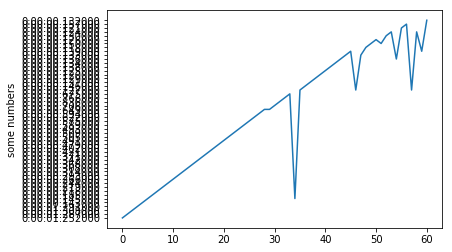

In [10]:
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
#     print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)
    
propogation_times = []
for i in range(1, len(blocks)):
#     print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))
    
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()

# 